## Selection with AstroNet



In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import pathlib
from fnmatch import fnmatch


from BRITE_Cookbook.BRITE import BRITE, plot_brite
from light_curve_util_new import *
from inject_transit_new import *

from astropy.constants import au, R_sun, R_earth, R_jup
from astropy.stats import SigmaClip

from wotan import flatten

from astropy import units as u
from astropy.constants import au, R_sun, R_jup


In [2]:
from tensorflow import keras
import seaborn as sns


## Open stellar radius data

In [3]:
stellar_data = pd.read_csv('stellar_radius.csv', sep = ';')
stellar_data

,Name,stellar radius
0,HD 017163,1.76896
1,HD 161912,77.97130
2,HD 022468,3.03985
3,HD 095880,69.67230
4,HD 017943,2.57020
...,...,...
531,HD 030652,2.50000
532,HD 074071,3.20000
533,HD 056456,3.51579
534,HD 071935,3.04036


## Load samples

In [4]:

filename = "data_labeled_full_old.csv"
folder = "GeneratedSamplesOld"

data_labeled = pd.read_csv(filename)

In [5]:
data_labeled

,target,satellite,label,index,filename,view,period,t0,star_radius,k,aos,i,e,w,ldcs_1,ldcs_2,n_points_transit
0,HD105211,UBr,PC,0,0_curve_HD105211_UBr.npy,Curve,2.446885,1494.195187,1.78292,0.092442,14.059912,1.558057,0.0,0.0,0.25,0.11,1367
1,HD105211,UBr,PC,0,0_fold_HD105211_UBr.npy,PhaseFold,2.446885,1494.195187,1.78292,0.092442,14.059912,1.558057,0.0,0.0,0.25,0.11,1367
2,HD105211,UBr,PC,0,0_global_HD105211_UBr.npy,Global,2.446885,1494.195187,1.78292,0.092442,14.059912,1.558057,0.0,0.0,0.25,0.11,1367
3,HD105211,UBr,PC,0,0_local_HD105211_UBr.npy,Local,2.446885,1494.195187,1.78292,0.092442,14.059912,1.558057,0.0,0.0,0.25,0.11,1367
4,HD105211,UBr,PC,1,1_curve_HD105211_UBr.npy,Curve,2.448274,1494.195187,1.78292,0.092442,14.059912,1.558057,0.0,0.0,0.25,0.11,1367
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
37795,HD88661,BHr,NOT_PC,11968,11968_global_HD88661_BHr.npy,Global,4.280559,3698.247201,2.59000,0.069377,13.655328,1.540499,0.0,0.0,NaN,NaN,1342
37796,HD88661,BHr,NOT_PC,11968,11968_local_HD88661_BHr.npy,Local,4.280559,3698.247201,2.59000,0.069377,13.655328,1.540499,0.0,0.0,NaN,NaN,1342
37797,HD88661,BHr,NOT_PC,11969,11969_fold_HD88661_BHr.npy,PhaseFold,4.870555,2913.873858,2.59000,0.052019,20.435022,1.538870,0.0,0.0,NaN,NaN,1342
37798,HD88661,BHr,NOT_PC,11969,11969_global_HD88661_BHr.npy,Global,4.870555,2913.873858,2.59000,0.052019,20.435022,1.538870,0.0,0.0,NaN,NaN,1342


Folder: GeneratedSamplesOld
0_local_HD105211_UBr.npy


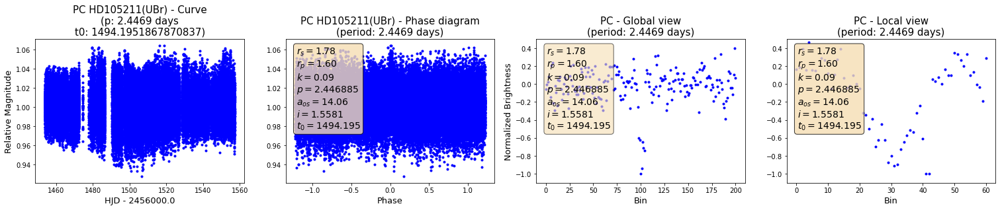

1_local_HD105211_UBr.npy


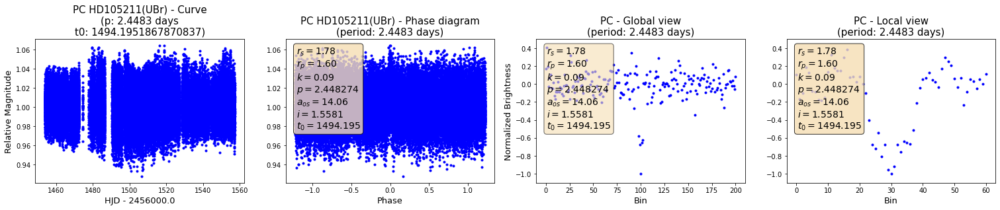

2_local_HD105211_UBr.npy


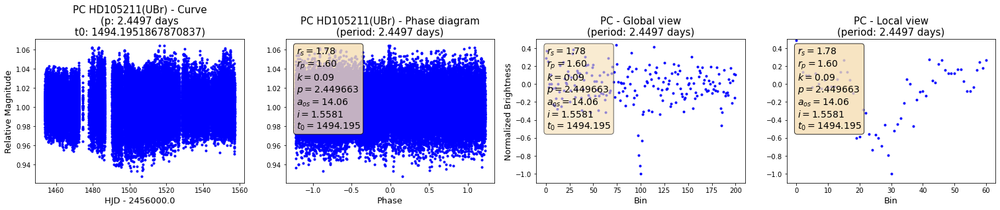

19_local_HD105211_UBr.npy


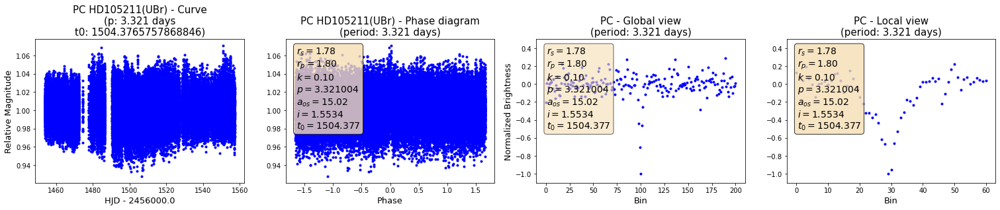

20_local_HD105211_UBr.npy


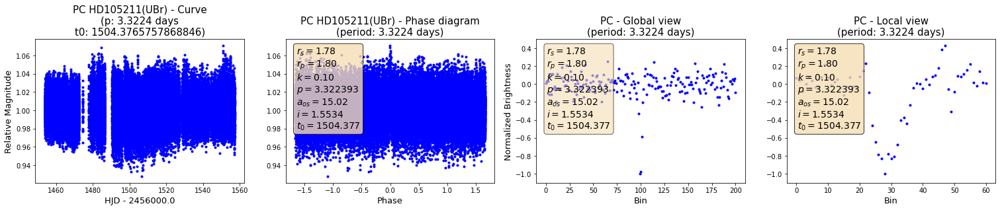

21_local_HD105211_UBr.npy


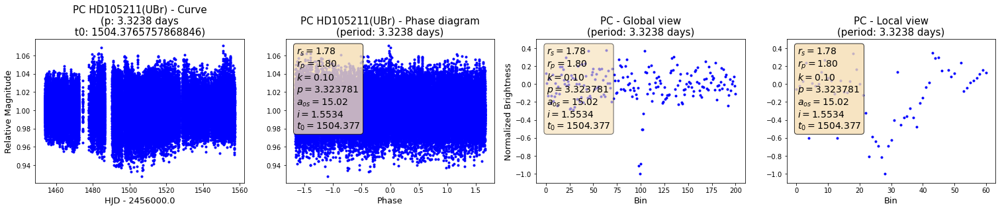

38_local_HD105211_UBr.npy


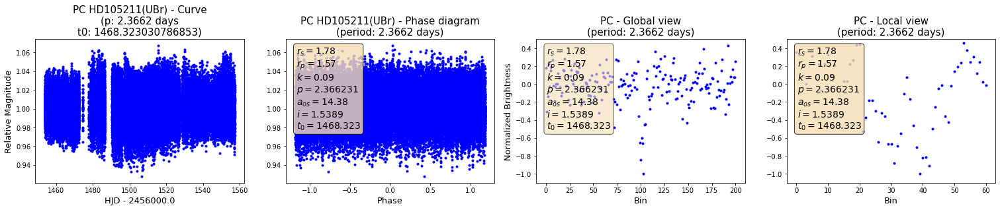

39_local_HD105211_UBr.npy


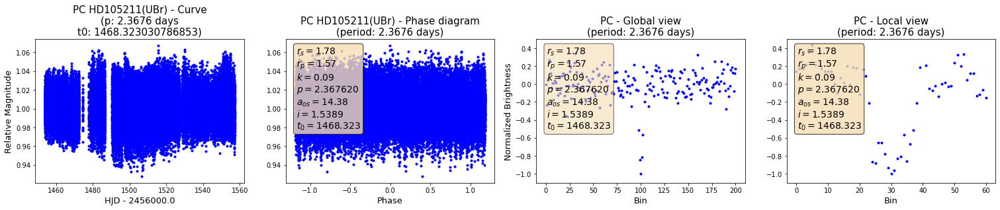

40_local_HD105211_UBr.npy


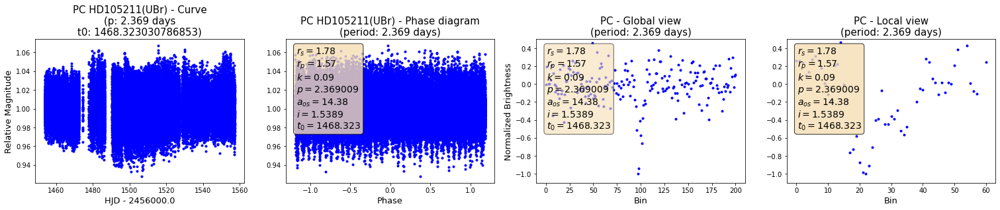

57_local_HD105211_UBr.npy


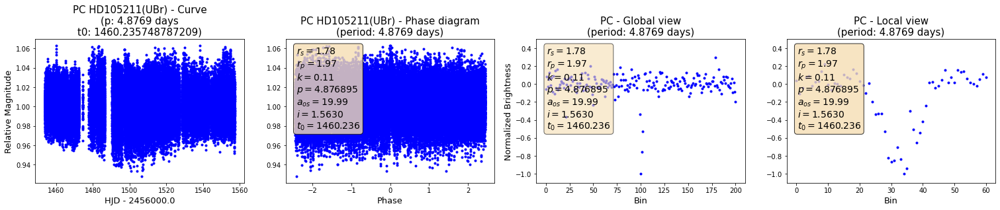

58_local_HD105211_UBr.npy


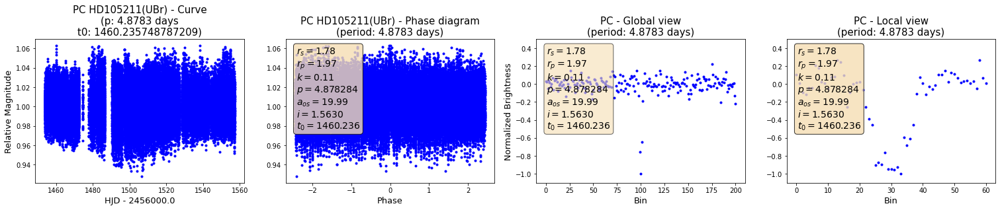

59_local_HD105211_UBr.npy


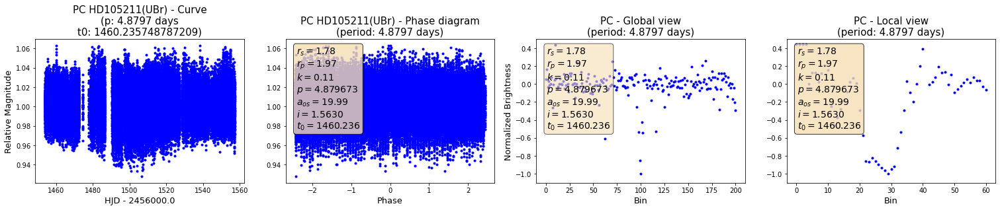

76_local_HD105211_UBr.npy


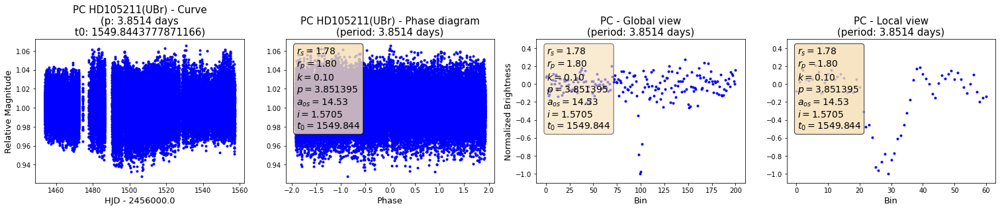

77_local_HD105211_UBr.npy


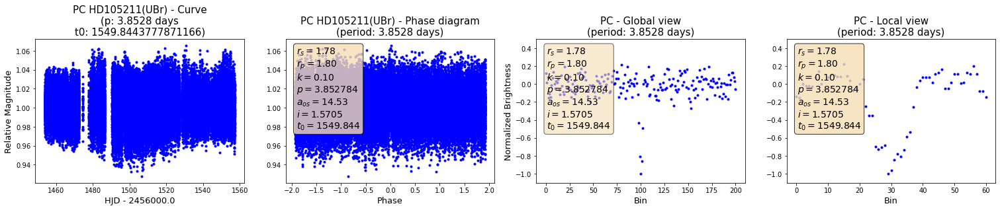

78_local_HD105211_UBr.npy


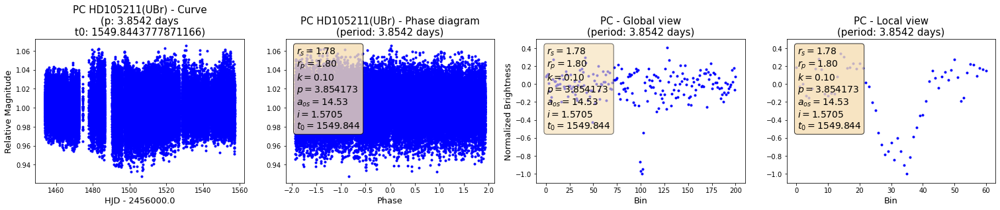

95_local_HD105211_UBr.npy


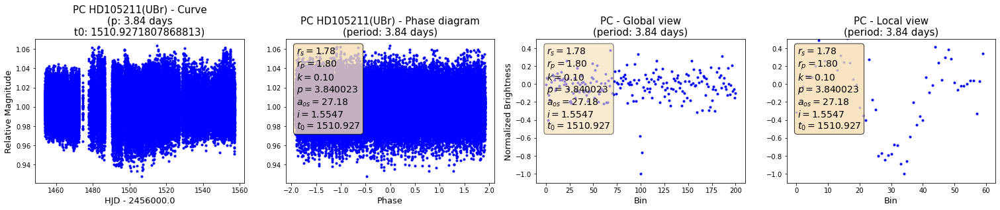

96_local_HD105211_UBr.npy


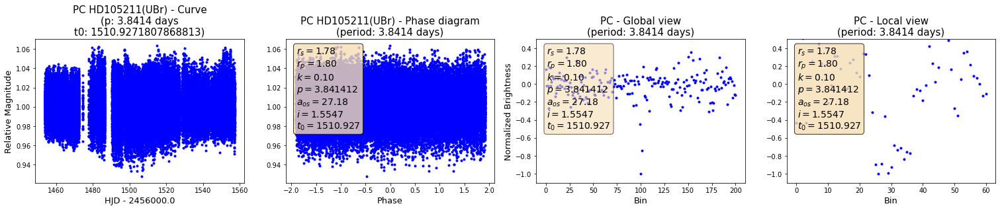

97_local_HD105211_UBr.npy


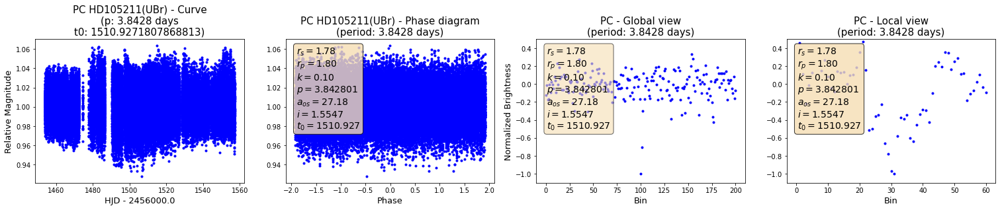

114_local_HD105435_UBr.npy


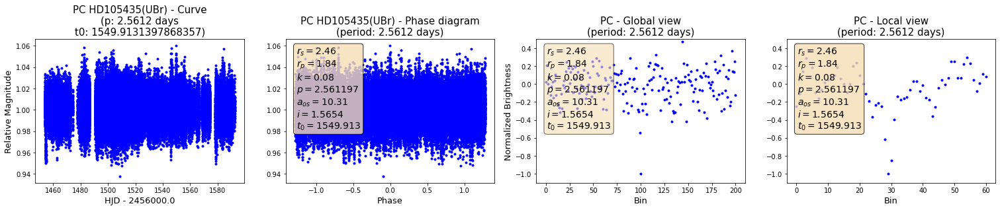

115_local_HD105435_UBr.npy


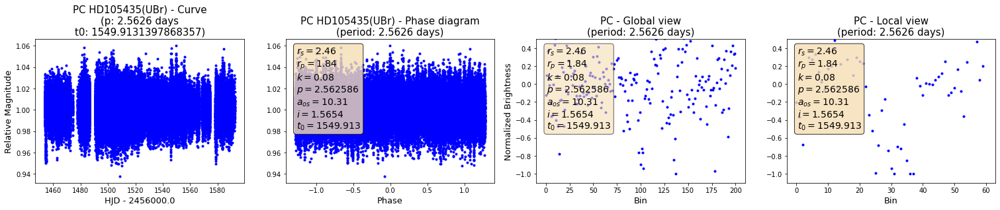

116_local_HD105435_UBr.npy


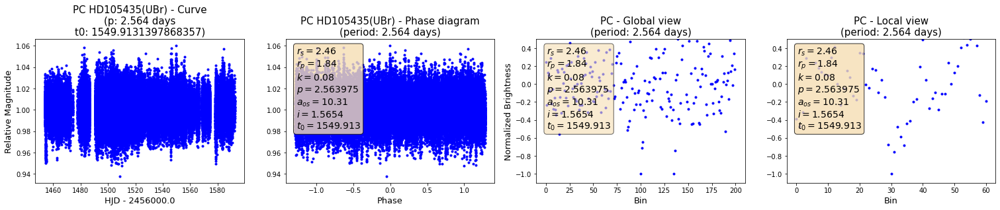

133_local_HD105435_UBr.npy


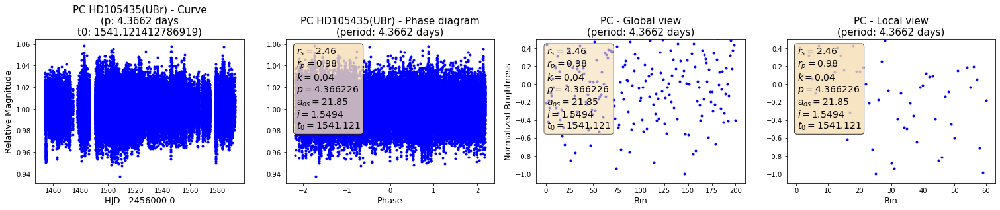

134_local_HD105435_UBr.npy


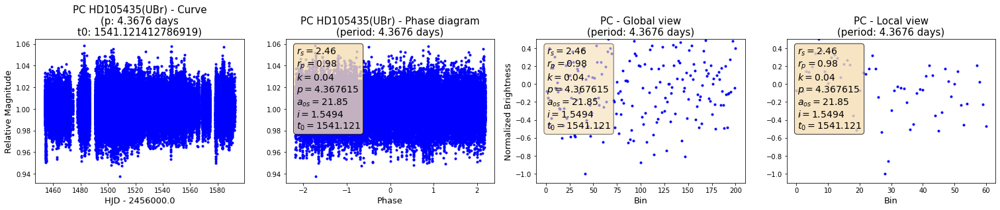

135_local_HD105435_UBr.npy


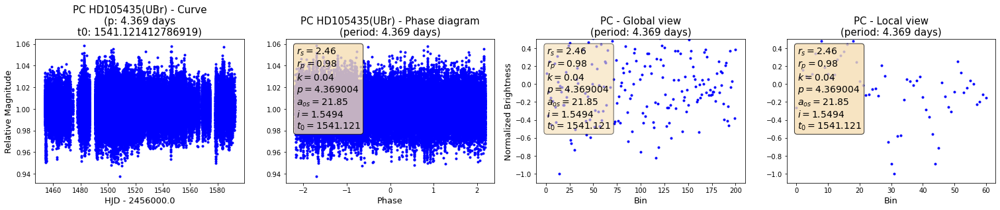

152_local_HD105435_UBr.npy


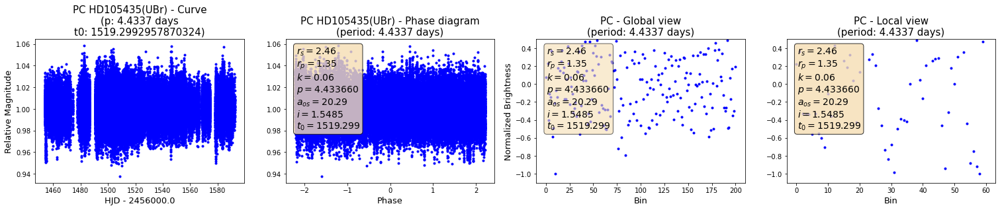

153_local_HD105435_UBr.npy


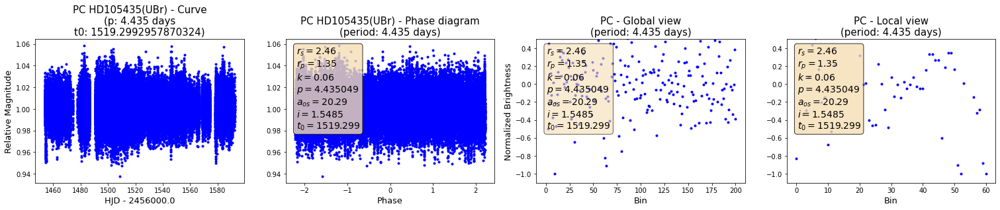

154_local_HD105435_UBr.npy


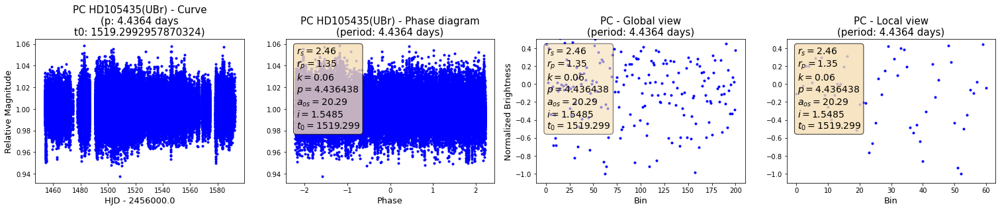

171_local_HD105435_UBr.npy


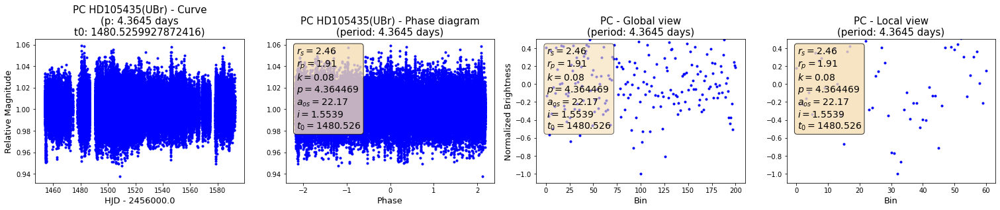

172_local_HD105435_UBr.npy


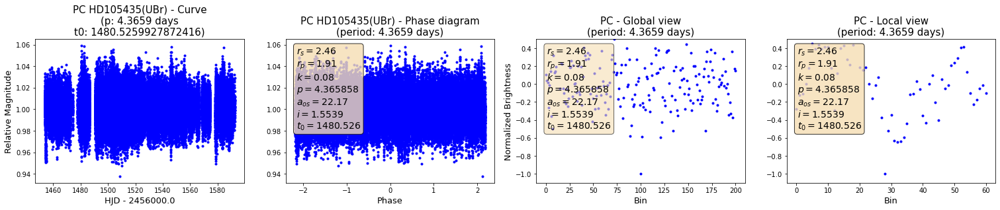

173_local_HD105435_UBr.npy


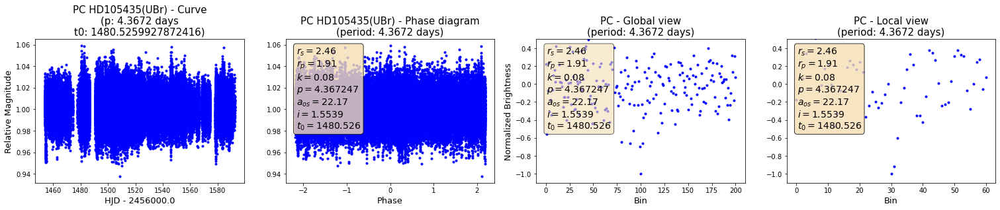

190_local_HD105435_UBr.npy


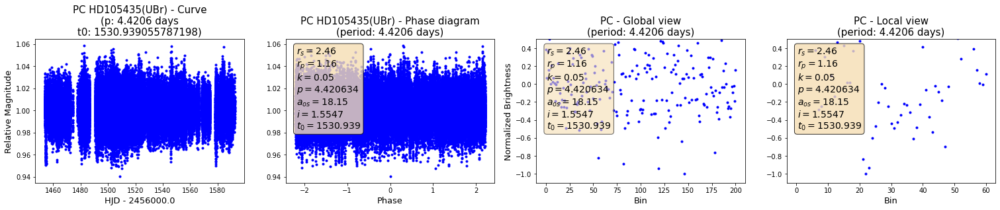

191_local_HD105435_UBr.npy


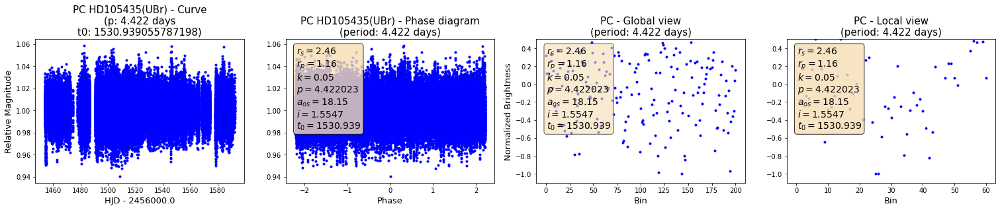

192_local_HD105435_UBr.npy


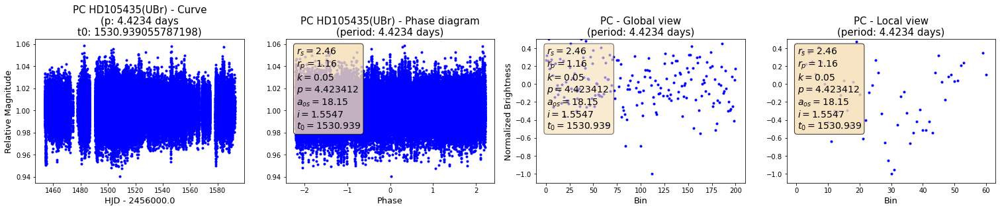

209_local_HD105435_UBr.npy


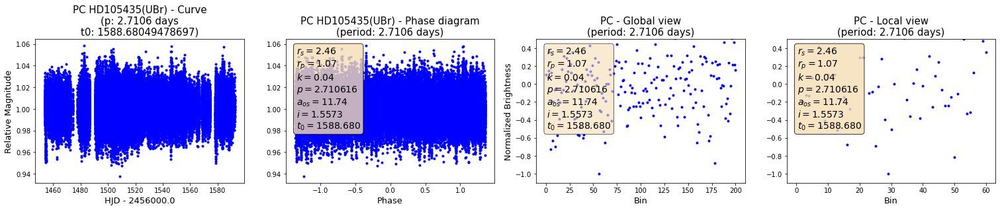

210_local_HD105435_UBr.npy


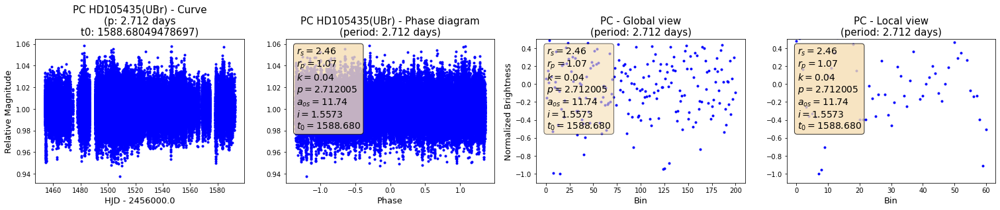

211_local_HD105435_UBr.npy


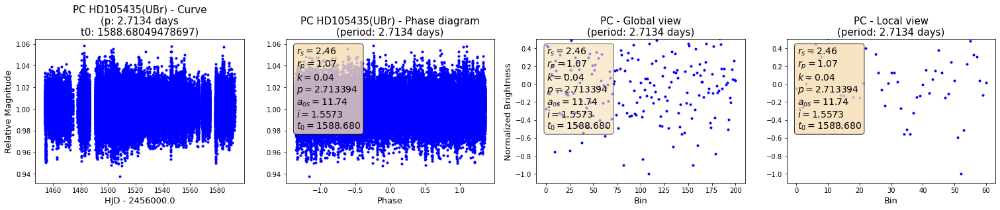

228_local_HD106983_BLb.npy


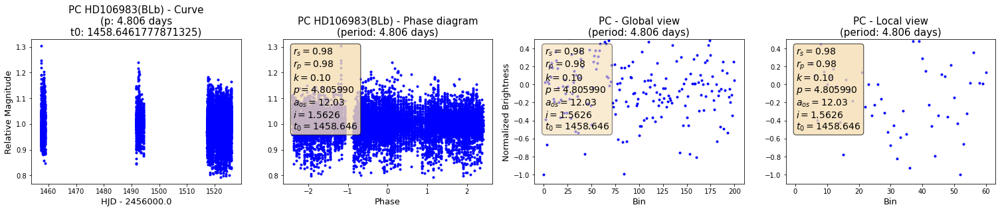

229_local_HD106983_BLb.npy


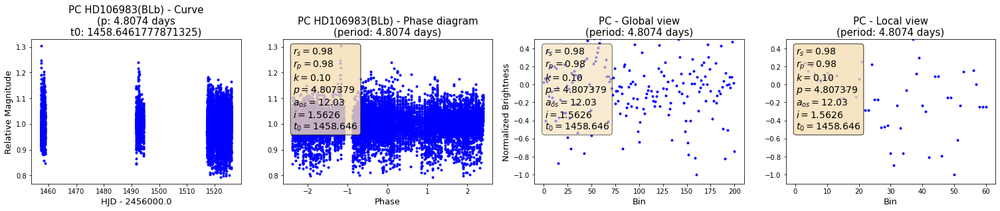

230_local_HD106983_BLb.npy


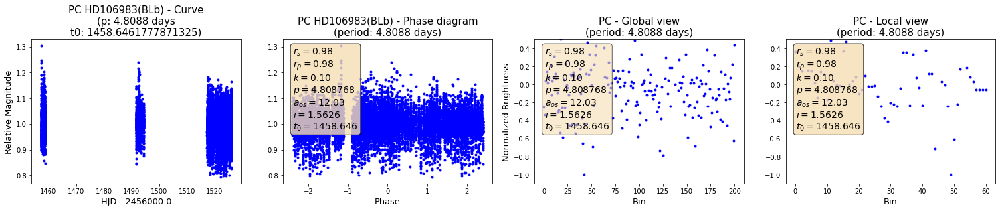

247_local_HD106983_UBr.npy


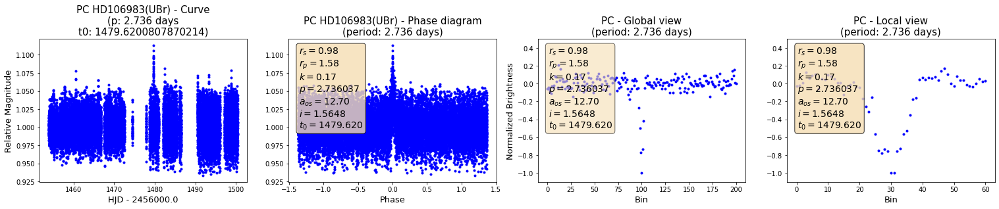

248_local_HD106983_UBr.npy


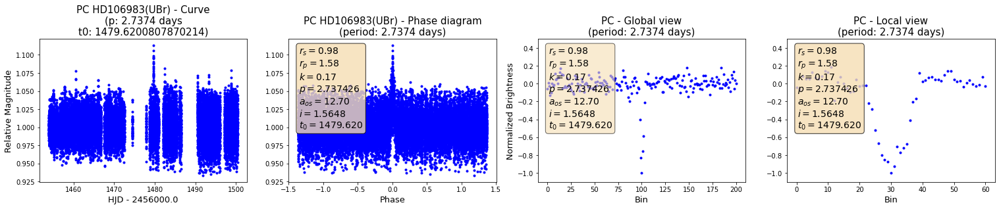

249_local_HD106983_UBr.npy


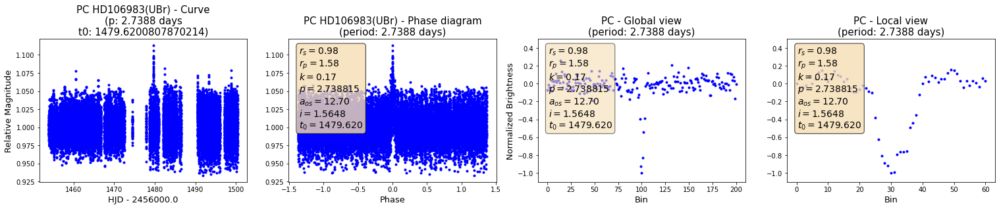

266_local_HD106983_UBr.npy


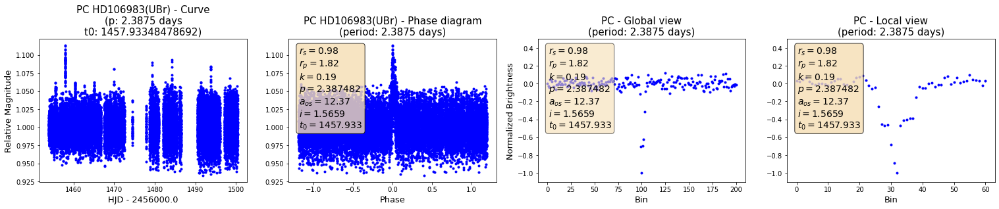

267_local_HD106983_UBr.npy


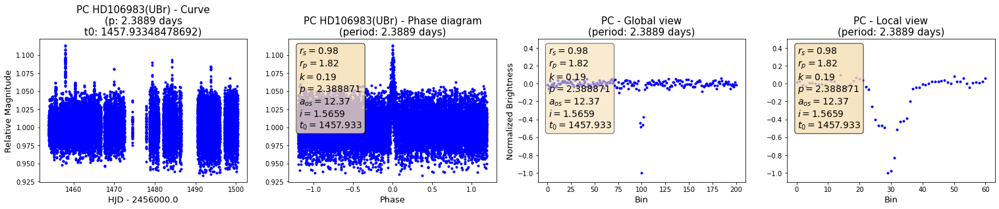

268_local_HD106983_UBr.npy


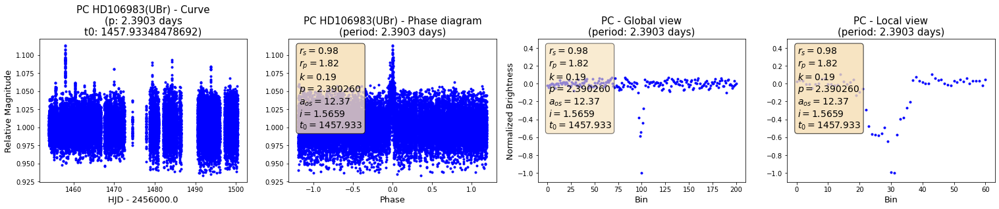

285_local_HD106983_UBr.npy


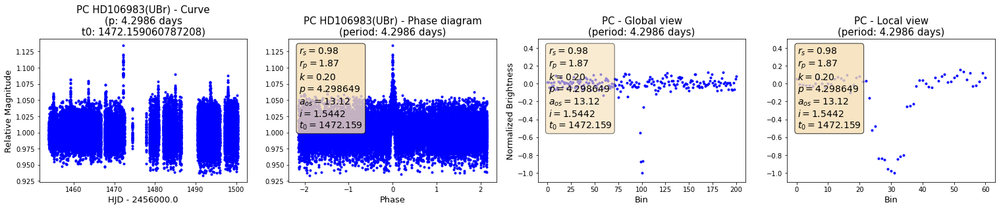

286_local_HD106983_UBr.npy


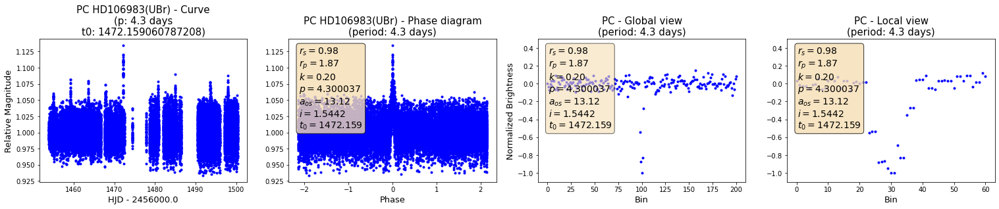

287_local_HD106983_UBr.npy


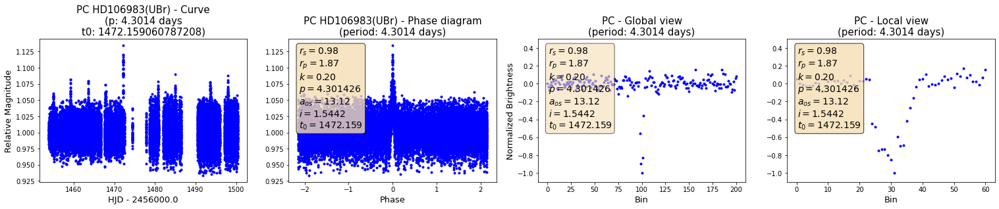

304_local_HD106983_UBr.npy


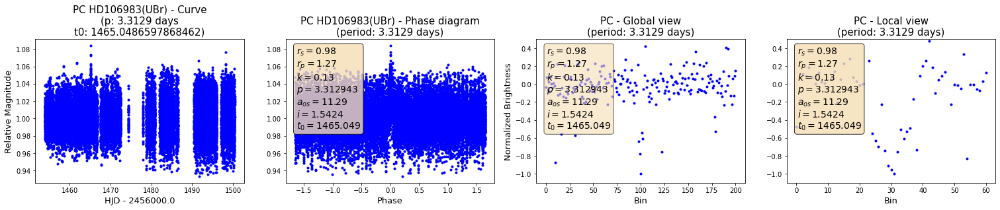

305_local_HD106983_UBr.npy


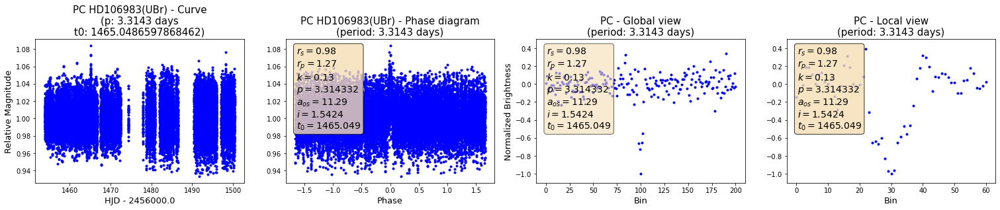

306_local_HD106983_UBr.npy


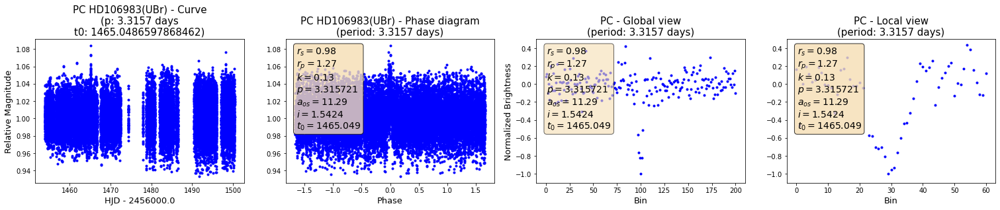

323_local_HD106983_UBr.npy


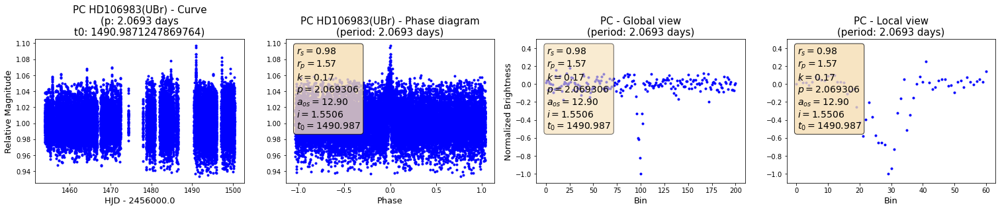

324_local_HD106983_UBr.npy


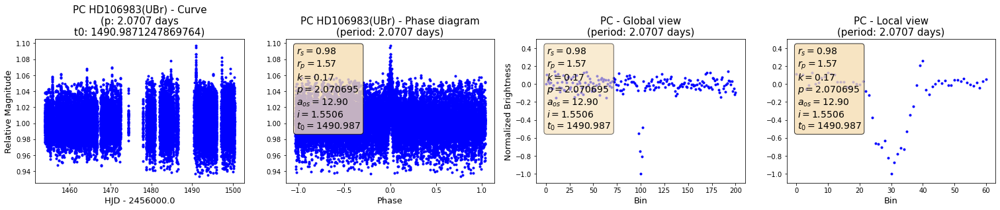

325_local_HD106983_UBr.npy


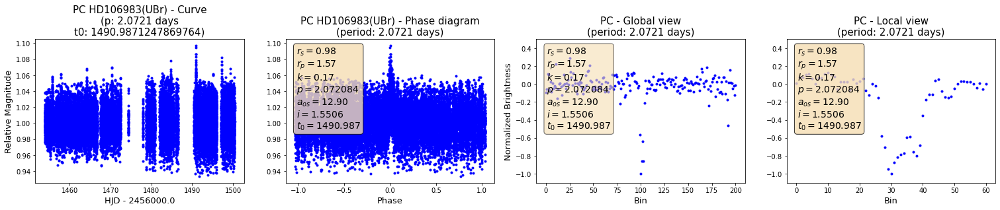

342_local_HD106983_UBr.npy


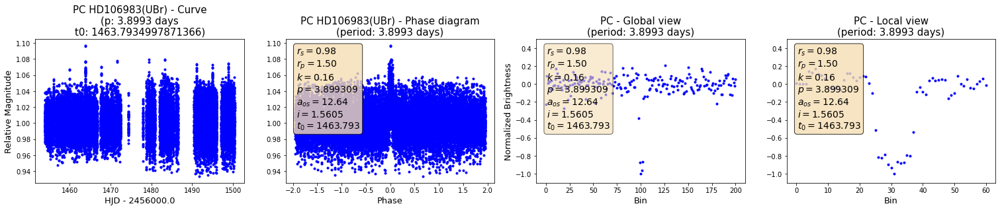

343_local_HD106983_UBr.npy


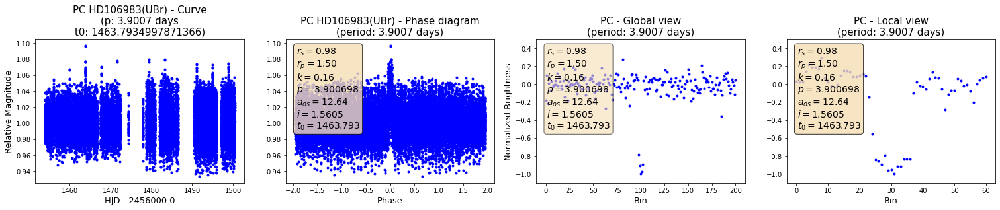

344_local_HD106983_UBr.npy


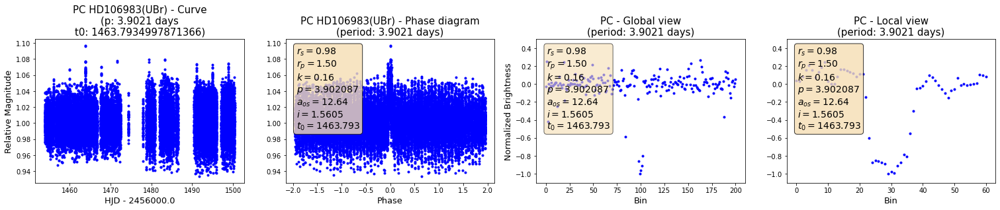

361_local_HD110879_BAb.npy


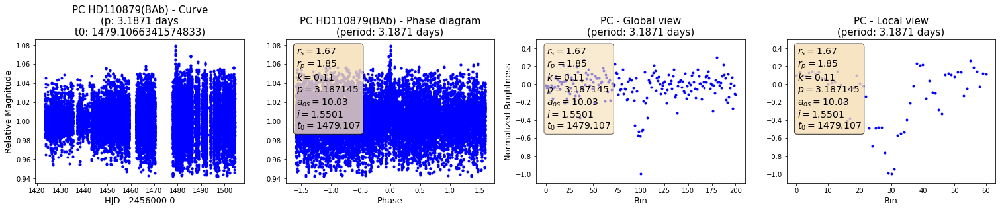

362_local_HD110879_BAb.npy


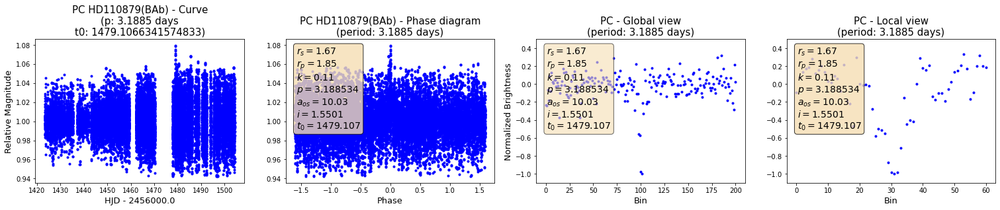

363_local_HD110879_BAb.npy


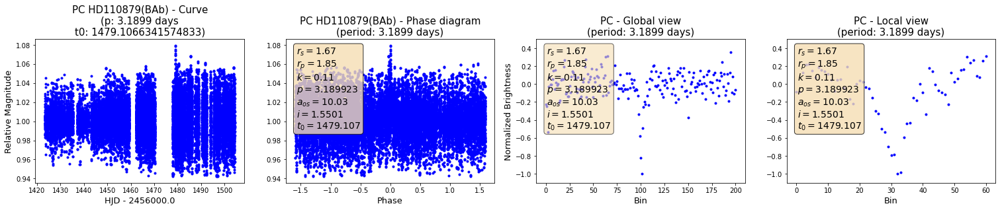

380_local_HD110879_BAb.npy


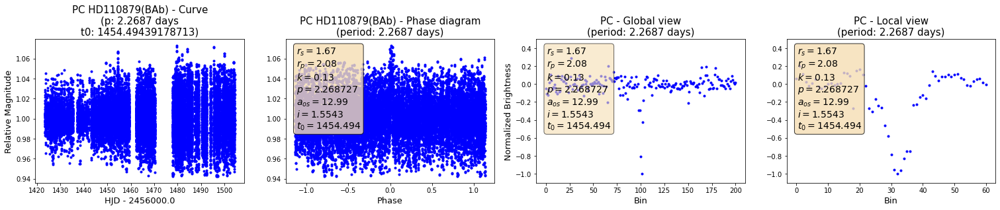

381_local_HD110879_BAb.npy


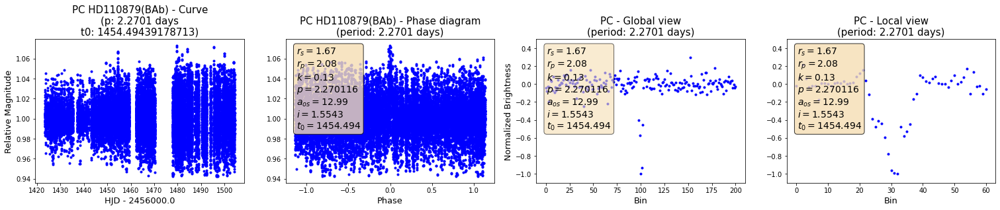

382_local_HD110879_BAb.npy


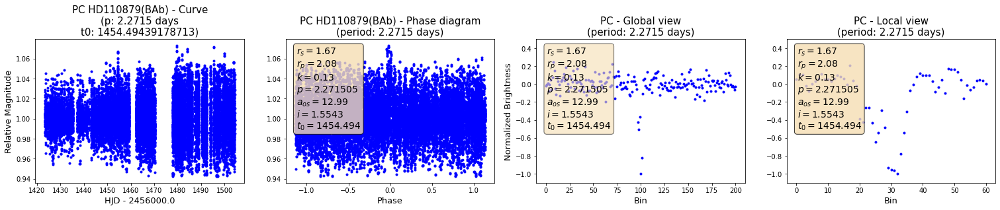

399_local_HD110879_BAb.npy


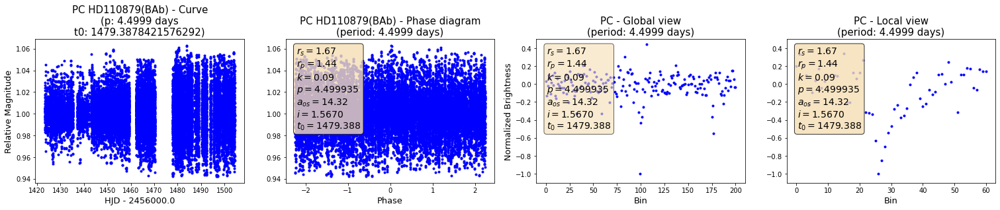

400_local_HD110879_BAb.npy


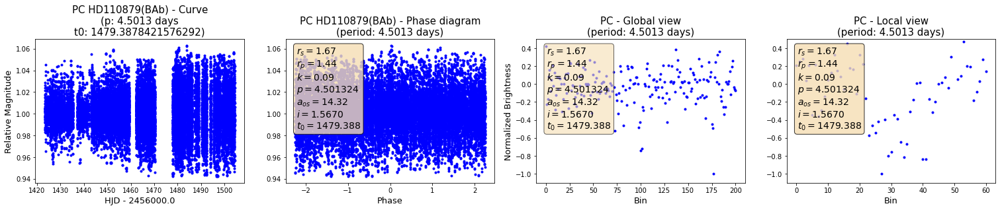

401_local_HD110879_BAb.npy


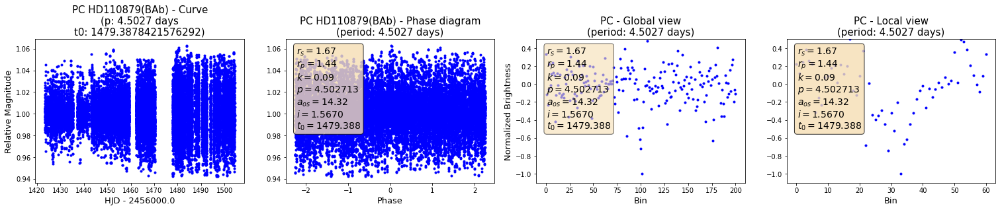

418_local_HD110879_BAb.npy


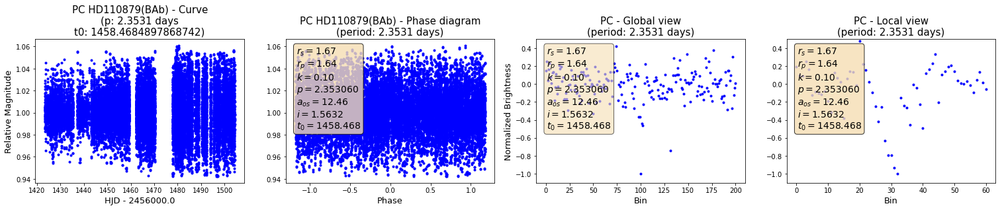

419_local_HD110879_BAb.npy


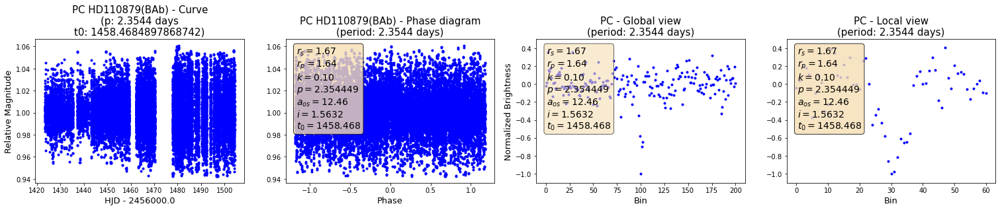

420_local_HD110879_BAb.npy


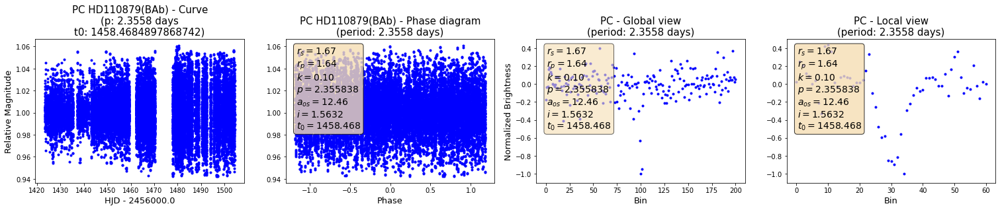

437_local_HD110879_BAb.npy


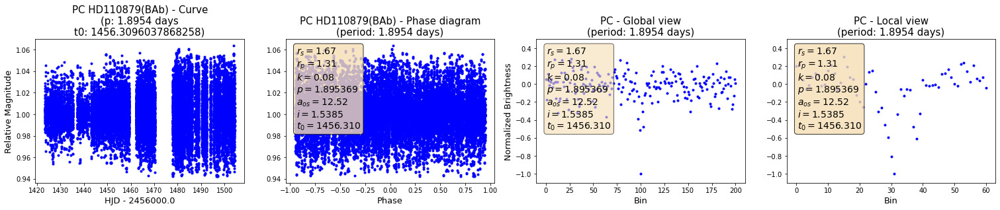

438_local_HD110879_BAb.npy


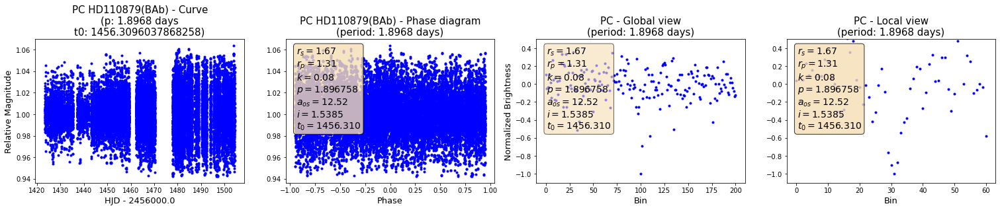

439_local_HD110879_BAb.npy


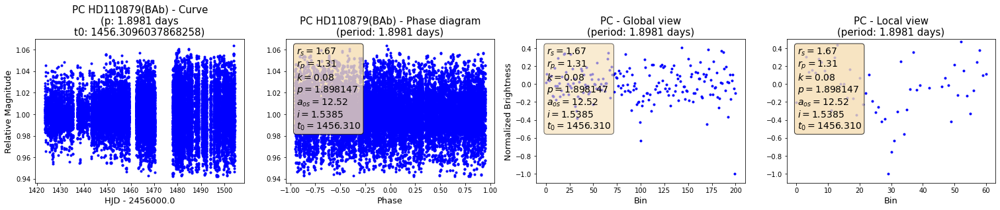

456_local_HD110879_BAb.npy


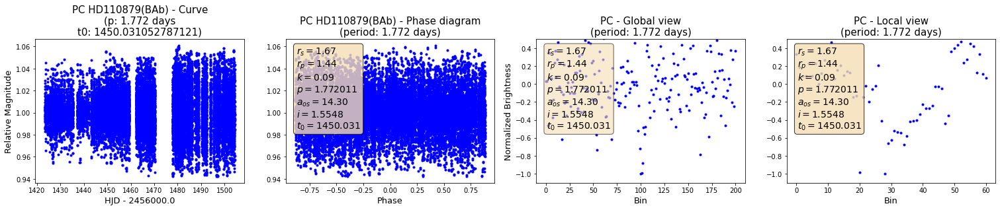

457_local_HD110879_BAb.npy


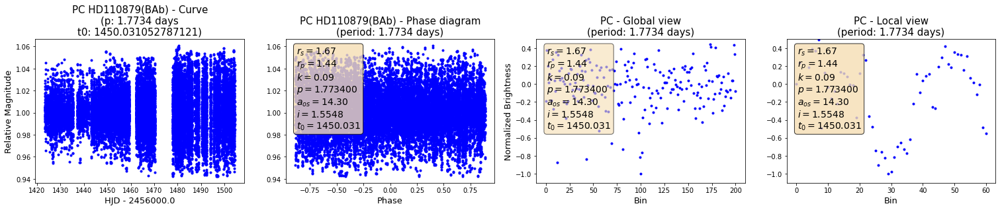

458_local_HD110879_BAb.npy


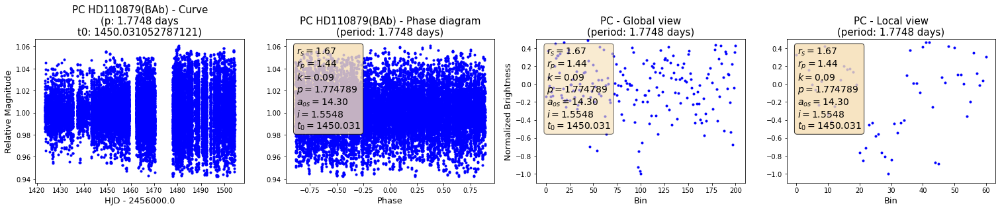

475_local_HD110879_BHr.npy


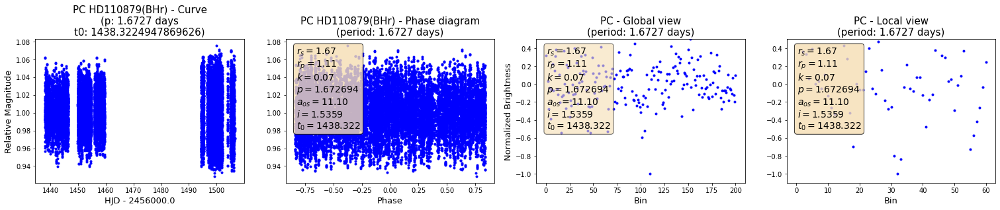

476_local_HD110879_BHr.npy


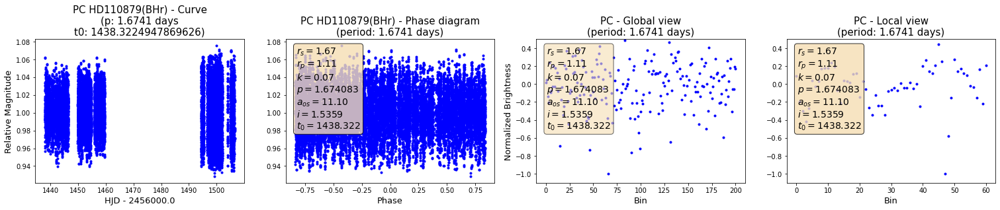

477_local_HD110879_BHr.npy


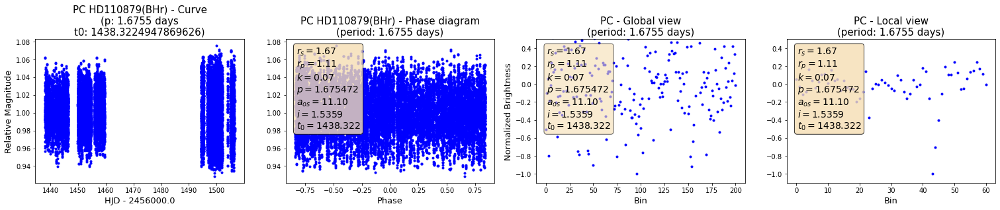

494_local_HD110879_BHr.npy


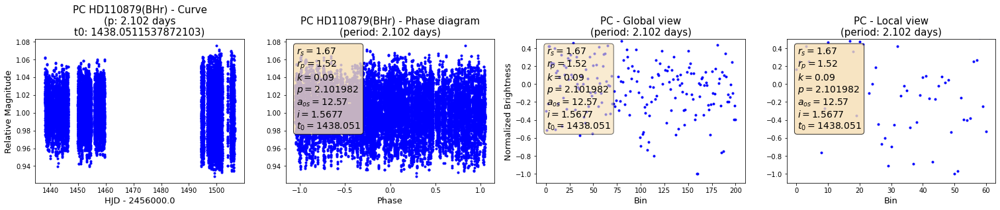

495_local_HD110879_BHr.npy


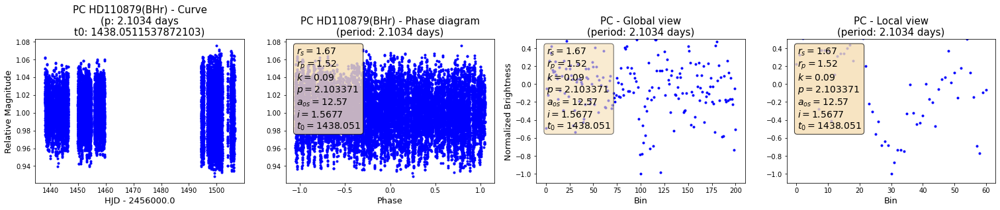

496_local_HD110879_BHr.npy


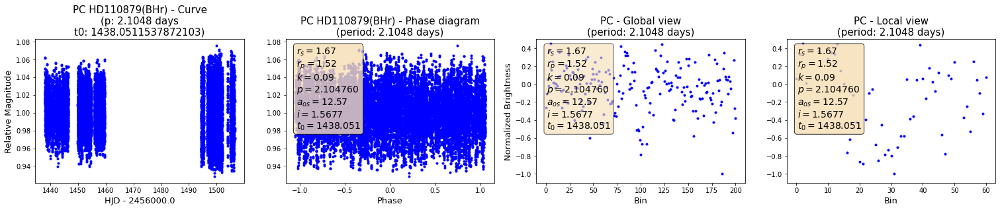

513_local_HD110879_BHr.npy


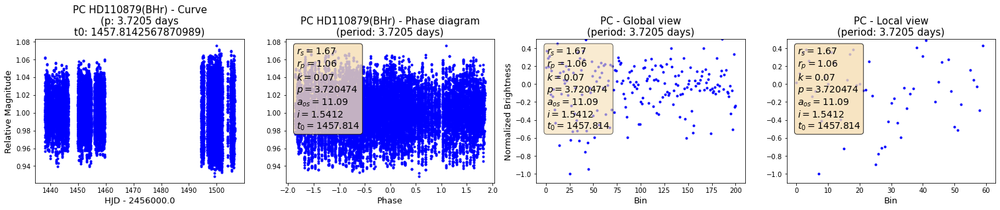

514_local_HD110879_BHr.npy


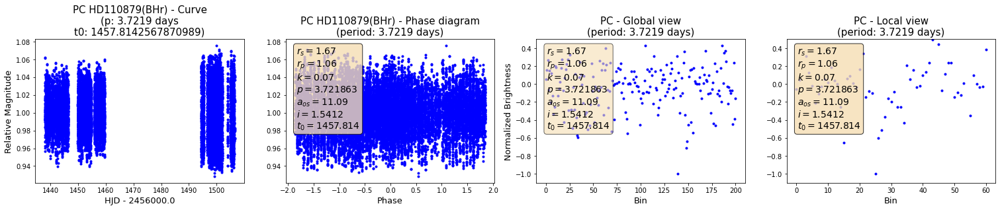

515_local_HD110879_BHr.npy


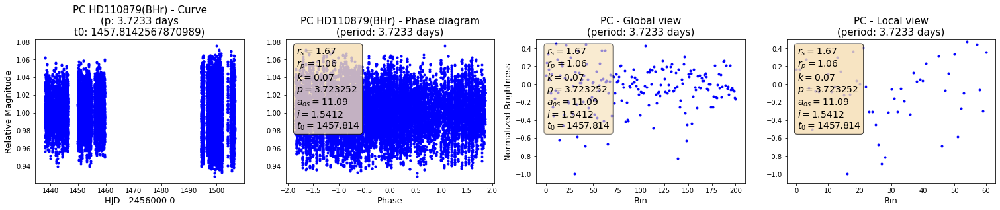

532_local_HD110879_BHr.npy


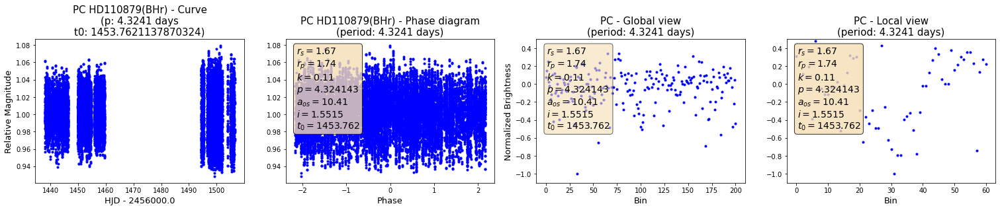

533_local_HD110879_BHr.npy


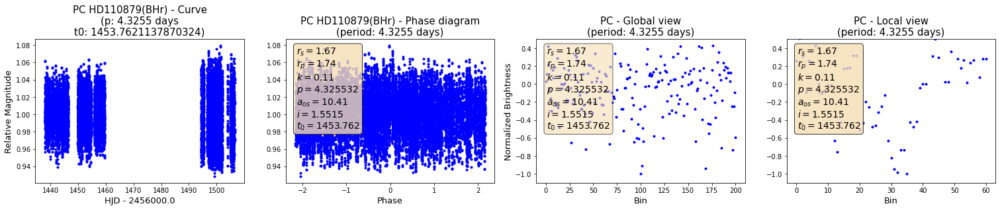

534_local_HD110879_BHr.npy


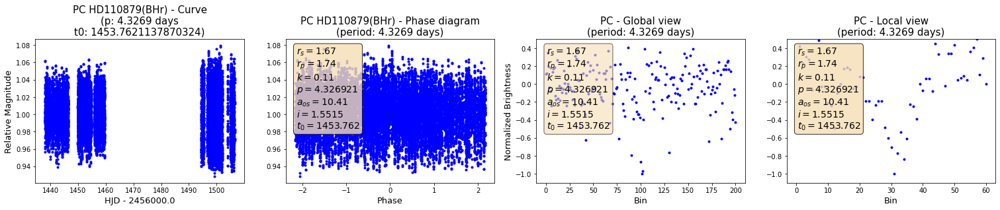

551_local_HD110879_BHr.npy


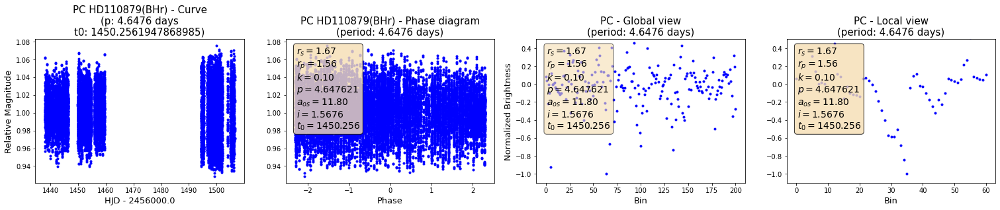

552_local_HD110879_BHr.npy


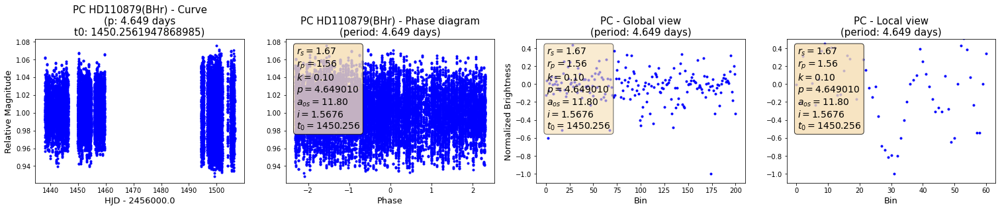

553_local_HD110879_BHr.npy


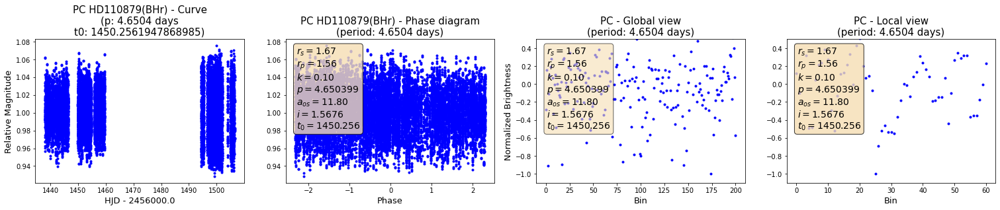

570_local_HD110879_BHr.npy


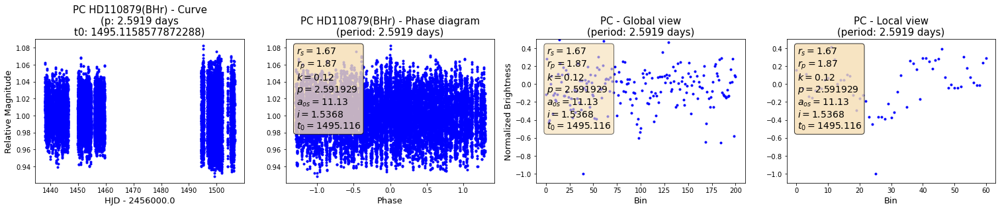

571_local_HD110879_BHr.npy


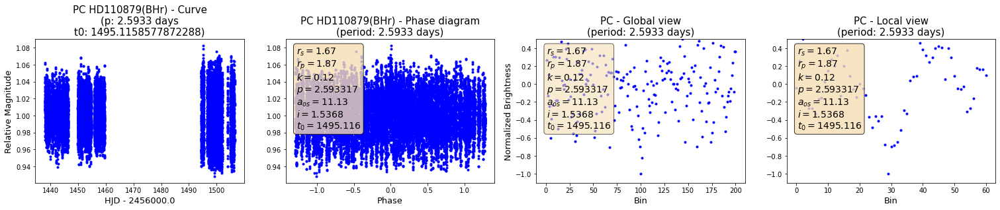

572_local_HD110879_BHr.npy


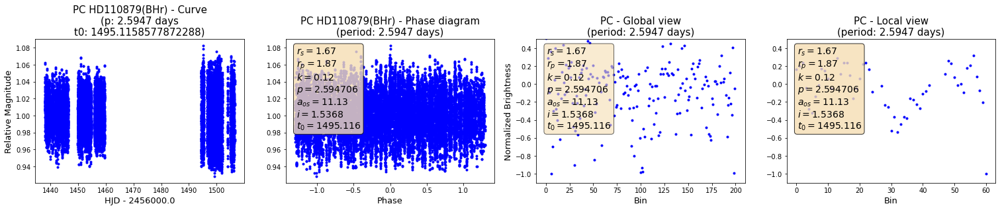

589_local_HD110879_BLb.npy


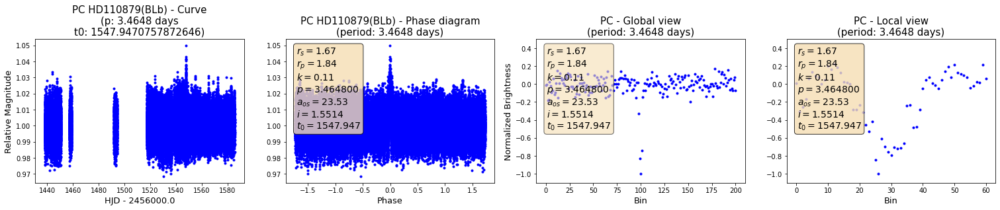

590_local_HD110879_BLb.npy


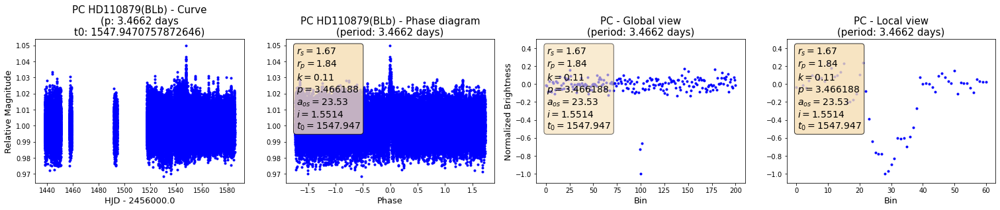

591_local_HD110879_BLb.npy


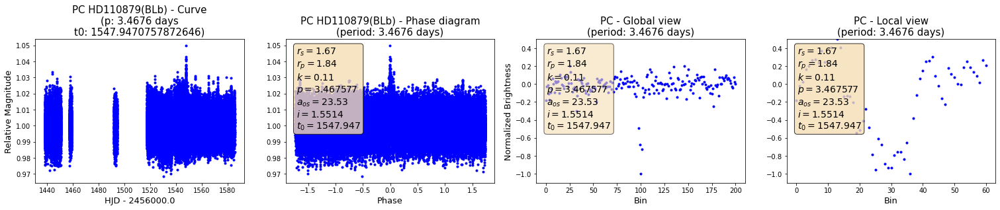

608_local_HD110879_BLb.npy


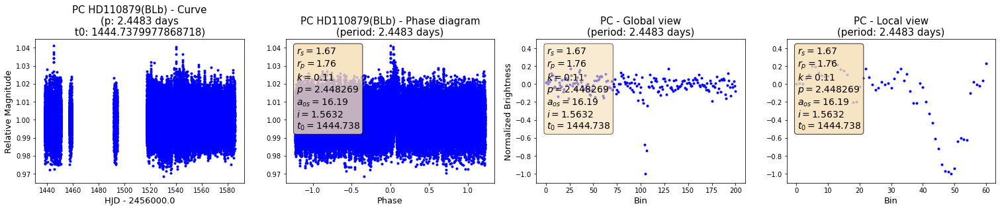

609_local_HD110879_BLb.npy


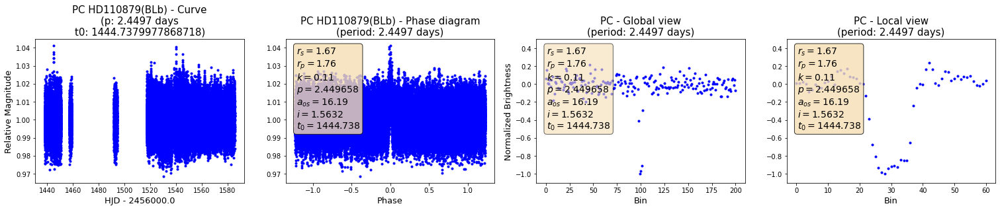

610_local_HD110879_BLb.npy


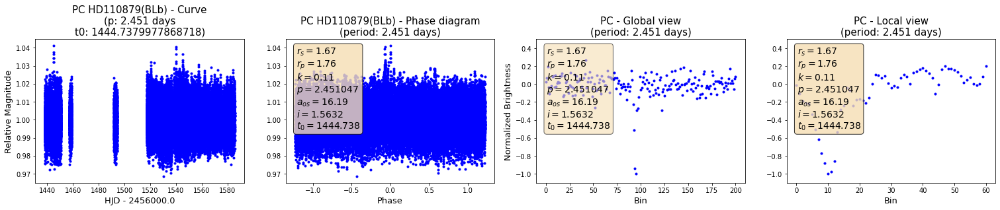

627_local_HD110879_BLb.npy


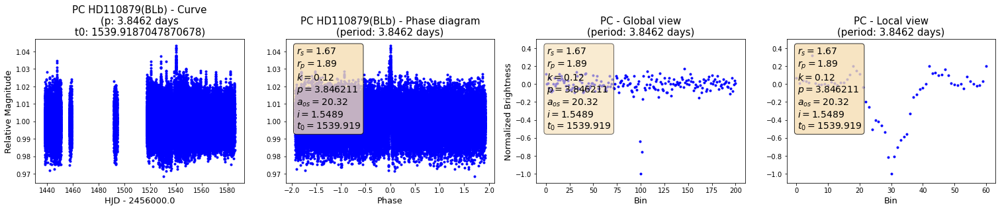

In [6]:
print(f"Folder: {folder}")

query = data_labeled[ data_labeled["label"] == "PC" ]

n_show = 100
#n_show = count_transit

for i, index in enumerate(np.unique( query["index"].values )):
    if (i >= n_show):
        break
    query_index = query[query["index"] == index]
    
    
    filename = query_index[query_index["view"] == "Curve"]["filename"].values[0]
    data_curve = np.load(f"{folder}/{filename}")
    
    filename = query_index[query_index["view"] == "PhaseFold"]["filename"].values[0]
    data_fold = np.load(f"{folder}/{filename}")
    
    filename = query_index[query_index["view"] == "Global"]["filename"].values[0]
    data_global = np.load(f"{folder}/{filename}")
    
    filename = query_index[query_index["view"] == "Local"]["filename"].values[0]
    data_local = np.load(f"{folder}/{filename}")
    print(filename)
    
    p = query_index["period"].iloc[0]
    t0 = query_index["t0"].iloc[0]
    
    target_name = query_index["target"].values[0]
    satellite_name = query_index["satellite"].values[0]
    
    fig = plt.figure(figsize=(26, 4))    
    
    # star_radius k
    textstr = '\n'.join((
        r'$r_{s}=%.2f$' % (query_index["star_radius"].values[0], ),
        r'$r_{p}=%.2f$' % (query_index["k"].values[0] * query_index["star_radius"].values[0] * R_sun /R_jup , ),
        r'$k=%.2f$' % (query_index["k"].values[0], ),
        r'$p=%.6f$' % (query_index["period"].values[0], ),
        r'$a_{os}=%.2f$' % (query_index["aos"].values[0], ),
        r'$i=%.4f$' % (query_index["i"].values[0], ),
        r'$t_{0}=%.3f$' % (query_index["t0"].values[0], )
    ))
    
    ax = fig.add_subplot(1, 4, 1)
    plt.title(f"PC {target_name}({satellite_name}) - Curve\n(p: {np.round(p, 4)} days\nt0: {t0})", fontsize = 15)
    plt.ylabel("Relative Magnitude", fontsize = 13)
    plt.xlabel("HJD - 2456000.0", fontsize = 13)
    plt.plot(data_curve[0, :], data_curve[1,:], 'b.')
    
    ax = fig.add_subplot(1, 4, 2)
    plt.title(f"PC {target_name}({satellite_name}) - Phase diagram\n(period: {np.round(p, 4)} days)", fontsize = 15)
    plt.xlabel("Phase", fontsize = 13)
    plt.plot(data_fold[0, :], data_fold[1,:], 'b.')
    # these are matplotlib.patch.Patch properties
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.8)

    # place a text box in upper left in axes coords
    ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
            verticalalignment='top', bbox=props)
    
    ax = fig.add_subplot(1, 4, 3)
    plt.title(f"PC - Global view\n(period: {np.round(p, 4)} days)", fontsize = 15)
    plt.xlabel("Bin", fontsize = 13)
    plt.ylabel("Normalized Brightness", fontsize = 13)
    plt.ylim(-1.1, 0.5)
    plt.plot(data_global[0, :], data_global[1,:], 'b.')
    # these are matplotlib.patch.Patch properties
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.6)

    # place a text box in upper left in axes coords
    ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
            verticalalignment='top', bbox=props)
    
    ax = fig.add_subplot(1, 4, 4)
    plt.title(f"PC - Local view\n(period: {np.round(p, 4)} days)", fontsize = 15)
    plt.xlabel("Bin", fontsize = 13)
    plt.ylim(-1.1, 0.5)
    plt.plot(data_local[0, :], data_local[1,:], 'b.')
    # these are matplotlib.patch.Patch properties
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.8)

    # place a text box in upper left in axes coords
    ax.text(0.05, 0.95, textstr, transform=ax.transAxes, fontsize=14,
            verticalalignment='top', bbox=props)
    
    plt.show()
    

## Load model 

In [7]:
model_astronet = keras.models.load_model('keras_model_astronet.h5')

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input_global (InputLayer)      [(None, 201, 1)]     0           []                               
                                                                                                  
 conv1d_14 (Conv1D)             (None, 201, 16)      96          ['Input_global[0][0]']           
                                                                                                  
 conv1d_15 (Conv1D)             (None, 201, 16)      1296        ['conv1d_14[0][0]']              
                                                                                                  
 max_pooling1d_7 (MaxPooling1D)  (None, 99, 16)      0           ['conv1d_15[0][0]']              
                                                                                            

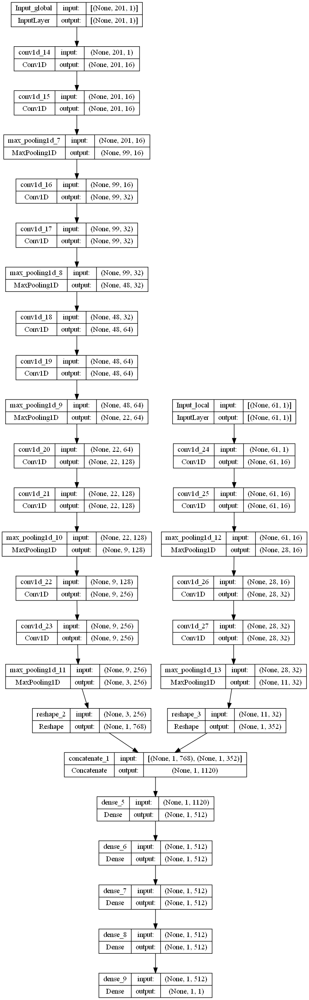

In [8]:
model_astronet.summary()

keras.utils.plot_model(model_astronet, show_shapes=True)

In [9]:
def get_example(index, folder, only_info = False):
    
    query_index = data_labeled[data_labeled["index"] == index]
    local_filename = query_index[query_index["view"] == "Local"]["filename"].values[0]
    global_filename = query_index[query_index["view"] == "Global"]["filename"].values[0]
    
    
    info = {
        'target': data_labeled[data_labeled["index"] == index]['target'].values[0],
        'satellite': data_labeled[data_labeled["index"] == index]['satellite'].values[0],
        'label': data_labeled[data_labeled["index"] == index]['label'].values[0],
        'r_s': query_index["star_radius"].values[0],
        'r_p': query_index["k"].values[0] * query_index["star_radius"].values[0] * R_sun /R_jup ,
        'k': query_index["k"].values[0],
        'p': query_index["period"].values[0],
        'a_os': query_index["aos"].values[0],
        'i': query_index["i"].values[0],
        't_0': query_index["t0"].values[0]
    }
    
    if (only_info):
        return info
    else:
        data_global = np.load(f"{folder}/{global_filename}")
        data_local = np.load(f"{folder}/{local_filename}")

        return data_local, data_global, info

In [10]:
def plot_views(index, folder, title_local = '', title_global = ''):
    
    data_local, data_global, info = get_example(index, folder)
    print(info)
    
    textstr = '\n'.join((
        r'$r_{s}=%.2f$' % (info['r_s'], ),
        r'$r_{p}=%.2f$' % (info['r_p'], ),
        r'$k=%.2f$' % (info['k'], ),
        r'$p=%.6f$' % (info['p'], ),
        r'$a_{os}=%.2f$' % (info['a_os'], ),
        r'$i=%.4f$' % (info['i'], ),
        r'$t_{0}=%.3f$' % (info['t_0'], )
    ))
    
    title_local += f"{info['target']}({info['satellite']}). {info['label']}"
    title_global += f"{info['target']}({info['satellite']}). {info['label']}"

    fig = plt.figure(figsize=(12, 4)) 
    ax = fig.add_subplot(1, 2, 1)
    plt.title(title_local, fontsize = 15)
    plt.xlabel("Bin", fontsize = 13)
    plt.ylabel("Normalized Brightness", fontsize = 13)
    plt.ylim(-1.1, 0.5)
    plt.plot(data_local[0, :], data_local[1,:], 'b.')
    
    props = dict(boxstyle='round', facecolor='wheat', alpha=0.8)

    # place a text box in upper left in axes coords
    ax.text(0.02, 0.5, textstr, transform=ax.transAxes, fontsize=11,
            verticalalignment='top', bbox=props)

    ax = fig.add_subplot(1, 2, 2)
    plt.title(title_global, fontsize = 15)
    plt.xlabel("Bin", fontsize = 13)
    plt.ylabel("Normalized Brightness", fontsize = 13)
    plt.ylim(-1.1, 0.5)
    plt.plot(data_global[0, :], data_global[1,:], 'b.')

    print(data_global[1,:].shape)
    print(data_global[1,:].reshape(1,-1).shape)

    print(data_local[1,:].shape)
    plt.show()

{'target': 'HD110879', 'satellite': 'BHr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.05773563>, 'k': 0.0650872774878172, 'p': 3.7232522316647, 'a_os': 11.09454733579614, 'i': 1.5412362152683698, 't_0': 1457.8142567870989}
(201,)
(1, 201)
(61,)


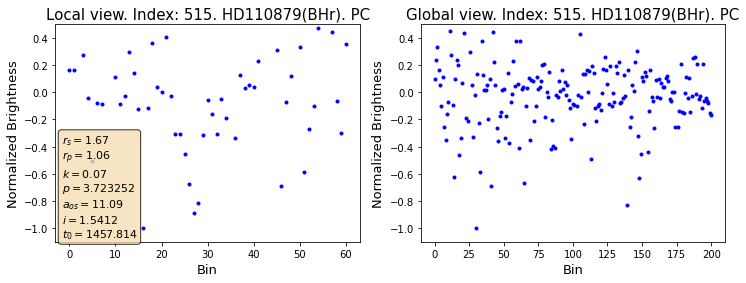

1/1 [==============================] - 0s 346ms/step


0.37423643

In [11]:
index = 515

plot_views(index, folder, f'Local view. Index: {index}. ', f'Global view. Index: {index}. ')


model_astronet.predict( [data_global[1,:].reshape(1,-1), data_local[1,:].reshape(1,-1)] )[0][0][0]


### Calculate predictions on Not_PC examples

In [12]:
predictions_NOT_PC = []
indexs_NOT_PC = []

for index in np.unique(data_labeled[data_labeled["label"] == "NOT_PC"]["index"]):
    #print(index)
    data_local, data_global, _ = get_example(index, folder)
    
    prediction = model_astronet.predict( [data_global[1,:].reshape(1,-1), data_local[1,:].reshape(1,-1)] )[0][0][0]
    print(index, prediction)
    
    indexs_NOT_PC.append(index)
    predictions_NOT_PC.append(prediction)

1/1 [==============================] - 0s 17ms/step
3 0.0005768179
1/1 [==============================] - 0s 14ms/step
4 0.00080674107
1/1 [==============================] - 0s 20ms/step
5 0.00019152241
1/1 [==============================] - 0s 18ms/step
6 0.0006741455
1/1 [==============================] - 0s 13ms/step
7 0.0002553458
1/1 [==============================] - 0s 20ms/step
8 0.0011719348
1/1 [==============================] - 0s 18ms/step
9 0.0006384322
1/1 [==============================] - 0s 17ms/step
10 4.5258257e-06
1/1 [==============================] - 0s 14ms/step
11 0.0001713791
1/1 [==============================] - 0s 15ms/step
12 0.0006418044
1/1 [==============================] - 0s 16ms/step
13 2.241262e-05
1/1 [==============================] - 0s 21ms/step
14 0.00077850797
1/1 [==============================] - 0s 20ms/step
15 0.0004233505
1/1 [==============================] - 0s 13ms/step
16 0.00013756043
1/1 [==============================] - 0s 15ms/ste

1/1 [==============================] - 0s 21ms/step
282 0.0007102323
1/1 [==============================] - 0s 17ms/step
283 0.00028972104
1/1 [==============================] - 0s 13ms/step
284 0.0013840015
1/1 [==============================] - 0s 13ms/step
288 0.00047685052
1/1 [==============================] - 0s 12ms/step
289 0.00033153137
1/1 [==============================] - 0s 14ms/step
290 0.00011744263
1/1 [==============================] - 0s 14ms/step
291 0.0005419713
1/1 [==============================] - 0s 14ms/step
292 0.00024770646
1/1 [==============================] - 0s 18ms/step
293 9.001682e-05
1/1 [==============================] - 0s 14ms/step
294 0.0021139283
1/1 [==============================] - 0s 17ms/step
295 0.00077299884
1/1 [==============================] - 0s 19ms/step
296 0.00034536066
1/1 [==============================] - 0s 19ms/step
297 6.052677e-05
1/1 [==============================] - 0s 20ms/step
298 3.3604738e-05
1/1 [=====================

1/1 [==============================] - 0s 18ms/step
563 0.00010138484
1/1 [==============================] - 0s 13ms/step
564 0.002833727
1/1 [==============================] - 0s 17ms/step
565 8.4447485e-05
1/1 [==============================] - 0s 13ms/step
566 2.514388e-05
1/1 [==============================] - 0s 18ms/step
567 0.0009801624
1/1 [==============================] - 0s 14ms/step
568 0.00023456058
1/1 [==============================] - 0s 17ms/step
569 0.00017132568
1/1 [==============================] - 0s 13ms/step
573 0.0015472141
1/1 [==============================] - 0s 20ms/step
574 0.0003730685
1/1 [==============================] - 0s 19ms/step
575 0.00036085414
1/1 [==============================] - 0s 19ms/step
576 0.00010902357
1/1 [==============================] - 0s 19ms/step
577 8.508452e-05
1/1 [==============================] - 0s 17ms/step
578 0.00015622363
1/1 [==============================] - 0s 14ms/step
579 5.419319e-06
1/1 [=======================

1/1 [==============================] - 0s 15ms/step
843 4.367923e-05
1/1 [==============================] - 0s 12ms/step
844 0.0013780843
1/1 [==============================] - 0s 15ms/step
845 0.00010748805
1/1 [==============================] - 0s 19ms/step
846 0.0012382913
1/1 [==============================] - 0s 17ms/step
847 0.0002683454
1/1 [==============================] - 0s 19ms/step
848 0.00014995661
1/1 [==============================] - 0s 16ms/step
849 0.00021786407
1/1 [==============================] - 0s 13ms/step
850 3.3019398e-05
1/1 [==============================] - 0s 17ms/step
851 0.00015154644
1/1 [==============================] - 0s 21ms/step
852 8.6958484e-05
1/1 [==============================] - 0s 14ms/step
853 0.00023382908
1/1 [==============================] - 0s 12ms/step
854 0.00052962895
1/1 [==============================] - 0s 14ms/step
858 0.0010211631
1/1 [==============================] - 0s 12ms/step
859 1.3529358e-05
1/1 [====================

1/1 [==============================] - 0s 16ms/step
982 0.00084082084
1/1 [==============================] - 0s 13ms/step
983 0.0020084623
1/1 [==============================] - 0s 16ms/step
984 0.00033866352
1/1 [==============================] - 0s 13ms/step
985 0.00014632115
1/1 [==============================] - 0s 19ms/step
986 0.0027367687
1/1 [==============================] - 0s 14ms/step
987 0.00092289964
1/1 [==============================] - 0s 14ms/step
991 0.004643876
1/1 [==============================] - 0s 13ms/step
992 8.379404e-05
1/1 [==============================] - 0s 15ms/step
993 6.602129e-05
1/1 [==============================] - 0s 13ms/step
994 0.00041941894
1/1 [==============================] - 0s 14ms/step
995 0.00015065199
1/1 [==============================] - 0s 19ms/step
996 5.4419042e-06
1/1 [==============================] - 0s 15ms/step
997 0.00015595768
1/1 [==============================] - 0s 17ms/step
998 0.00039614693
1/1 [=====================

1/1 [==============================] - 0s 15ms/step
1259 8.956499e-06
1/1 [==============================] - 0s 14ms/step
1260 0.00048328395
1/1 [==============================] - 0s 14ms/step
1261 8.691053e-06
1/1 [==============================] - 0s 13ms/step
1262 9.2624585e-05
1/1 [==============================] - 0s 17ms/step
1263 3.9118007e-05
1/1 [==============================] - 0s 13ms/step
1264 3.5291664e-06
1/1 [==============================] - 0s 16ms/step
1265 0.00016085626
1/1 [==============================] - 0s 20ms/step
1266 0.00019144829
1/1 [==============================] - 0s 17ms/step
1267 0.0016420073
1/1 [==============================] - 0s 18ms/step
1268 9.59958e-06
1/1 [==============================] - 0s 17ms/step
1269 0.0005702244
1/1 [==============================] - 0s 13ms/step
1270 4.8543003e-05
1/1 [==============================] - 0s 13ms/step
1271 1.8181016e-05
1/1 [==============================] - 0s 19ms/step
1272 0.00057429966
1/1 [=======

1/1 [==============================] - 0s 14ms/step
1533 9.289623e-05
1/1 [==============================] - 0s 19ms/step
1534 0.00034140976
1/1 [==============================] - 0s 14ms/step
1535 2.2094126e-05
1/1 [==============================] - 0s 19ms/step
1536 2.020953e-06
1/1 [==============================] - 0s 13ms/step
1537 0.00032451382
1/1 [==============================] - 0s 13ms/step
1538 0.00026962694
1/1 [==============================] - 0s 13ms/step
1542 0.00023200738
1/1 [==============================] - 0s 19ms/step
1543 9.3158356e-05
1/1 [==============================] - 0s 13ms/step
1544 0.00015375698
1/1 [==============================] - 0s 20ms/step
1545 3.3243854e-05
1/1 [==============================] - 0s 14ms/step
1546 3.7032056e-05
1/1 [==============================] - 0s 14ms/step
1547 0.00010958223
1/1 [==============================] - 0s 19ms/step
1548 0.00010555813
1/1 [==============================] - 0s 17ms/step
1549 0.00023492429
1/1 [===

1/1 [==============================] - 0s 15ms/step
1810 0.00020699955
1/1 [==============================] - 0s 14ms/step
1811 0.0046667056
1/1 [==============================] - 0s 13ms/step
1812 0.00017229615
1/1 [==============================] - 0s 20ms/step
1813 0.00033778936
1/1 [==============================] - 0s 19ms/step
1814 9.809734e-05
1/1 [==============================] - 0s 19ms/step
1815 5.969788e-05
1/1 [==============================] - 0s 12ms/step
1816 0.0023849914
1/1 [==============================] - 0s 18ms/step
1817 0.0018962558
1/1 [==============================] - 0s 16ms/step
1818 0.00019939976
1/1 [==============================] - 0s 13ms/step
1819 0.00032067928
1/1 [==============================] - 0s 14ms/step
1820 0.000111618065
1/1 [==============================] - 0s 18ms/step
1821 0.0024238958
1/1 [==============================] - 0s 15ms/step
1822 0.00035880913
1/1 [==============================] - 0s 20ms/step
1823 0.0005134069
1/1 [=======

1/1 [==============================] - 0s 15ms/step
2084 4.4381236e-06
1/1 [==============================] - 0s 20ms/step
2085 5.2186086e-05
1/1 [==============================] - 0s 13ms/step
2086 0.0010810873
1/1 [==============================] - 0s 13ms/step
2087 3.6002853e-05
1/1 [==============================] - 0s 17ms/step
2088 0.0003517394
1/1 [==============================] - 0s 13ms/step
2089 0.00015510627
1/1 [==============================] - 0s 14ms/step
2093 0.007284783
1/1 [==============================] - 0s 17ms/step
2094 1.3270095e-05
1/1 [==============================] - 0s 16ms/step
2095 0.00018902207
1/1 [==============================] - 0s 14ms/step
2096 0.00034148752
1/1 [==============================] - 0s 14ms/step
2097 0.00022350607
1/1 [==============================] - 0s 20ms/step
2098 0.00017215346
1/1 [==============================] - 0s 13ms/step
2099 0.0001432234
1/1 [==============================] - 0s 13ms/step
2100 0.00026087748
1/1 [======

1/1 [==============================] - 0s 18ms/step
2361 0.00012822161
1/1 [==============================] - 0s 13ms/step
2362 0.00022524103
1/1 [==============================] - 0s 14ms/step
2363 2.3087168e-05
1/1 [==============================] - 0s 14ms/step
2364 0.00015296848
1/1 [==============================] - 0s 14ms/step
2365 0.00022262256
1/1 [==============================] - 0s 14ms/step
2366 0.00018631759
1/1 [==============================] - 0s 13ms/step
2367 0.00034859992
1/1 [==============================] - 0s 19ms/step
2368 0.00012248289
1/1 [==============================] - 0s 15ms/step
2369 0.0007341113
1/1 [==============================] - 0s 14ms/step
2370 0.00032666305
1/1 [==============================] - 0s 18ms/step
2371 5.269653e-05
1/1 [==============================] - 0s 13ms/step
2372 0.0002893746
1/1 [==============================] - 0s 14ms/step
2373 0.0006019851
1/1 [==============================] - 0s 15ms/step
2374 0.00027307108
1/1 [=====

1/1 [==============================] - 0s 14ms/step
2635 0.0007855664
1/1 [==============================] - 0s 19ms/step
2636 0.0013377238
1/1 [==============================] - 0s 18ms/step
2637 2.820684e-05
1/1 [==============================] - 0s 18ms/step
2638 0.00017243651
1/1 [==============================] - 0s 19ms/step
2639 6.1499755e-05
1/1 [==============================] - 0s 18ms/step
2640 5.295486e-05
1/1 [==============================] - 0s 13ms/step
2644 7.628332e-05
1/1 [==============================] - 0s 14ms/step
2645 5.7076337e-05
1/1 [==============================] - 0s 17ms/step
2646 0.00018893037
1/1 [==============================] - 0s 13ms/step
2647 0.00020996954
1/1 [==============================] - 0s 13ms/step
2648 0.001462346
1/1 [==============================] - 0s 13ms/step
2649 0.0001747325
1/1 [==============================] - 0s 18ms/step
2650 0.00013096447
1/1 [==============================] - 0s 14ms/step
2651 0.0004891554
1/1 [==========

1/1 [==============================] - 0s 14ms/step
2912 0.00020829319
1/1 [==============================] - 0s 17ms/step
2913 0.001141477
1/1 [==============================] - 0s 15ms/step
2914 9.852304e-05
1/1 [==============================] - 0s 19ms/step
2915 0.00019497742
1/1 [==============================] - 0s 14ms/step
2916 0.00013707438
1/1 [==============================] - 0s 15ms/step
2917 0.00031683568
1/1 [==============================] - 0s 19ms/step
2918 0.00031846497
1/1 [==============================] - 0s 14ms/step
2919 0.00010252378
1/1 [==============================] - 0s 16ms/step
2920 0.0005505426
1/1 [==============================] - 0s 15ms/step
2921 0.0010866718
1/1 [==============================] - 0s 13ms/step
2922 8.846946e-06
1/1 [==============================] - 0s 14ms/step
2923 0.00017420964
1/1 [==============================] - 0s 13ms/step
2924 0.00043475002
1/1 [==============================] - 0s 18ms/step
2925 0.00053584465
1/1 [=======

1/1 [==============================] - 0s 15ms/step
3186 0.0003106046
1/1 [==============================] - 0s 14ms/step
3187 5.6646022e-05
1/1 [==============================] - 0s 13ms/step
3188 0.0008524602
1/1 [==============================] - 0s 15ms/step
3189 0.0003273239
1/1 [==============================] - 0s 19ms/step
3190 0.00015894811
1/1 [==============================] - 0s 20ms/step
3191 0.0015952983
1/1 [==============================] - 0s 14ms/step
3195 0.00031822096
1/1 [==============================] - 0s 19ms/step
3196 0.0007252276
1/1 [==============================] - 0s 13ms/step
3197 0.000692128
1/1 [==============================] - 0s 15ms/step
3198 7.3089126e-05
1/1 [==============================] - 0s 20ms/step
3199 0.0005961251
1/1 [==============================] - 0s 15ms/step
3200 0.0027001218
1/1 [==============================] - 0s 15ms/step
3201 0.00020337327
1/1 [==============================] - 0s 17ms/step
3202 0.00017380646
1/1 [==========

1/1 [==============================] - 0s 13ms/step
3463 0.00017460443
1/1 [==============================] - 0s 14ms/step
3464 0.00028111273
1/1 [==============================] - 0s 14ms/step
3465 8.595982e-05
1/1 [==============================] - 0s 18ms/step
3466 0.00012137257
1/1 [==============================] - 0s 13ms/step
3467 0.00040419181
1/1 [==============================] - 0s 17ms/step
3468 0.00031142772
1/1 [==============================] - 0s 17ms/step
3469 0.00026348137
1/1 [==============================] - 0s 15ms/step
3470 1.1079824e-05
1/1 [==============================] - 0s 17ms/step
3471 6.394282e-05
1/1 [==============================] - 0s 13ms/step
3472 1.5251223e-05
1/1 [==============================] - 0s 13ms/step
3473 5.35937e-05
1/1 [==============================] - 0s 14ms/step
3474 8.433562e-05
1/1 [==============================] - 0s 17ms/step
3475 4.916059e-05
1/1 [==============================] - 0s 13ms/step
3476 0.0009699876
1/1 [========

1/1 [==============================] - 0s 18ms/step
3737 0.0009074784
1/1 [==============================] - 0s 20ms/step
3738 0.0012877556
1/1 [==============================] - 0s 19ms/step
3739 7.944844e-05
1/1 [==============================] - 0s 22ms/step
3740 1.5973443e-05
1/1 [==============================] - 0s 20ms/step
3741 4.202669e-06
1/1 [==============================] - 0s 17ms/step
3742 0.00020934068
1/1 [==============================] - 0s 20ms/step
3746 4.435156e-05
1/1 [==============================] - 0s 17ms/step
3747 1.9273957e-06
1/1 [==============================] - 0s 24ms/step
3748 8.740501e-05
1/1 [==============================] - 0s 20ms/step
3749 9.965103e-05
1/1 [==============================] - 0s 17ms/step
3750 8.773653e-05
1/1 [==============================] - 0s 16ms/step
3751 3.3376098e-05
1/1 [==============================] - 0s 15ms/step
3752 3.0530592e-07
1/1 [==============================] - 0s 15ms/step
3753 0.00071494246
1/1 [=========

1/1 [==============================] - 0s 14ms/step
4014 2.8181272e-05
1/1 [==============================] - 0s 18ms/step
4015 0.00013859794
1/1 [==============================] - 0s 13ms/step
4016 3.7126294e-05
1/1 [==============================] - 0s 17ms/step
4017 0.00040500893
1/1 [==============================] - 0s 19ms/step
4018 1.3653168e-06
1/1 [==============================] - 0s 16ms/step
4019 0.00013450798
1/1 [==============================] - 0s 13ms/step
4020 0.00018959751
1/1 [==============================] - 0s 19ms/step
4021 0.000296503
1/1 [==============================] - 0s 16ms/step
4022 3.7889356e-05
1/1 [==============================] - 0s 13ms/step
4023 0.00014066818
1/1 [==============================] - 0s 18ms/step
4024 7.915384e-06
1/1 [==============================] - 0s 21ms/step
4025 2.9666462e-05
1/1 [==============================] - 0s 14ms/step
4026 1.9884614e-05
1/1 [==============================] - 0s 12ms/step
4027 0.00012449194
1/1 [====

1/1 [==============================] - 0s 13ms/step
4288 0.0015650847
1/1 [==============================] - 0s 19ms/step
4289 2.358233e-05
1/1 [==============================] - 0s 13ms/step
4290 0.00016877019
1/1 [==============================] - 0s 31ms/step
4291 0.00081176346
1/1 [==============================] - 0s 14ms/step
4292 0.00023367172
1/1 [==============================] - 0s 13ms/step
4293 0.0005574147
1/1 [==============================] - 0s 14ms/step
4297 9.310127e-05
1/1 [==============================] - 0s 15ms/step
4298 0.00044831092
1/1 [==============================] - 0s 14ms/step
4299 0.00017186972
1/1 [==============================] - 0s 15ms/step
4300 0.00019999631
1/1 [==============================] - 0s 14ms/step
4301 5.7604884e-05
1/1 [==============================] - 0s 19ms/step
4302 0.00022667111
1/1 [==============================] - 0s 14ms/step
4303 8.2372564e-05
1/1 [==============================] - 0s 20ms/step
4304 0.00013945764
1/1 [=====

1/1 [==============================] - 0s 14ms/step
4565 0.0015069607
1/1 [==============================] - 0s 21ms/step
4566 0.00056932966
1/1 [==============================] - 0s 15ms/step
4567 0.0011384375
1/1 [==============================] - 0s 13ms/step
4568 0.00017927669
1/1 [==============================] - 0s 12ms/step
4569 0.00039058246
1/1 [==============================] - 0s 15ms/step
4570 0.0012111149
1/1 [==============================] - 0s 19ms/step
4571 0.0007626888
1/1 [==============================] - 0s 13ms/step
4572 0.0012572261
1/1 [==============================] - 0s 19ms/step
4573 0.00043913367
1/1 [==============================] - 0s 14ms/step
4574 0.0015538462
1/1 [==============================] - 0s 18ms/step
4575 0.000303335
1/1 [==============================] - 0s 19ms/step
4576 0.005239761
1/1 [==============================] - 0s 13ms/step
4577 0.002314168
1/1 [==============================] - 0s 12ms/step
4578 0.0010670876
1/1 [==============

1/1 [==============================] - 0s 15ms/step
4839 0.00014457824
1/1 [==============================] - 0s 13ms/step
4840 4.0780396e-05
1/1 [==============================] - 0s 17ms/step
4841 0.000377637
1/1 [==============================] - 0s 16ms/step
4842 0.00021221997
1/1 [==============================] - 0s 12ms/step
4843 0.00018322222
1/1 [==============================] - 0s 14ms/step
4844 0.00024593415
1/1 [==============================] - 0s 16ms/step
4848 2.7782102e-05
1/1 [==============================] - 0s 17ms/step
4849 0.0002279446
1/1 [==============================] - 0s 18ms/step
4850 1.6786658e-05
1/1 [==============================] - 0s 13ms/step
4851 2.24826e-05
1/1 [==============================] - 0s 17ms/step
4852 1.9965848e-05
1/1 [==============================] - 0s 20ms/step
4853 0.0001016277
1/1 [==============================] - 0s 19ms/step
4854 0.00039201896
1/1 [==============================] - 0s 16ms/step
4855 0.0015681268
1/1 [========

1/1 [==============================] - 0s 19ms/step
5116 0.0002715137
1/1 [==============================] - 0s 17ms/step
5117 0.0001019555
1/1 [==============================] - 0s 16ms/step
5118 2.0979214e-05
1/1 [==============================] - 0s 22ms/step
5119 9.809689e-06
1/1 [==============================] - 0s 19ms/step
5120 1.0269448e-08
1/1 [==============================] - 0s 18ms/step
5121 7.922587e-06
1/1 [==============================] - 0s 15ms/step
5122 2.2947006e-08
1/1 [==============================] - 0s 17ms/step
5123 0.00042711772
1/1 [==============================] - 0s 19ms/step
5124 5.335896e-06
1/1 [==============================] - 0s 18ms/step
5125 0.00012467857
1/1 [==============================] - 0s 15ms/step
5126 0.0002521168
1/1 [==============================] - 0s 14ms/step
5127 1.3716746e-05
1/1 [==============================] - 0s 14ms/step
5128 1.8212229e-06
1/1 [==============================] - 0s 18ms/step
5129 0.00016874107
1/1 [=======

1/1 [==============================] - 0s 14ms/step
5390 0.0006620192
1/1 [==============================] - 0s 18ms/step
5391 3.9101653e-07
1/1 [==============================] - 0s 19ms/step
5392 1.7905792e-05
1/1 [==============================] - 0s 16ms/step
5393 1.9573372e-05
1/1 [==============================] - 0s 15ms/step
5394 0.00040261474
1/1 [==============================] - 0s 20ms/step
5395 5.963841e-08
1/1 [==============================] - 0s 20ms/step
5399 1.8609728e-05
1/1 [==============================] - 0s 15ms/step
5400 0.0005606165
1/1 [==============================] - 0s 16ms/step
5401 6.554874e-06
1/1 [==============================] - 0s 13ms/step
5402 0.00035129808
1/1 [==============================] - 0s 18ms/step
5403 6.909052e-05
1/1 [==============================] - 0s 17ms/step
5404 0.00013783775
1/1 [==============================] - 0s 15ms/step
5405 3.8063994e-05
1/1 [==============================] - 0s 14ms/step
5406 0.001028157
1/1 [========

1/1 [==============================] - 0s 14ms/step
5527 3.242533e-06
1/1 [==============================] - 0s 17ms/step
5528 0.00011292696
1/1 [==============================] - 0s 18ms/step
5532 0.00065914047
1/1 [==============================] - 0s 14ms/step
5533 0.0020181043
1/1 [==============================] - 0s 17ms/step
5534 0.0009598653
1/1 [==============================] - 0s 15ms/step
5535 0.00019579004
1/1 [==============================] - 0s 16ms/step
5536 0.00018943562
1/1 [==============================] - 0s 15ms/step
5537 0.00017198775
1/1 [==============================] - 0s 18ms/step
5538 3.5148925e-05
1/1 [==============================] - 0s 17ms/step
5539 1.9027973e-05
1/1 [==============================] - 0s 14ms/step
5540 0.00045417884
1/1 [==============================] - 0s 13ms/step
5541 3.1349133e-05
1/1 [==============================] - 0s 14ms/step
5542 0.0005236032
1/1 [==============================] - 0s 13ms/step
5543 0.00013075833
1/1 [=====

1/1 [==============================] - 0s 14ms/step
5804 0.001379312
1/1 [==============================] - 0s 19ms/step
5805 0.0002774164
1/1 [==============================] - 0s 14ms/step
5806 3.0334013e-05
1/1 [==============================] - 0s 17ms/step
5807 0.00024010292
1/1 [==============================] - 0s 13ms/step
5808 4.731593e-07
1/1 [==============================] - 0s 18ms/step
5809 0.000318369
1/1 [==============================] - 0s 18ms/step
5810 0.000147648
1/1 [==============================] - 0s 14ms/step
5811 0.00090660335
1/1 [==============================] - 0s 15ms/step
5812 0.0009355805
1/1 [==============================] - 0s 14ms/step
5813 7.381602e-08
1/1 [==============================] - 0s 18ms/step
5817 0.0017052614
1/1 [==============================] - 0s 20ms/step
5818 0.00027359015
1/1 [==============================] - 0s 14ms/step
5819 0.017193137
1/1 [==============================] - 0s 20ms/step
5820 4.45482e-05
1/1 [================

1/1 [==============================] - 0s 13ms/step
6078 0.00012652788
1/1 [==============================] - 0s 15ms/step
6079 5.6248977e-05
1/1 [==============================] - 0s 18ms/step
6083 0.0020858014
1/1 [==============================] - 0s 20ms/step
6084 0.000105013176
1/1 [==============================] - 0s 14ms/step
6085 4.83273e-05
1/1 [==============================] - 0s 15ms/step
6086 0.0008438082
1/1 [==============================] - 0s 15ms/step
6087 0.00049299415
1/1 [==============================] - 0s 13ms/step
6088 3.5108827e-05
1/1 [==============================] - 0s 14ms/step
6089 2.9542467e-05
1/1 [==============================] - 0s 13ms/step
6090 0.0003846733
1/1 [==============================] - 0s 15ms/step
6091 0.00012550243
1/1 [==============================] - 0s 19ms/step
6092 0.0028681785
1/1 [==============================] - 0s 14ms/step
6093 0.0002305219
1/1 [==============================] - 0s 18ms/step
6094 0.0002185469
1/1 [========

1/1 [==============================] - 0s 20ms/step
6355 4.2903233e-05
1/1 [==============================] - 0s 14ms/step
6356 0.0004704778
1/1 [==============================] - 0s 18ms/step
6357 0.00017592161
1/1 [==============================] - 0s 17ms/step
6358 0.00046900625
1/1 [==============================] - 0s 15ms/step
6359 2.218447e-05
1/1 [==============================] - 0s 15ms/step
6360 9.7005075e-05
1/1 [==============================] - 0s 17ms/step
6361 0.0013008156
1/1 [==============================] - 0s 13ms/step
6362 6.0380517e-05
1/1 [==============================] - 0s 13ms/step
6363 0.00016263264
1/1 [==============================] - 0s 16ms/step
6364 0.0057702614
1/1 [==============================] - 0s 19ms/step
6368 0.0005638191
1/1 [==============================] - 0s 19ms/step
6369 0.0012570926
1/1 [==============================] - 0s 15ms/step
6370 0.00037014304
1/1 [==============================] - 0s 21ms/step
6371 3.863199e-06
1/1 [========

1/1 [==============================] - 0s 19ms/step
6629 0.00026657595
1/1 [==============================] - 0s 15ms/step
6630 1.4155382e-05
1/1 [==============================] - 0s 13ms/step
6634 0.0002014176
1/1 [==============================] - 0s 14ms/step
6635 0.00083001226
1/1 [==============================] - 0s 19ms/step
6636 0.00033508678
1/1 [==============================] - 0s 15ms/step
6637 0.0006149339
1/1 [==============================] - 0s 14ms/step
6638 5.170105e-05
1/1 [==============================] - 0s 14ms/step
6639 0.00021136034
1/1 [==============================] - 0s 18ms/step
6640 0.00015197753
1/1 [==============================] - 0s 13ms/step
6641 0.002208141
1/1 [==============================] - 0s 20ms/step
6642 0.00023896193
1/1 [==============================] - 0s 14ms/step
6643 6.3600537e-06
1/1 [==============================] - 0s 13ms/step
6644 0.00010565007
1/1 [==============================] - 0s 16ms/step
6645 0.00019666886
1/1 [======

1/1 [==============================] - 0s 20ms/step
6906 0.000197321
1/1 [==============================] - 0s 14ms/step
6907 0.00061276485
1/1 [==============================] - 0s 15ms/step
6908 0.00027600708
1/1 [==============================] - 0s 15ms/step
6909 0.00041271604
1/1 [==============================] - 0s 14ms/step
6910 0.00035222864
1/1 [==============================] - 0s 21ms/step
6911 0.00034453592
1/1 [==============================] - 0s 15ms/step
6912 0.0013736051
1/1 [==============================] - 0s 14ms/step
6913 3.279146e-05
1/1 [==============================] - 0s 14ms/step
6914 0.00011575509
1/1 [==============================] - 0s 14ms/step
6915 0.003230893
1/1 [==============================] - 0s 29ms/step
6919 0.0040940805
1/1 [==============================] - 0s 14ms/step
6920 8.042628e-05
1/1 [==============================] - 0s 13ms/step
6921 0.0016990846
1/1 [==============================] - 0s 16ms/step
6922 3.421014e-05
1/1 [===========

1/1 [==============================] - 0s 17ms/step
7180 0.00052161963
1/1 [==============================] - 0s 14ms/step
7181 0.00019866627
1/1 [==============================] - 0s 13ms/step
7185 0.00039750856
1/1 [==============================] - 0s 13ms/step
7186 0.00047989242
1/1 [==============================] - 0s 18ms/step
7187 0.0013611019
1/1 [==============================] - 0s 14ms/step
7188 0.00026441124
1/1 [==============================] - 0s 13ms/step
7189 0.00031701548
1/1 [==============================] - 0s 16ms/step
7190 0.0002997598
1/1 [==============================] - 0s 14ms/step
7191 0.00021936653
1/1 [==============================] - 0s 14ms/step
7192 1.8143985e-05
1/1 [==============================] - 0s 17ms/step
7193 0.0006346064
1/1 [==============================] - 0s 14ms/step
7194 0.0011184835
1/1 [==============================] - 0s 19ms/step
7195 0.00055902876
1/1 [==============================] - 0s 14ms/step
7196 0.00021040064
1/1 [=====

1/1 [==============================] - 0s 17ms/step
7457 5.386634e-05
1/1 [==============================] - 0s 21ms/step
7458 4.8644365e-06
1/1 [==============================] - 0s 14ms/step
7459 1.5287236e-05
1/1 [==============================] - 0s 14ms/step
7460 2.492422e-05
1/1 [==============================] - 0s 18ms/step
7461 7.6135504e-05
1/1 [==============================] - 0s 16ms/step
7462 2.4582176e-05
1/1 [==============================] - 0s 14ms/step
7463 0.00014545479
1/1 [==============================] - 0s 13ms/step
7464 0.00030547677
1/1 [==============================] - 0s 18ms/step
7465 0.0001712177
1/1 [==============================] - 0s 14ms/step
7466 0.00011669613
1/1 [==============================] - 0s 19ms/step
7470 0.0007470951
1/1 [==============================] - 0s 16ms/step
7471 5.549824e-05
1/1 [==============================] - 0s 16ms/step
7472 0.00039390926
1/1 [==============================] - 0s 15ms/step
7473 0.000110416644
1/1 [=====

1/1 [==============================] - 0s 20ms/step
7594 0.00011890685
1/1 [==============================] - 0s 14ms/step
7595 0.0001171803
1/1 [==============================] - 0s 19ms/step
7596 6.461987e-05
1/1 [==============================] - 0s 15ms/step
7597 0.00011221977
1/1 [==============================] - 0s 20ms/step
7598 0.000100028614
1/1 [==============================] - 0s 17ms/step
7599 0.0001526165
1/1 [==============================] - 0s 19ms/step
7603 0.00026322575
1/1 [==============================] - 0s 15ms/step
7604 0.00032800998
1/1 [==============================] - 0s 15ms/step
7605 0.0003003153
1/1 [==============================] - 0s 18ms/step
7606 1.310538e-05
1/1 [==============================] - 0s 18ms/step
7607 0.00010171991
1/1 [==============================] - 0s 19ms/step
7608 3.3960827e-05
1/1 [==============================] - 0s 14ms/step
7609 7.877927e-05
1/1 [==============================] - 0s 18ms/step
7610 4.334112e-06
1/1 [=======

1/1 [==============================] - 0s 14ms/step
7871 3.9429346e-05
1/1 [==============================] - 0s 19ms/step
7872 5.033863e-05
1/1 [==============================] - 0s 21ms/step
7873 0.00014298964
1/1 [==============================] - 0s 16ms/step
7874 0.00010926679
1/1 [==============================] - 0s 13ms/step
7875 0.00054047507
1/1 [==============================] - 0s 14ms/step
7876 0.0005009658
1/1 [==============================] - 0s 14ms/step
7877 0.00044176533
1/1 [==============================] - 0s 20ms/step
7878 6.9661066e-05
1/1 [==============================] - 0s 16ms/step
7879 0.00042126878
1/1 [==============================] - 0s 18ms/step
7880 9.3657254e-05
1/1 [==============================] - 0s 21ms/step
7881 2.8415923e-05
1/1 [==============================] - 0s 16ms/step
7882 9.181226e-08
1/1 [==============================] - 0s 21ms/step
7883 0.000325277
1/1 [==============================] - 0s 15ms/step
7884 7.7269586e-05
1/1 [======

1/1 [==============================] - 0s 13ms/step
8145 0.00061740517
1/1 [==============================] - 0s 16ms/step
8146 7.442515e-06
1/1 [==============================] - 0s 13ms/step
8147 1.7324604e-05
1/1 [==============================] - 0s 14ms/step
8148 0.000264824
1/1 [==============================] - 0s 18ms/step
8149 2.1854748e-05
1/1 [==============================] - 0s 21ms/step
8150 2.002938e-06
1/1 [==============================] - 0s 19ms/step
8154 0.0002663816
1/1 [==============================] - 0s 15ms/step
8155 1.7028904e-05
1/1 [==============================] - 0s 14ms/step
8156 0.00010449016
1/1 [==============================] - 0s 14ms/step
8157 6.183566e-05
1/1 [==============================] - 0s 18ms/step
8158 0.00010606706
1/1 [==============================] - 0s 17ms/step
8159 2.670513e-05
1/1 [==============================] - 0s 20ms/step
8160 8.49197e-06
1/1 [==============================] - 0s 17ms/step
8161 3.8404545e-05
1/1 [==========

1/1 [==============================] - 0s 14ms/step
8422 0.0005383672
1/1 [==============================] - 0s 15ms/step
8423 0.00075375
1/1 [==============================] - 0s 15ms/step
8424 0.0012967589
1/1 [==============================] - 0s 12ms/step
8425 0.00015669192
1/1 [==============================] - 0s 15ms/step
8426 6.0179784e-05
1/1 [==============================] - 0s 13ms/step
8427 0.00021272176
1/1 [==============================] - 0s 15ms/step
8428 0.000774043
1/1 [==============================] - 0s 13ms/step
8429 0.0005052413
1/1 [==============================] - 0s 16ms/step
8430 0.00032364283
1/1 [==============================] - 0s 14ms/step
8431 0.00048595882
1/1 [==============================] - 0s 13ms/step
8432 0.0012896531
1/1 [==============================] - 0s 14ms/step
8433 5.1020008e-05
1/1 [==============================] - 0s 20ms/step
8434 0.0006260883
1/1 [==============================] - 0s 18ms/step
8435 0.000370944
1/1 [=============

1/1 [==============================] - 0s 12ms/step
8696 1.3883332e-05
1/1 [==============================] - 0s 17ms/step
8697 3.5813762e-05
1/1 [==============================] - 0s 15ms/step
8698 0.00028625687
1/1 [==============================] - 0s 13ms/step
8699 9.251954e-05
1/1 [==============================] - 0s 13ms/step
8700 6.692534e-05
1/1 [==============================] - 0s 15ms/step
8701 5.065496e-05
1/1 [==============================] - 0s 19ms/step
8705 0.0018337361
1/1 [==============================] - 0s 13ms/step
8706 0.00012757756
1/1 [==============================] - 0s 18ms/step
8707 0.00016315699
1/1 [==============================] - 0s 14ms/step
8708 0.0021820986
1/1 [==============================] - 0s 12ms/step
8709 0.0027447126
1/1 [==============================] - 0s 14ms/step
8710 0.0035579975
1/1 [==============================] - 0s 17ms/step
8711 0.00067961327
1/1 [==============================] - 0s 15ms/step
8712 1.5179601e-05
1/1 [========

1/1 [==============================] - 0s 16ms/step
8973 0.00018605165
1/1 [==============================] - 0s 14ms/step
8974 2.3092629e-05
1/1 [==============================] - 0s 17ms/step
8975 2.7724378e-05
1/1 [==============================] - 0s 17ms/step
8976 7.8199126e-05
1/1 [==============================] - 0s 18ms/step
8977 8.585557e-06
1/1 [==============================] - 0s 15ms/step
8978 0.00019890508
1/1 [==============================] - 0s 14ms/step
8979 4.5804863e-05
1/1 [==============================] - 0s 15ms/step
8980 0.0015220961
1/1 [==============================] - 0s 17ms/step
8981 1.0599205e-06
1/1 [==============================] - 0s 14ms/step
8982 5.3356118e-05
1/1 [==============================] - 0s 19ms/step
8983 9.460882e-06
1/1 [==============================] - 0s 13ms/step
8984 0.0009801489
1/1 [==============================] - 0s 18ms/step
8985 0.00047116674
1/1 [==============================] - 0s 14ms/step
8986 0.00017361614
1/1 [=====

1/1 [==============================] - 0s 16ms/step
9247 8.118644e-05
1/1 [==============================] - 0s 18ms/step
9248 3.61143e-05
1/1 [==============================] - 0s 17ms/step
9249 0.0003331063
1/1 [==============================] - 0s 17ms/step
9250 0.0005642362
1/1 [==============================] - 0s 14ms/step
9251 7.874366e-05
1/1 [==============================] - 0s 13ms/step
9252 0.00052880315
1/1 [==============================] - 0s 19ms/step
9256 0.00043353645
1/1 [==============================] - 0s 15ms/step
9257 3.6204576e-05
1/1 [==============================] - 0s 15ms/step
9258 0.0005903055
1/1 [==============================] - 0s 15ms/step
9259 0.00052261277
1/1 [==============================] - 0s 13ms/step
9260 0.0002174882
1/1 [==============================] - 0s 14ms/step
9261 5.4985565e-05
1/1 [==============================] - 0s 18ms/step
9262 0.00054825237
1/1 [==============================] - 0s 15ms/step
9263 0.00047154597
1/1 [=========

1/1 [==============================] - 0s 19ms/step
9524 0.00010597992
1/1 [==============================] - 0s 16ms/step
9525 0.00016153425
1/1 [==============================] - 0s 13ms/step
9526 0.00023682599
1/1 [==============================] - 0s 20ms/step
9527 0.00028818275
1/1 [==============================] - 0s 20ms/step
9528 5.1504063e-05
1/1 [==============================] - 0s 15ms/step
9529 0.00041890625
1/1 [==============================] - 0s 18ms/step
9530 8.901087e-05
1/1 [==============================] - 0s 14ms/step
9531 0.0003605945
1/1 [==============================] - 0s 20ms/step
9532 0.0017611309
1/1 [==============================] - 0s 19ms/step
9533 0.00050791976
1/1 [==============================] - 0s 14ms/step
9534 0.002377055
1/1 [==============================] - 0s 20ms/step
9535 7.313687e-05
1/1 [==============================] - 0s 16ms/step
9536 0.0001798415
1/1 [==============================] - 0s 18ms/step
9537 3.8623923e-05
1/1 [========

1/1 [==============================] - 0s 17ms/step
9798 0.0025457963
1/1 [==============================] - 0s 16ms/step
9799 0.00019259461
1/1 [==============================] - 0s 18ms/step
9800 2.1171476e-05
1/1 [==============================] - 0s 20ms/step
9801 1.0100531e-06
1/1 [==============================] - 0s 17ms/step
9802 5.1703464e-05
1/1 [==============================] - 0s 16ms/step
9803 2.0810754e-05
1/1 [==============================] - 0s 17ms/step
9807 3.0398767e-06
1/1 [==============================] - 0s 21ms/step
9808 6.485483e-05
1/1 [==============================] - 0s 21ms/step
9809 5.9217524e-05
1/1 [==============================] - 0s 17ms/step
9810 4.327915e-05
1/1 [==============================] - 0s 20ms/step
9811 2.1881403e-06
1/1 [==============================] - 0s 18ms/step
9812 6.597377e-05
1/1 [==============================] - 0s 16ms/step
9813 0.0002567476
1/1 [==============================] - 0s 15ms/step
9814 2.516355e-05
1/1 [=======

1/1 [==============================] - 0s 19ms/step
10074 0.00018207575
1/1 [==============================] - 0s 19ms/step
10075 0.0018453889
1/1 [==============================] - 0s 18ms/step
10076 0.0066454266
1/1 [==============================] - 0s 15ms/step
10077 0.00027395584
1/1 [==============================] - 0s 34ms/step
10078 0.0010176827
1/1 [==============================] - 0s 24ms/step
10079 0.0008258515
1/1 [==============================] - 0s 24ms/step
10080 0.00072808994
1/1 [==============================] - 0s 17ms/step
10081 0.00014928366
1/1 [==============================] - 0s 21ms/step
10082 0.00022975849
1/1 [==============================] - 0s 25ms/step
10083 0.0005210062
1/1 [==============================] - 0s 21ms/step
10084 0.00064679974
1/1 [==============================] - 0s 17ms/step
10085 0.0005088159
1/1 [==============================] - 0s 16ms/step
10086 0.0009233477
1/1 [==============================] - 0s 17ms/step
10087 0.00024597612

1/1 [==============================] - 0s 16ms/step
10344 3.420815e-05
1/1 [==============================] - 0s 15ms/step
10345 0.00015935741
1/1 [==============================] - 0s 23ms/step
10346 0.0013806098
1/1 [==============================] - 0s 16ms/step
10347 2.7771877e-05
1/1 [==============================] - 0s 20ms/step
10348 0.00032855544
1/1 [==============================] - 0s 14ms/step
10349 0.00015869644
1/1 [==============================] - 0s 14ms/step
10350 2.306541e-06
1/1 [==============================] - 0s 15ms/step
10351 0.0001510464
1/1 [==============================] - 0s 20ms/step
10352 0.0009976794
1/1 [==============================] - 0s 14ms/step
10353 0.00088786957
1/1 [==============================] - 0s 18ms/step
10354 0.0001960368
1/1 [==============================] - 0s 17ms/step
10358 4.9642007e-05
1/1 [==============================] - 0s 23ms/step
10359 1.5506987e-05
1/1 [==============================] - 0s 21ms/step
10360 0.0005683435

1/1 [==============================] - 0s 15ms/step
10614 4.6856043e-05
1/1 [==============================] - 0s 19ms/step
10615 0.00032513318
1/1 [==============================] - 0s 13ms/step
10616 0.001590592
1/1 [==============================] - 0s 16ms/step
10617 0.00031767986
1/1 [==============================] - 0s 14ms/step
10618 0.0007688196
1/1 [==============================] - 0s 14ms/step
10619 0.00013838493
1/1 [==============================] - 0s 20ms/step
10620 8.9259665e-05
1/1 [==============================] - 0s 14ms/step
10624 9.368102e-05
1/1 [==============================] - 0s 14ms/step
10625 0.0001920564
1/1 [==============================] - 0s 20ms/step
10626 0.00025429358
1/1 [==============================] - 0s 19ms/step
10627 6.0577073e-05
1/1 [==============================] - 0s 14ms/step
10628 0.00030535652
1/1 [==============================] - 0s 18ms/step
10629 0.00013865411
1/1 [==============================] - 0s 14ms/step
10630 0.000174093

1/1 [==============================] - 0s 13ms/step
10884 0.00022403219
1/1 [==============================] - 0s 14ms/step
10885 0.00014016154
1/1 [==============================] - 0s 19ms/step
10886 1.831709e-05
1/1 [==============================] - 0s 13ms/step
10890 4.252547e-05
1/1 [==============================] - 0s 14ms/step
10891 0.0002777896
1/1 [==============================] - 0s 17ms/step
10892 0.00011620422
1/1 [==============================] - 0s 13ms/step
10893 0.00024605
1/1 [==============================] - 0s 19ms/step
10894 1.1524331e-05
1/1 [==============================] - 0s 14ms/step
10895 0.00018862184
1/1 [==============================] - 0s 13ms/step
10896 0.00045508138
1/1 [==============================] - 0s 12ms/step
10897 1.1164944e-05
1/1 [==============================] - 0s 16ms/step
10898 0.00015121198
1/1 [==============================] - 0s 15ms/step
10899 0.0002719427
1/1 [==============================] - 0s 16ms/step
10900 4.330976e-06


1/1 [==============================] - 0s 17ms/step
11157 0.00021975422
1/1 [==============================] - 0s 14ms/step
11158 0.0002240591
1/1 [==============================] - 0s 20ms/step
11159 0.000106875836
1/1 [==============================] - 0s 26ms/step
11160 1.5851268e-05
1/1 [==============================] - 0s 19ms/step
11161 1.8948216e-06
1/1 [==============================] - 0s 17ms/step
11162 6.682037e-05
1/1 [==============================] - 0s 16ms/step
11163 0.00010988348
1/1 [==============================] - 0s 19ms/step
11164 6.8837864e-05
1/1 [==============================] - 0s 19ms/step
11165 0.00011469033
1/1 [==============================] - 0s 19ms/step
11166 4.9919003e-05
1/1 [==============================] - 0s 14ms/step
11167 0.0003354526
1/1 [==============================] - 0s 13ms/step
11168 1.196244e-05
1/1 [==============================] - 0s 14ms/step
11169 4.6202764e-05
1/1 [==============================] - 0s 12ms/step
11170 0.0001121

1/1 [==============================] - 0s 18ms/step
11427 1.8969291e-05
1/1 [==============================] - 0s 14ms/step
11428 6.503412e-05
1/1 [==============================] - 0s 19ms/step
11429 0.00015046565
1/1 [==============================] - 0s 13ms/step
11430 6.0237373e-05
1/1 [==============================] - 0s 13ms/step
11431 0.0010224545
1/1 [==============================] - 0s 20ms/step
11432 4.28027e-05
1/1 [==============================] - 0s 20ms/step
11433 0.00012301006
1/1 [==============================] - 0s 12ms/step
11434 5.344511e-07
1/1 [==============================] - 0s 15ms/step
11435 4.5881803e-05
1/1 [==============================] - 0s 17ms/step
11436 0.00016846809
1/1 [==============================] - 0s 19ms/step
11437 0.0002626191
1/1 [==============================] - 0s 13ms/step
11441 0.00023417064
1/1 [==============================] - 0s 18ms/step
11442 0.00035325502
1/1 [==============================] - 0s 13ms/step
11443 9.925641e-09

1/1 [==============================] - 0s 14ms/step
11697 0.00067996857
1/1 [==============================] - 0s 13ms/step
11698 0.00017028156
1/1 [==============================] - 0s 14ms/step
11699 0.00010765844
1/1 [==============================] - 0s 14ms/step
11700 6.884941e-05
1/1 [==============================] - 0s 19ms/step
11701 0.00062555354
1/1 [==============================] - 0s 18ms/step
11702 0.00042558726
1/1 [==============================] - 0s 18ms/step
11703 3.9670806e-05
1/1 [==============================] - 0s 16ms/step
11707 2.8235932e-05
1/1 [==============================] - 0s 14ms/step
11708 0.00019977998
1/1 [==============================] - 0s 14ms/step
11709 2.7267792e-05
1/1 [==============================] - 0s 19ms/step
11710 0.000949964
1/1 [==============================] - 0s 18ms/step
11711 0.00022868955
1/1 [==============================] - 0s 13ms/step
11712 4.6647965e-05
1/1 [==============================] - 0s 20ms/step
11713 0.0001457

1/1 [==============================] - 0s 14ms/step
11967 7.118104e-05
1/1 [==============================] - 0s 13ms/step
11968 0.000106365565
1/1 [==============================] - 0s 20ms/step
11969 0.00013644321


In [13]:
# notar que ninguna es detectada por astronet (lo cual es bueno)

predictions_NOT_PC_ = np.array(predictions_NOT_PC)

print(predictions_NOT_PC_.shape)
print(predictions_NOT_PC_[predictions_NOT_PC_ >= 0.5].shape)

print(predictions_NOT_PC_[predictions_NOT_PC_ >= 0.5].shape[0] / predictions_NOT_PC_.shape[0])

(10080,)
(0,)
0.0


1171
{'target': 'HD112092', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 1.01, 'r_p': <Quantity 1.21000113>, 'k': 0.1231118468912611, 'p': 4.23314631070811, 'a_os': 19.249224616984307, 'i': 1.5629311983358969, 't_0': 1455.9925847871075}
(201,)
(1, 201)
(61,)


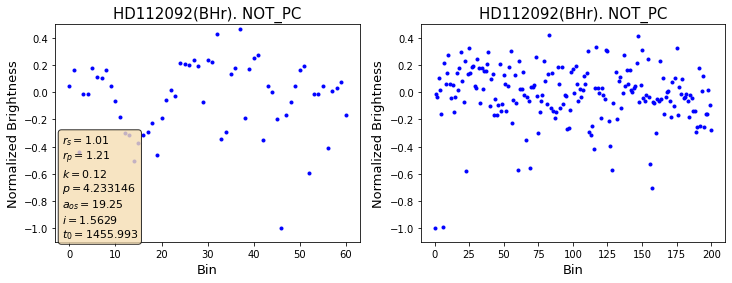

6066
{'target': 'HD27934', 'satellite': 'BLb', 'label': 'NOT_PC', 'r_s': 2.95956, 'r_p': <Quantity 2.06735101>, 'k': 0.0717831504441326, 'p': 3.266203512967571, 'a_os': 15.598004153954593, 'i': 1.563692882468487, 't_0': 2889.3609483613177}
(201,)
(1, 201)
(61,)


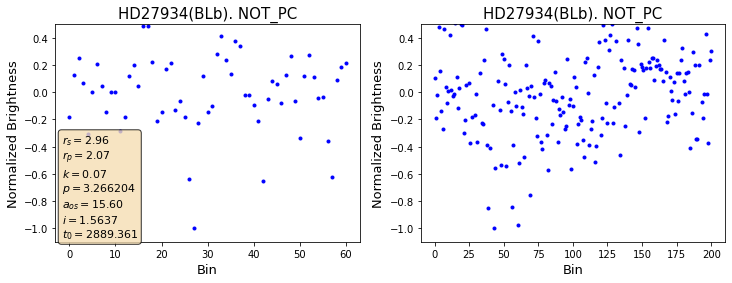

3793
{'target': 'HD17943', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 2.5702, 'r_p': <Quantity 1.74184197>, 'k': 0.0696429685799901, 'p': 4.690461475063014, 'a_os': 16.493063842339772, 'i': 1.5447831326273749, 't_0': 1727.9473853612794}
(201,)
(1, 201)
(61,)


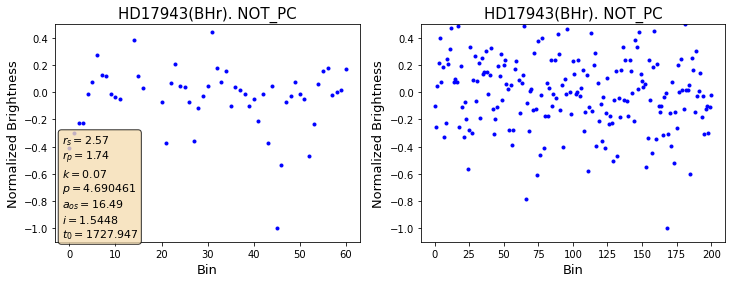

4391
{'target': 'HD198639', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 1.91513, 'r_p': <Quantity 1.69860884>, 'k': 0.0911445206267178, 'p': 4.542217579912855, 'a_os': 17.62311479908341, 'i': 1.55557544367624, 't_0': 3480.0033751480605}
(201,)
(1, 201)
(61,)


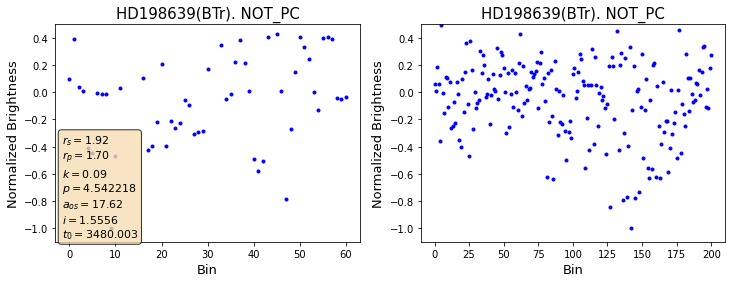

4827
{'target': 'HD210418', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 2.40784, 'r_p': <Quantity 1.19578944>, 'k': 0.0510343436778043, 'p': 3.973759292558049, 'a_os': 20.12642363096745, 'i': 1.5516174147609718, 't_0': 3045.120391935034}
(201,)
(1, 201)
(61,)


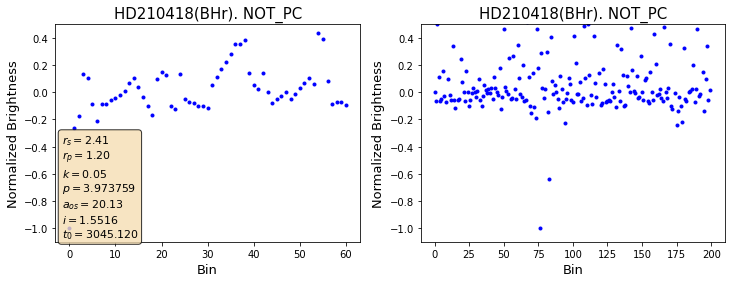

77
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'NOT_PC', 'r_s': 1.78292, 'r_p': <Quantity 1.07144164>, 'k': 0.0617549970343727, 'p': 2.48556711699096, 'a_os': 11.668733983781785, 'i': 1.5668164524848782, 't_0': 1460.793641786821}
(201,)
(1, 201)
(61,)


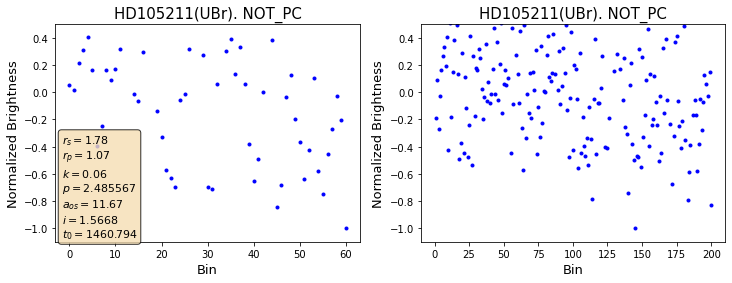

710
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'NOT_PC', 'r_s': 1.67, 'r_p': <Quantity 1.96145344>, 'k': 0.1206971392828345, 'p': 3.747973264506826, 'a_os': 13.798989771758604, 'i': 1.5483809920062233, 't_0': 1480.3167867868056}
(201,)
(1, 201)
(61,)


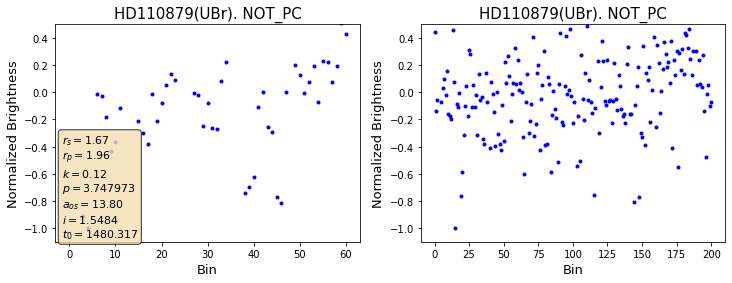

3351
{'target': 'HD173648', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 3.02036, 'r_p': <Quantity 1.53477357>, 'k': 0.0522180975200163, 'p': 4.756709032878959, 'a_os': 15.945858578220731, 'i': 1.5438075353372176, 't_0': 2291.314363148189}
(201,)
(1, 201)
(61,)


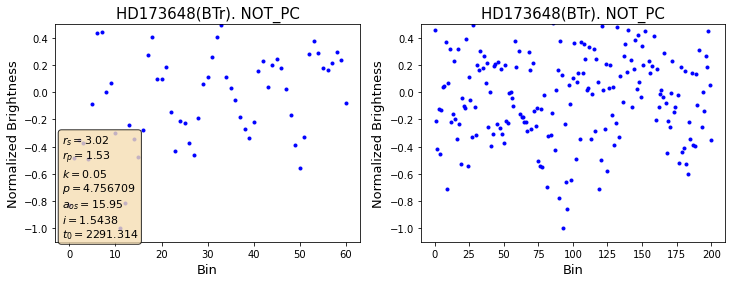

1991
{'target': 'HD128621', 'satellite': 'UBr', 'label': 'NOT_PC', 'r_s': 1.22533, 'r_p': <Quantity 1.61901838>, 'k': 0.1357794848015329, 'p': 4.313314147768946, 'a_os': 12.768126009987924, 'i': 1.5665411484263485, 't_0': 2212.29942078682}
(201,)
(1, 201)
(61,)


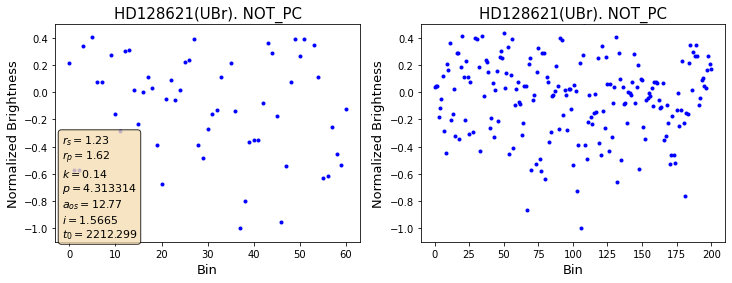

8480
{'target': 'HD4614', 'satellite': 'BAb', 'label': 'NOT_PC', 'r_s': 1.10787, 'r_p': <Quantity 1.87820892>, 'k': 0.1742170034572998, 'p': 2.6425888024818542, 'a_os': 17.683479216116297, 'i': 1.5483266564851996, 't_0': 1309.9241277871502}
(201,)
(1, 201)
(61,)


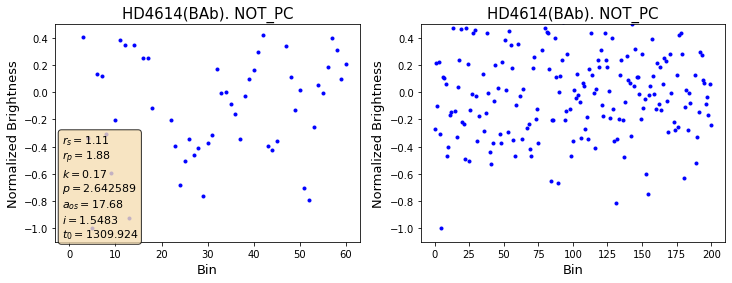

8702
{'target': 'HD46328', 'satellite': 'BLb', 'label': 'NOT_PC', 'r_s': 2.27, 'r_p': <Quantity 1.03940189>, 'k': 0.0470536251304973, 'p': 4.107657412404751, 'a_os': 18.08985209308586, 'i': 1.5637685676202515, 't_0': 1485.832818786878}
(201,)
(1, 201)
(61,)


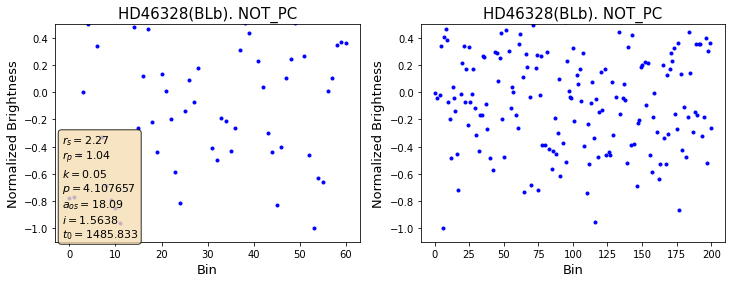

884
{'target': 'HD111123', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 1.82, 'r_p': <Quantity 1.42351021>, 'k': 0.0803756767339888, 'p': 2.9378402868531044, 'a_os': 18.44674334217345, 'i': 1.5481552062755684, 't_0': 1496.938576787043}
(201,)
(1, 201)
(61,)


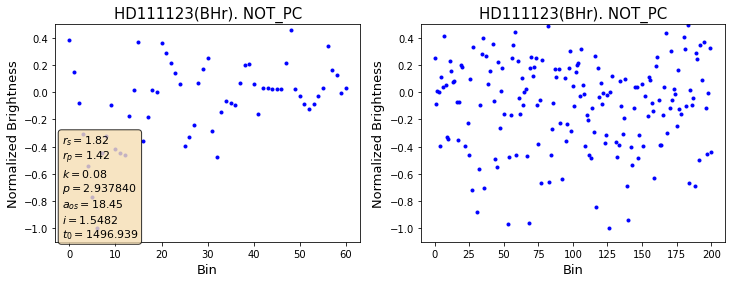

8838
{'target': 'HD55892', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 1.60696, 'r_p': <Quantity 1.59671258>, 'k': 0.1021073776315075, 'p': 3.5608933514551757, 'a_os': 21.0692318769025, 'i': 1.5661977083266505, 't_0': 2141.296550148292}
(201,)
(1, 201)
(61,)


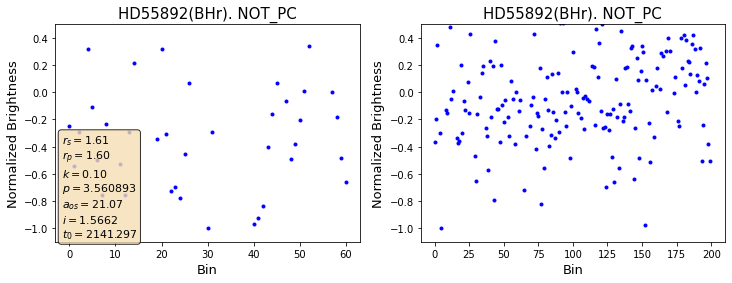

666
{'target': 'HD110879', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 1.67, 'r_p': <Quantity 1.35577685>, 'k': 0.0834271077024938, 'p': 4.244762543450509, 'a_os': 15.080083127478476, 'i': 1.541927529809828, 't_0': 3370.055097360957}
(201,)
(1, 201)
(61,)


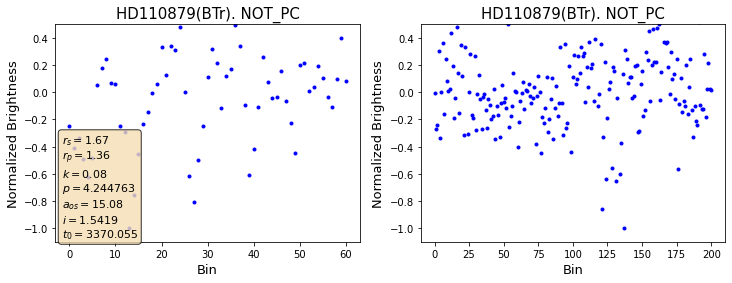

5461
{'target': 'HD218396', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 1.49338, 'r_p': <Quantity 1.22429811>, 'k': 0.0842465825240527, 'p': 2.956882989130852, 'a_os': 13.102563707055475, 'i': 1.564026261554344, 't_0': 2054.1280409353026}
(201,)
(1, 201)
(61,)


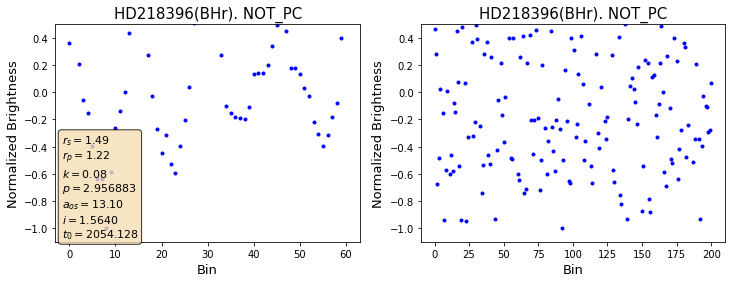

475
{'target': 'HD110879', 'satellite': 'BHr', 'label': 'NOT_PC', 'r_s': 1.67, 'r_p': <Quantity 1.53247652>, 'k': 0.0943002407458695, 'p': 4.250456134693524, 'a_os': 12.7141193409659, 'i': 1.5585333014139064, 't_0': 1457.2753517872502}
(201,)
(1, 201)
(61,)


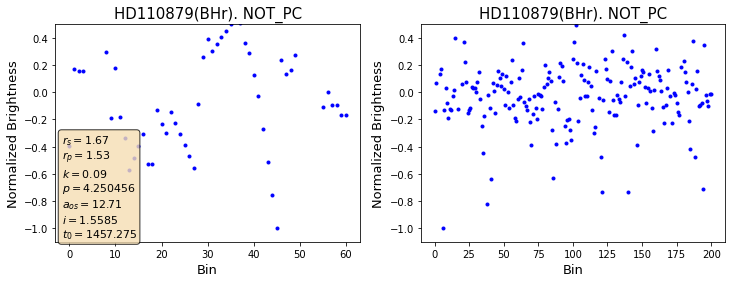

9583
{'target': 'HD71935', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 3.04036, 'r_p': <Quantity 2.05748278>, 'k': 0.0695419142736121, 'p': 1.5746408910696092, 'a_os': 11.919216697865338, 'i': 1.5428872896009045, 't_0': 3633.793178574245}
(201,)
(1, 201)
(61,)


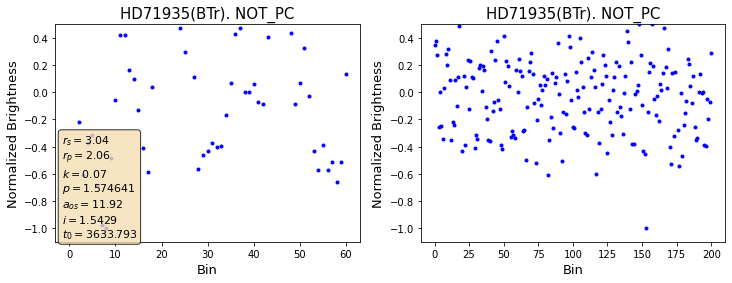

6960
{'target': 'HD32537', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 1.62058, 'r_p': <Quantity 1.26462549>, 'k': 0.0801912346617535, 'p': 4.283599478677055, 'a_os': 15.019832926827178, 'i': 1.559509137955723, 't_0': 1688.396930361028}
(201,)
(1, 201)
(61,)


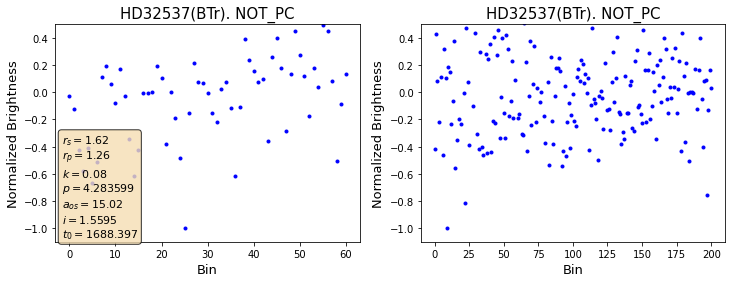

4109
{'target': 'HD192640', 'satellite': 'BTr', 'label': 'NOT_PC', 'r_s': 1.93986, 'r_p': <Quantity 1.27944126>, 'k': 0.0677774785294549, 'p': 3.004051672103369, 'a_os': 14.711207027541027, 'i': 1.5451551380449398, 't_0': 1533.1400763609922}
(201,)
(1, 201)
(61,)


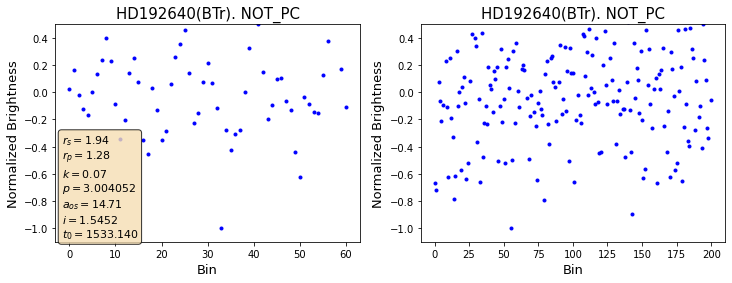

578
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'NOT_PC', 'r_s': 1.67, 'r_p': <Quantity 1.57108461>, 'k': 0.0966759719333164, 'p': 4.002693046841404, 'a_os': 16.501712338336297, 'i': 1.5691202716767487, 't_0': 1521.9976087871787}
(201,)
(1, 201)
(61,)


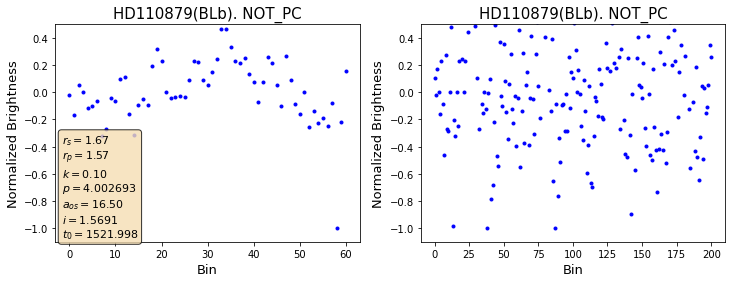

In [14]:
n_show = 20
count = 0
for idx in np.random.choice(range(len(indexs_NOT_PC)), n_show, replace=False).tolist():
    print(idx)
    plot_views(indexs_NOT_PC[idx], folder)

### Calculate predictions on PC examples

In [15]:
np.unique(data_labeled[data_labeled["label"] == "PC"]["index"]).shape

(1890,)

In [16]:
np.unique(data_labeled[data_labeled["label"] == "PC"]["index"])[-10]

11896

In [17]:
predictions = []
indexs = []

for index in np.unique(data_labeled[data_labeled["label"] == "PC"]["index"]):
    #print(index)
    data_local, data_global, _ = get_example(index, folder)
    
    prediction = model_astronet.predict( [data_global[1,:].reshape(1,-1), data_local[1,:].reshape(1,-1)] )[0][0][0]
    print(index, prediction)
    
    indexs.append(index)
    predictions.append(prediction)

1/1 [==============================] - 0s 15ms/step
0 0.07824995
1/1 [==============================] - 0s 13ms/step
1 0.47252163
1/1 [==============================] - 0s 21ms/step
2 0.30571172
1/1 [==============================] - 0s 18ms/step
19 0.9592789
1/1 [==============================] - 0s 13ms/step
20 0.8254436
1/1 [==============================] - 0s 14ms/step
21 0.54710203
1/1 [==============================] - 0s 18ms/step
38 0.20208094
1/1 [==============================] - 0s 14ms/step
39 0.7396626
1/1 [==============================] - 0s 14ms/step
40 0.39728683
1/1 [==============================] - 0s 13ms/step
57 0.62272036
1/1 [==============================] - 0s 13ms/step
58 0.9512584
1/1 [==============================] - 0s 20ms/step
59 0.10693261
1/1 [==============================] - 0s 12ms/step
76 0.95534253
1/1 [==============================] - 0s 14ms/step
77 0.97181356
1/1 [==============================] - 0s 14ms/step
78 0.9932076
1/1 [=============

1/1 [==============================] - 0s 15ms/step
1521 0.9923404
1/1 [==============================] - 0s 19ms/step
1522 0.7128965
1/1 [==============================] - 0s 13ms/step
1539 0.4054415
1/1 [==============================] - 0s 13ms/step
1540 0.9596781
1/1 [==============================] - 0s 17ms/step
1541 0.20431237
1/1 [==============================] - 0s 20ms/step
1558 0.82184416
1/1 [==============================] - 0s 12ms/step
1559 0.97399205
1/1 [==============================] - 0s 18ms/step
1560 0.11485752
1/1 [==============================] - 0s 17ms/step
1577 0.399074
1/1 [==============================] - 0s 14ms/step
1578 0.45387423
1/1 [==============================] - 0s 14ms/step
1579 0.044264685
1/1 [==============================] - 0s 15ms/step
1596 0.92632884
1/1 [==============================] - 0s 13ms/step
1597 0.94974667
1/1 [==============================] - 0s 25ms/step
1598 0.9260865
1/1 [==============================] - 0s 14ms/step
16

1/1 [==============================] - 0s 16ms/step
2280 0.064243674
1/1 [==============================] - 0s 14ms/step
2281 0.97097486
1/1 [==============================] - 0s 14ms/step
2282 0.298196
1/1 [==============================] - 0s 19ms/step
2299 0.26728418
1/1 [==============================] - 0s 19ms/step
2300 0.9568482
1/1 [==============================] - 0s 14ms/step
2301 0.019344784
1/1 [==============================] - 0s 14ms/step
2318 0.36924133
1/1 [==============================] - 0s 17ms/step
2319 0.95160186
1/1 [==============================] - 0s 16ms/step
2320 0.3036106
1/1 [==============================] - 0s 20ms/step
2337 0.86793876
1/1 [==============================] - 0s 14ms/step
2338 0.9780195
1/1 [==============================] - 0s 19ms/step
2339 0.48773354
1/1 [==============================] - 0s 13ms/step
2356 0.38821542
1/1 [==============================] - 0s 20ms/step
2357 0.9945329
1/1 [==============================] - 0s 17ms/step


1/1 [==============================] - 0s 13ms/step
3781 0.031447582
1/1 [==============================] - 0s 13ms/step
3782 0.25352302
1/1 [==============================] - 0s 15ms/step
3783 0.15806402
1/1 [==============================] - 0s 18ms/step
3800 0.0122899525
1/1 [==============================] - 0s 13ms/step
3801 0.00016420391
1/1 [==============================] - 0s 13ms/step
3802 0.0006035788
1/1 [==============================] - 0s 16ms/step
3819 0.21263628
1/1 [==============================] - 0s 13ms/step
3820 0.69152236
1/1 [==============================] - 0s 18ms/step
3821 0.5644021
1/1 [==============================] - 0s 19ms/step
3838 0.00067354576
1/1 [==============================] - 0s 13ms/step
3839 0.00020528701
1/1 [==============================] - 0s 17ms/step
3840 0.0019284557
1/1 [==============================] - 0s 18ms/step
3857 0.000110221496
1/1 [==============================] - 0s 21ms/step
3858 0.00018451449
1/1 [=====================

1/1 [==============================] - 0s 17ms/step
4523 0.005564286
1/1 [==============================] - 0s 18ms/step
4524 0.004500484
1/1 [==============================] - 0s 17ms/step
4541 0.0004584809
1/1 [==============================] - 0s 13ms/step
4542 0.019576892
1/1 [==============================] - 0s 19ms/step
4543 0.010057922
1/1 [==============================] - 0s 20ms/step
4560 0.010090972
1/1 [==============================] - 0s 14ms/step
4561 0.0037254144
1/1 [==============================] - 0s 14ms/step
4562 0.0017673637
1/1 [==============================] - 0s 20ms/step
4579 0.0001036591
1/1 [==============================] - 0s 13ms/step
4580 0.0003547284
1/1 [==============================] - 0s 12ms/step
4581 8.284561e-05
1/1 [==============================] - 0s 16ms/step
4598 0.0005408229
1/1 [==============================] - 0s 13ms/step
4599 1.4059498e-05
1/1 [==============================] - 0s 13ms/step
4600 0.0026226558
1/1 [===================

1/1 [==============================] - 0s 13ms/step
6025 0.008419078
1/1 [==============================] - 0s 13ms/step
6042 0.9824327
1/1 [==============================] - 0s 15ms/step
6043 0.98918027
1/1 [==============================] - 0s 14ms/step
6044 0.8633583
1/1 [==============================] - 0s 13ms/step
6061 0.8783823
1/1 [==============================] - 0s 13ms/step
6062 0.91665906
1/1 [==============================] - 0s 17ms/step
6063 0.49563926
1/1 [==============================] - 0s 17ms/step
6080 0.0010940405
1/1 [==============================] - 0s 14ms/step
6081 0.0059560863
1/1 [==============================] - 0s 16ms/step
6082 0.00801674
1/1 [==============================] - 0s 20ms/step
6099 0.00026655232
1/1 [==============================] - 0s 14ms/step
6100 0.0116934115
1/1 [==============================] - 0s 15ms/step
6101 0.026008131
1/1 [==============================] - 0s 16ms/step
6118 0.7445542
1/1 [==============================] - 0s

1/1 [==============================] - 0s 18ms/step
7526 0.00015437104
1/1 [==============================] - 0s 14ms/step
7543 0.0019419314
1/1 [==============================] - 0s 13ms/step
7544 0.019263564
1/1 [==============================] - 0s 17ms/step
7545 0.024782741
1/1 [==============================] - 0s 13ms/step
7562 0.00015411308
1/1 [==============================] - 0s 13ms/step
7563 0.0016717041
1/1 [==============================] - 0s 13ms/step
7564 3.742082e-05
1/1 [==============================] - 0s 18ms/step
7581 0.0005455027
1/1 [==============================] - 0s 19ms/step
7582 4.964428e-05
1/1 [==============================] - 0s 18ms/step
7583 0.0023600436
1/1 [==============================] - 0s 20ms/step
7600 0.011678312
1/1 [==============================] - 0s 13ms/step
7601 0.012939279
1/1 [==============================] - 0s 12ms/step
7602 0.00032793393
1/1 [==============================] - 0s 14ms/step
7619 7.270539e-05
1/1 [================

1/1 [==============================] - 0s 14ms/step
9008 0.02959106
1/1 [==============================] - 0s 14ms/step
9025 0.0009443801
1/1 [==============================] - 0s 14ms/step
9026 8.204316e-05
1/1 [==============================] - 0s 13ms/step
9027 0.00034329426
1/1 [==============================] - 0s 14ms/step
9044 0.0017120772
1/1 [==============================] - 0s 13ms/step
9045 0.00020263909
1/1 [==============================] - 0s 14ms/step
9046 4.72364e-05
1/1 [==============================] - 0s 14ms/step
9063 0.0006969486
1/1 [==============================] - 0s 13ms/step
9064 0.00018785008
1/1 [==============================] - 0s 19ms/step
9065 0.00047534407
1/1 [==============================] - 0s 20ms/step
9082 0.005576384
1/1 [==============================] - 0s 13ms/step
9083 0.009867404
1/1 [==============================] - 0s 14ms/step
9084 0.0014976477
1/1 [==============================] - 0s 14ms/step
9101 0.0023778037
1/1 [================

1/1 [==============================] - 0s 21ms/step
9767 0.00067456136
1/1 [==============================] - 0s 14ms/step
9768 0.0015618408
1/1 [==============================] - 0s 17ms/step
9785 0.0003365972
1/1 [==============================] - 0s 17ms/step
9786 3.9254894e-05
1/1 [==============================] - 0s 20ms/step
9787 0.0004205692
1/1 [==============================] - 0s 17ms/step
9804 0.0011014217
1/1 [==============================] - 0s 16ms/step
9805 0.0030203278
1/1 [==============================] - 0s 15ms/step
9806 2.3131644e-05
1/1 [==============================] - 0s 13ms/step
9823 1.341483e-05
1/1 [==============================] - 0s 13ms/step
9824 2.102887e-05
1/1 [==============================] - 0s 14ms/step
9825 1.3024209e-05
1/1 [==============================] - 0s 15ms/step
9842 0.00012337575
1/1 [==============================] - 0s 17ms/step
9843 0.0040931455
1/1 [==============================] - 0s 14ms/step
9844 1.8240324e-05
1/1 [=========

1/1 [==============================] - 0s 14ms/step
11230 0.017050102
1/1 [==============================] - 0s 14ms/step
11231 0.0038446286
1/1 [==============================] - 0s 13ms/step
11248 0.00027449787
1/1 [==============================] - 0s 14ms/step
11249 0.00079025904
1/1 [==============================] - 0s 13ms/step
11250 0.00072122115
1/1 [==============================] - 0s 16ms/step
11267 0.00027345872
1/1 [==============================] - 0s 18ms/step
11268 0.00070908363
1/1 [==============================] - 0s 19ms/step
11269 0.0012735096
1/1 [==============================] - 0s 13ms/step
11286 0.00015238572
1/1 [==============================] - 0s 14ms/step
11287 0.004266676
1/1 [==============================] - 0s 13ms/step
11288 0.0010409203
1/1 [==============================] - 0s 12ms/step
11305 4.4362812e-05
1/1 [==============================] - 0s 17ms/step
11306 2.3377628e-05
1/1 [==============================] - 0s 14ms/step
11307 4.7247664e-05

In [18]:
# 360 de 1803 obtienen un score >= 0.5

predictions_ = np.array(predictions)

print(predictions_.shape)
print(predictions_[predictions_ >= 0.5].shape)

print(predictions_[predictions_ >= 0.5].shape[0] / predictions_.shape[0])

(1890,)
(392,)
0.2074074074074074


### Select PC ( match group of candidates)

Considerar grupo la triada de ejemplos donde solo varia el periodo ± 2/1440 (day)

Este approach consiste en seleccionar como PC todos los ejemplos de un grupo si al menos un ejemplo del grupo obtiene un score >= 0.5

In [19]:
# create a graph to match group of candidates (i.e. same parameters except p)

PC_and_NOT_label = data_labeled[data_labeled["view"] == "Global"][['label', 'index']]['label'].to_list()
PC_and_NOT_index = data_labeled[data_labeled["view"] == "Global"][['label', 'index']]['index'].to_list()

print(len(PC_and_NOT_label), len(PC_and_NOT_index))

match = {}
group = 0
for idx, label in enumerate(PC_and_NOT_label):  
    if (label == "PC"):
        if ( group not in match):
            match[group] = [ PC_and_NOT_index[idx] ]
        else:
            match[group].append(  PC_and_NOT_index[idx] )
    if (label == "NOT_PC"):
        group+=1

graph = {}
for key in match:
    for element in match[key]:
        graph[ element ] = match[key]

11970 11970


In [20]:
graph

{0: [0, 1, 2],
 1: [0, 1, 2],
 2: [0, 1, 2],
 19: [19, 20, 21],
 20: [19, 20, 21],
 21: [19, 20, 21],
 38: [38, 39, 40],
 39: [38, 39, 40],
 40: [38, 39, 40],
 57: [57, 58, 59],
 58: [57, 58, 59],
 59: [57, 58, 59],
 76: [76, 77, 78],
 77: [76, 77, 78],
 78: [76, 77, 78],
 95: [95, 96, 97],
 96: [95, 96, 97],
 97: [95, 96, 97],
 114: [114, 115, 116],
 115: [114, 115, 116],
 116: [114, 115, 116],
 133: [133, 134, 135],
 134: [133, 134, 135],
 135: [133, 134, 135],
 152: [152, 153, 154],
 153: [152, 153, 154],
 154: [152, 153, 154],
 171: [171, 172, 173],
 172: [171, 172, 173],
 173: [171, 172, 173],
 190: [190, 191, 192],
 191: [190, 191, 192],
 192: [190, 191, 192],
 209: [209, 210, 211],
 210: [209, 210, 211],
 211: [209, 210, 211],
 228: [228, 229, 230],
 229: [228, 229, 230],
 230: [228, 229, 230],
 247: [247, 248, 249],
 248: [247, 248, 249],
 249: [247, 248, 249],
 266: [266, 267, 268],
 267: [266, 267, 268],
 268: [266, 267, 268],
 285: [285, 286, 287],
 286: [285, 286, 287],
 28

In [21]:
# select if at least one of the group got score >=0.5 

selected_PC_indexs = []

for idx, predict in enumerate(predictions):
    if (indexs[idx] in selected_PC_indexs): # skip
        continue
    
    if (predict >= 0.5):
        print(predict, indexs[idx])
        
        for candidate in graph[indexs[idx]]:
            selected_PC_indexs.append(candidate)

0.9592789 19
0.7396626 39
0.62272036 57
0.95534253 76
0.7117163 96
0.88676757 247
0.5634912 266
0.9854961 285
0.96529746 306
0.975968 324
0.9701588 342
0.8846664 361
0.5571224 381
0.72457296 420
0.7374208 534
0.70586175 589
0.9645523 609
0.7531632 628
0.98586905 647
0.78821295 666
0.746732 684
0.9588937 818
0.9210564 837
0.92706376 856
0.9973142 875
0.985212 912
0.88374877 951
0.76468474 988
0.9907092 1008
0.5027401 1027
0.6700224 1045
0.99267447 1064
0.68847466 1236
0.8025663 1254
0.6631072 1274
0.74183536 1293
0.9688617 1312
0.9583159 1330
0.76584095 1350
0.98809195 1369
0.9646558 1387
0.9860681 1406
0.86556226 1425
0.9923404 1521
0.9596781 1540
0.82184416 1558
0.92632884 1596
0.9907871 1616
0.9740574 1673
0.8034953 1768
0.99134517 2091
0.99174947 2110
0.5230404 2128
0.70847183 2148
0.8346828 2167
0.8051556 2185
0.9089696 2205
0.95249265 2224
0.51800966 2243
0.8874044 2261
0.97097486 2281
0.9568482 2300
0.95160186 2319
0.86793876 2337
0.9945329 2357
0.7980127 2376
0.9200142 2395
0.98

In [22]:
print(len(selected_PC_indexs))
print(len(set(selected_PC_indexs)))

# este resultado amerirta re-entrenar astronet.

639
639


1.6620802863849762


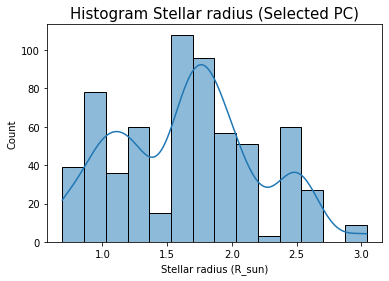

In [23]:
list_radius = []
for idx in selected_PC_indexs:
    info = get_example(idx, folder, only_info = True)
    list_radius.append(info['r_s'])
print(np.mean(list_radius))


plt.title(f"Histogram Stellar radius (Selected PC)", fontsize = 15)
sns.histplot(data=list_radius, kde=True)
plt.xlabel("Stellar radius (R_sun)")
plt.show()

In [24]:
not_selected_PC_indexs = []
for idx, predict in enumerate(predictions):
    if (indexs[idx] not in selected_PC_indexs):
        not_selected_PC_indexs.append(indexs[idx])

In [25]:
print(len(not_selected_PC_indexs))
print(len(selected_PC_indexs) / (len(selected_PC_indexs) + len(not_selected_PC_indexs)))
print(len(predictions))
print(len(selected_PC_indexs) + len(not_selected_PC_indexs))

1251
0.3380952380952381
1890
1890


2.2393112230215824


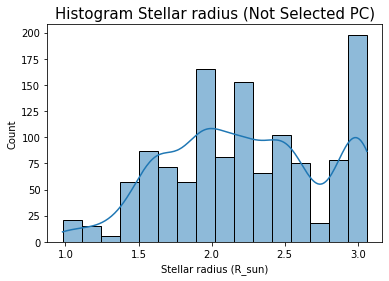

In [26]:
list_radius = []
for idx in not_selected_PC_indexs:
    info = get_example(idx, folder, only_info = True)
    list_radius.append(info['r_s'])
print(np.mean(list_radius))


plt.title(f"Histogram Stellar radius (Not Selected PC)", fontsize = 15)
sns.histplot(data=list_radius, kde=True)
plt.xlabel("Stellar radius (R_sun)")
plt.show()

In [27]:
# using the same portion of [Yu (2019)]
total = 493+2155+13868
print(total)

# considering transit both PC's and EB's 
portion_transit = (493 + 2155)/total
portion_non_transit = 13868/total

print(portion_non_transit)
print(portion_transit)
print(portion_non_transit + portion_transit)

16516
0.8396706224267377
0.1603293775732623
1.0


In [28]:
print(len(selected_PC_indexs))
print(len(selected_PC_indexs) + len(not_selected_PC_indexs))
print()

n_pc = len(selected_PC_indexs)
n_not_pc = int(portion_non_transit * len(selected_PC_indexs) / portion_transit)

print(n_not_pc/(n_pc + n_not_pc))
print(n_pc/(n_pc + n_not_pc))

639
1890

0.8396486825595985
0.16035131744040151


In [29]:
# se escoje aleatoriamente de not pc 
selected_not_PC_indexs = []
np.random.seed(82824)
for idx in np.random.choice(list(np.unique(data_labeled[data_labeled["label"] == "NOT_PC"]["index"])), n_not_pc, 
                            replace=False).tolist():
    selected_not_PC_indexs.append(idx)

In [30]:
print(len(selected_not_PC_indexs))
print(len(set(selected_not_PC_indexs))) # check consistency
print()
print( len(selected_not_PC_indexs) + len(selected_PC_indexs) )
print(len(set(selected_not_PC_indexs + selected_PC_indexs))) # check consistency

3346
3346

3985
3985


In [31]:
print(  len(selected_PC_indexs) / (len(selected_not_PC_indexs) + len(selected_PC_indexs) ))
print(  len(selected_not_PC_indexs) / (len(selected_not_PC_indexs) + len(selected_PC_indexs) ))


0.16035131744040151
0.8396486825595985


In [32]:
# el paso siguiente seria algo como crear un dataframe con los selected_PC_indexs y con los selected_not_PC_index
data_labeled_selected = data_labeled.copy()
df1 = data_labeled_selected[data_labeled_selected['index'].isin(selected_PC_indexs)].copy()
df2 = data_labeled_selected[data_labeled_selected['index'].isin(selected_not_PC_indexs)].copy()
data_labeled_selected = pd.concat([df1, df2], ignore_index = True)

In [33]:
len(np.unique(data_labeled_selected['index'])) # check consistency

3985

In [35]:
data_labeled_selected

,target,satellite,label,index,filename,view,period,t0,star_radius,k,aos,i,e,w,ldcs_1,ldcs_2,n_points_transit
0,HD105211,UBr,PC,19,19_curve_HD105211_UBr.npy,Curve,3.321004,1504.376576,1.78292,0.103660,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
1,HD105211,UBr,PC,19,19_fold_HD105211_UBr.npy,PhaseFold,3.321004,1504.376576,1.78292,0.103660,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
2,HD105211,UBr,PC,19,19_global_HD105211_UBr.npy,Global,3.321004,1504.376576,1.78292,0.103660,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
3,HD105211,UBr,PC,19,19_local_HD105211_UBr.npy,Local,3.321004,1504.376576,1.78292,0.103660,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
4,HD105211,UBr,PC,20,20_curve_HD105211_UBr.npy,Curve,3.322393,1504.376576,1.78292,0.103660,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
12589,HD88661,BHr,NOT_PC,11965,11965_global_HD88661_BHr.npy,Global,3.510666,3354.476484,2.59000,0.041473,23.936251,1.554363,0.0,0.0,NaN,NaN,1342
12590,HD88661,BHr,NOT_PC,11965,11965_local_HD88661_BHr.npy,Local,3.510666,3354.476484,2.59000,0.041473,23.936251,1.554363,0.0,0.0,NaN,NaN,1342
12591,HD88661,BHr,NOT_PC,11969,11969_fold_HD88661_BHr.npy,PhaseFold,4.870555,2913.873858,2.59000,0.052019,20.435022,1.538870,0.0,0.0,NaN,NaN,1342
12592,HD88661,BHr,NOT_PC,11969,11969_global_HD88661_BHr.npy,Global,4.870555,2913.873858,2.59000,0.052019,20.435022,1.538870,0.0,0.0,NaN,NaN,1342


In [36]:
data_labeled_selected.to_csv('data_labeled_selected_old.csv', index = False)

## Split 

In [38]:
#

In [39]:
from sklearn.model_selection import train_test_split


In [40]:
data_labeled_selected = pd.read_csv('data_labeled_selected_old.csv')


In [41]:
# check consistency
print(len(np.unique(data_labeled_selected['index'])) )
data_labeled_selected.head()

3985


,target,satellite,label,index,filename,view,period,t0,star_radius,k,aos,i,e,w,ldcs_1,ldcs_2,n_points_transit
0,HD105211,UBr,PC,19,19_curve_HD105211_UBr.npy,Curve,3.321004,1504.376576,1.78292,0.10366,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
1,HD105211,UBr,PC,19,19_fold_HD105211_UBr.npy,PhaseFold,3.321004,1504.376576,1.78292,0.10366,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
2,HD105211,UBr,PC,19,19_global_HD105211_UBr.npy,Global,3.321004,1504.376576,1.78292,0.10366,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
3,HD105211,UBr,PC,19,19_local_HD105211_UBr.npy,Local,3.321004,1504.376576,1.78292,0.10366,15.016372,1.553367,0.0,0.0,0.27,0.08,1350
4,HD105211,UBr,PC,20,20_curve_HD105211_UBr.npy,Curve,3.322393,1504.376576,1.78292,0.10366,15.016372,1.553367,0.0,0.0,0.27,0.08,1350


In [42]:
test_size_ = 0.1
train_indexs, test_indexs = train_test_split(np.unique(data_labeled_selected["index"]), test_size=test_size_, random_state=53861793)


In [43]:
print(train_indexs.shape)
print(test_indexs.shape)

print(train_indexs.shape[0] / len(list(np.unique(data_labeled_selected["index"]))))
print(test_indexs.shape[0] / len(list(np.unique(data_labeled_selected["index"]))))

(3586,)
(399,)
0.8998745294855709
0.1001254705144291


In [44]:
3586+399

3985

In [45]:
data_train_full = data_labeled_selected[data_labeled_selected['index'].isin(train_indexs)]
data_test_full = data_labeled_selected[data_labeled_selected['index'].isin(test_indexs)]

In [46]:
print(data_train_full.shape)
print(data_test_full.shape)


(11338, 17)
(1256, 17)


In [47]:
data_test_without_label = data_test_full.copy()
data_test_without_label_ = data_test_without_label[(data_test_without_label["view"] == "Local")|(data_test_without_label["view"] == "Global")]
data_test_without_label_ = data_test_without_label_.drop(columns=['period', 't0', 'star_radius', 'k', 'aos', 'i', 'e', 'w', 'ldcs_1', 'ldcs_2', 'label'])
data_test_without_label_

,target,satellite,index,filename,view,n_points_transit
14,HD105211,UBr,38,38_global_HD105211_UBr.npy,Global,1491
15,HD105211,UBr,38,38_local_HD105211_UBr.npy,Local,1491
38,HD105211,UBr,76,76_global_HD105211_UBr.npy,Global,1531
39,HD105211,UBr,76,76_local_HD105211_UBr.npy,Local,1531
58,HD105211,UBr,97,97_global_HD105211_UBr.npy,Global,711
...,...,...,...,...,...,...
12377,HD74956,BAb,11694,11694_local_HD74956_BAb.npy,Local,1089
12400,HD74956,BAb,11730,11730_global_HD74956_BAb.npy,Global,729
12401,HD74956,BAb,11730,11730_local_HD74956_BAb.npy,Local,729
12433,HD74956,BTr,11777,11777_global_HD74956_BTr.npy,Global,1494


In [48]:
# check consistency

print(data_test_without_label_.shape)
print(data_test_full[data_test_full["label"]=="PC"].shape[0]//4 + data_test_full[data_test_full["label"]=="NOT_PC"].shape[0]//3) # check consistency
print(data_test_without_label_.shape[0]//2) # check consistency

(798, 6)
399
399


In [49]:
# save
#data_train_full.to_csv('csv/data_train_full_old.csv', index = False)
#data_test_full.to_csv('csv/data_test_full_old.csv', index = False)
#data_test_without_label_.to_csv('csv/data_test_without_label_old.csv', index = False)

## Analyse predictions score

###  Compare higher prediction with lower predictions

0.7412782 39
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.80082405>, 'k': 0.0532929147772961, 'p': 3.923669966090397, 'a_os': 4.201768487340627, 'i': 1.5378611386958485, 't_0': 1453.9701437868955}
(201,)
(1, 201)
(61,)


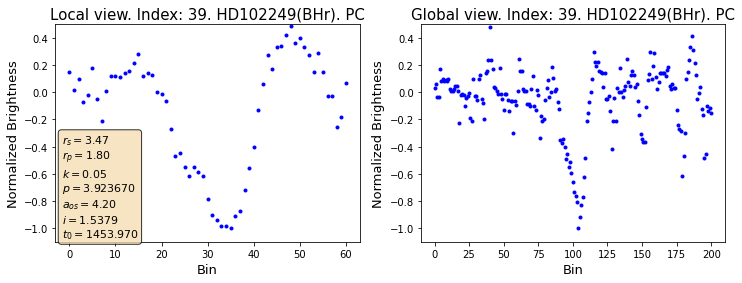

0.92444503 40
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.80082405>, 'k': 0.0532929147772961, 'p': 3.9250588549792864, 'a_os': 4.201768487340627, 'i': 1.5378611386958485, 't_0': 1453.9701437868955}
(201,)
(1, 201)
(61,)


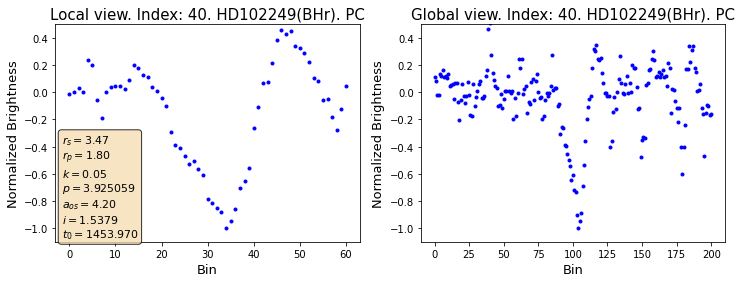

0.8681273 95
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.84548093>, 'k': 0.0546144738781189, 'p': 1.3325405154412884, 'a_os': 2.046722843687201, 'i': 1.5437071045099022, 't_0': 1438.2527207869884}
(201,)
(1, 201)
(61,)


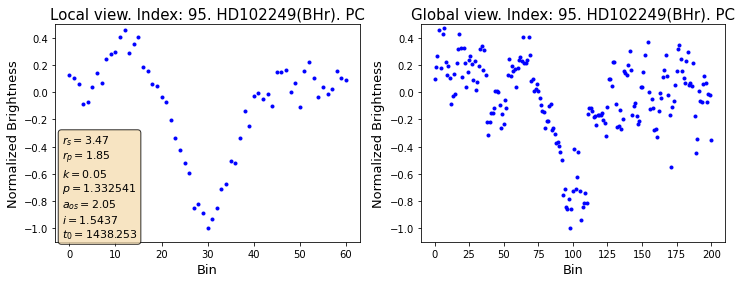

0.73329294 96
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.84548093>, 'k': 0.0546144738781189, 'p': 1.3339294043301773, 'a_os': 2.046722843687201, 'i': 1.5437071045099022, 't_0': 1438.2527207869884}
(201,)
(1, 201)
(61,)


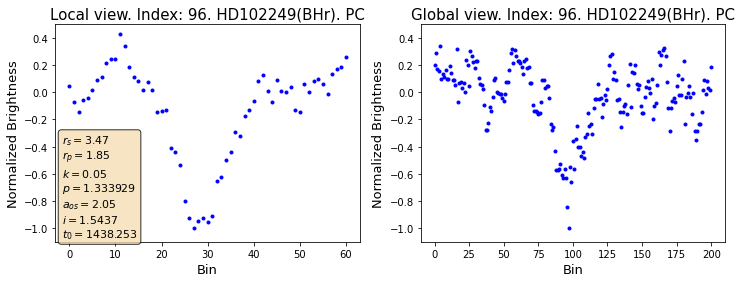

0.76311433 97
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.84548093>, 'k': 0.0546144738781189, 'p': 1.335318293219066, 'a_os': 2.046722843687201, 'i': 1.5437071045099022, 't_0': 1438.2527207869884}
(201,)
(1, 201)
(61,)


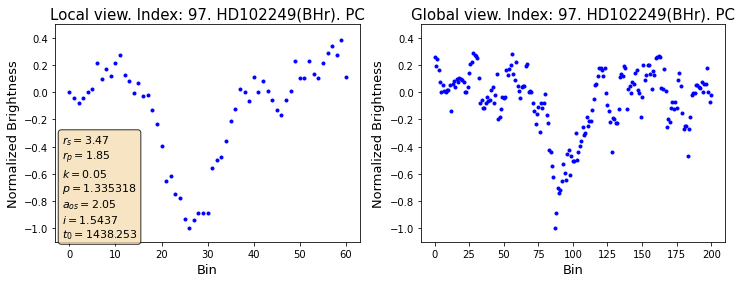

0.85443634 248
{'target': 'HD102776', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.9, 'r_p': <Quantity 1.84608302>, 'k': 0.0486431917567435, 'p': 4.929291112930793, 'a_os': 4.49276176876409, 'i': 1.5571606883225602, 't_0': 3000.5498293608903}
(201,)
(1, 201)
(61,)


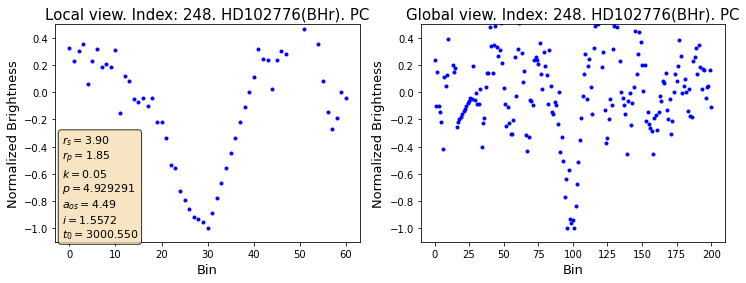

0.80970013 267
{'target': 'HD102776', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.9, 'r_p': <Quantity 1.54582638>, 'k': 0.040731607426885, 'p': 1.61612922570807, 'a_os': 2.136196183969165, 'i': 1.5502353684935612, 't_0': 2942.048641361157}
(201,)
(1, 201)
(61,)


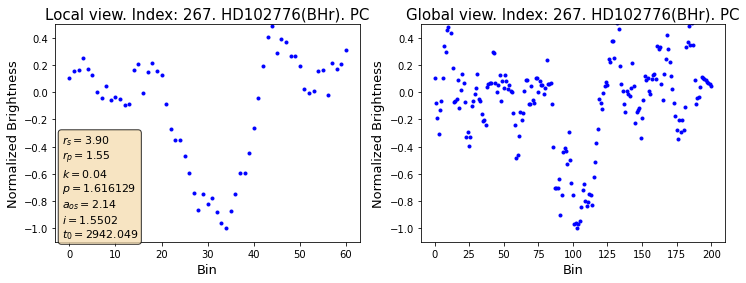

0.7563543 476
{'target': 'HD102776', 'satellite': 'BTr', 'label': 'PC', 'r_s': 3.9, 'r_p': <Quantity 1.44161938>, 'k': 0.0379858150351888, 'p': 2.797261112284944, 'a_os': 3.079492027619388, 'i': 1.546446105049946, 't_0': 1509.2092921483654}
(201,)
(1, 201)
(61,)


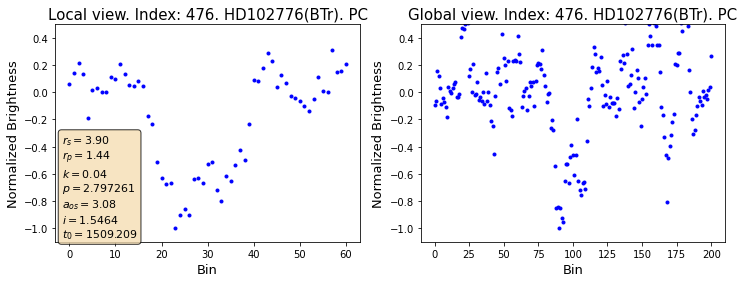

0.64783126 477
{'target': 'HD102776', 'satellite': 'BTr', 'label': 'PC', 'r_s': 3.9, 'r_p': <Quantity 1.44161938>, 'k': 0.0379858150351888, 'p': 2.798650001173833, 'a_os': 3.079492027619388, 'i': 1.546446105049946, 't_0': 1509.2092921483654}
(201,)
(1, 201)
(61,)


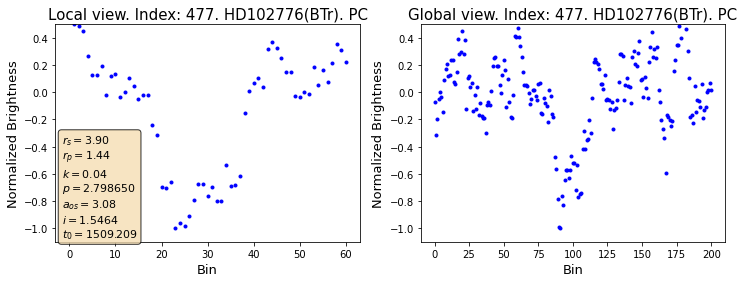

0.6455069 494
{'target': 'HD102776', 'satellite': 'BTr', 'label': 'PC', 'r_s': 3.9, 'r_p': <Quantity 1.80766452>, 'k': 0.0476308872129877, 'p': 1.9687990247750016, 'a_os': 2.437785629446221, 'i': 1.5679811323102075, 't_0': 1485.812655148222}
(201,)
(1, 201)
(61,)


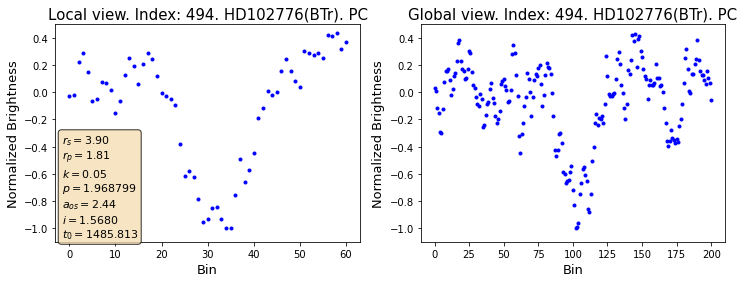

0.98465145 513
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.11326918>, 'k': 0.0641658235464051, 'p': 3.270033022743493, 'a_os': 6.068743767940871, 'i': 1.543305048913487, 't_0': 1538.1942757868987}
(201,)
(1, 201)
(61,)


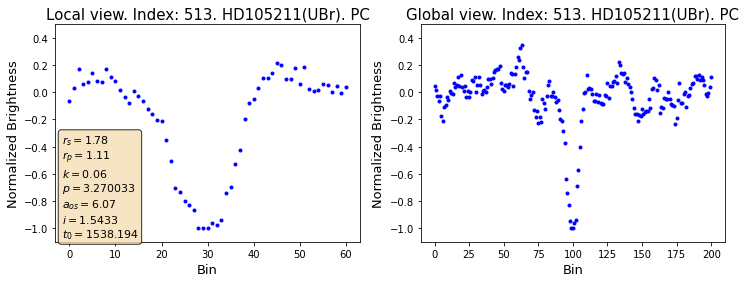

0.9924346 514
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.11326918>, 'k': 0.0641658235464051, 'p': 3.271421911632382, 'a_os': 6.068743767940871, 'i': 1.543305048913487, 't_0': 1538.1942757868987}
(201,)
(1, 201)
(61,)


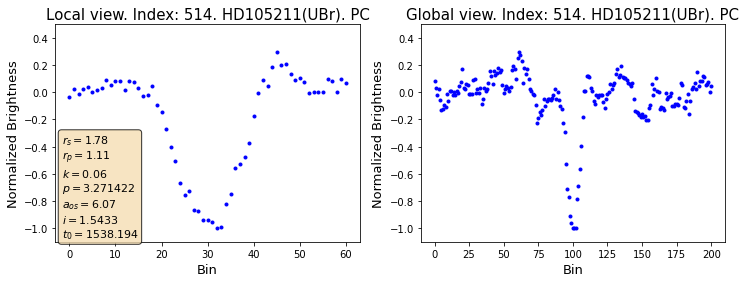

0.96479064 515
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.11326918>, 'k': 0.0641658235464051, 'p': 3.2728108005212717, 'a_os': 6.068743767940871, 'i': 1.543305048913487, 't_0': 1538.1942757868987}
(201,)
(1, 201)
(61,)


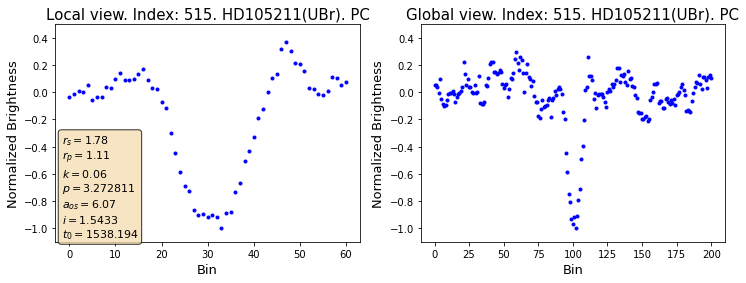

0.9976005 532
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.7520292>, 'k': 0.100982222735937, 'p': 2.639128769041708, 'a_os': 5.260986005149937, 'i': 1.5572504580142783, 't_0': 1517.8317887869512}
(201,)
(1, 201)
(61,)


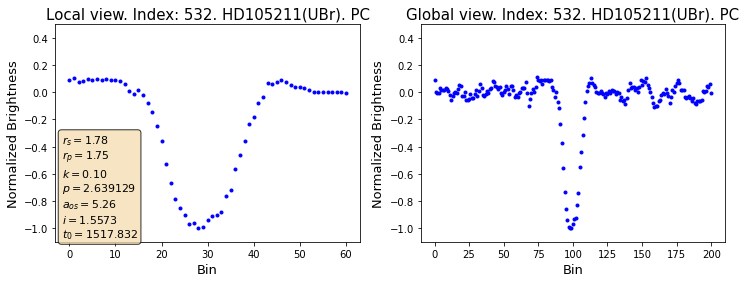

0.99812514 533
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.7520292>, 'k': 0.100982222735937, 'p': 2.6405176579305967, 'a_os': 5.260986005149937, 'i': 1.5572504580142783, 't_0': 1517.8317887869512}
(201,)
(1, 201)
(61,)


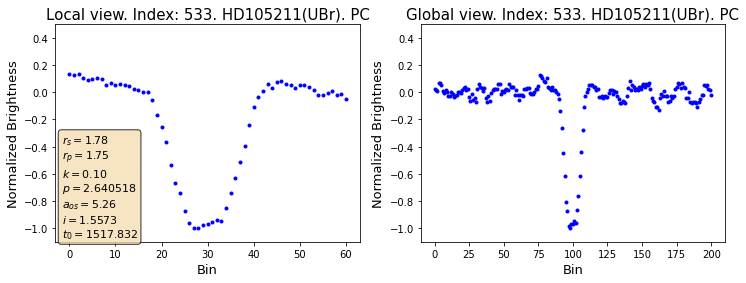

0.99739987 534
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.7520292>, 'k': 0.100982222735937, 'p': 2.641906546819486, 'a_os': 5.260986005149937, 'i': 1.5572504580142783, 't_0': 1517.8317887869512}
(201,)
(1, 201)
(61,)


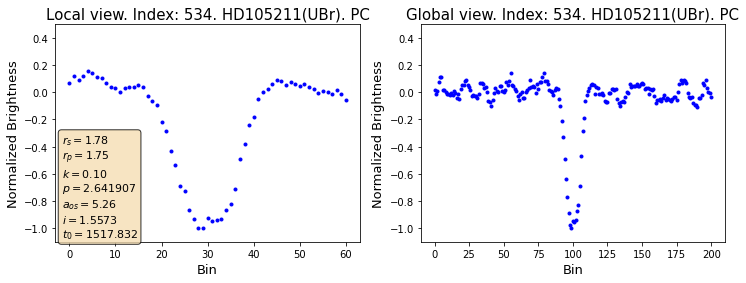

0.9738364 551
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 0.97263543>, 'k': 0.0560600746532397, 'p': 2.499300240333222, 'a_os': 5.073576735360128, 'i': 1.5485417293935675, 't_0': 1499.7709607871095}
(201,)
(1, 201)
(61,)


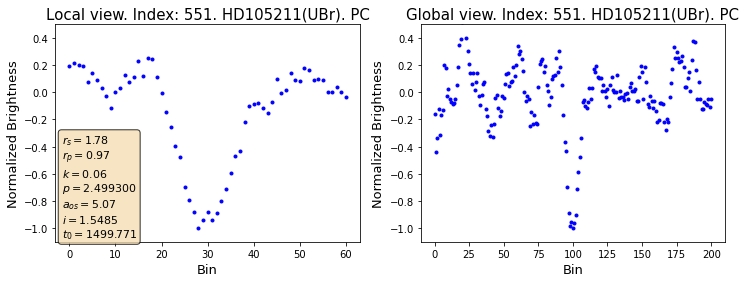

0.9860207 552
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 0.97263543>, 'k': 0.0560600746532397, 'p': 2.500689129222111, 'a_os': 5.073576735360128, 'i': 1.5485417293935675, 't_0': 1499.7709607871095}
(201,)
(1, 201)
(61,)


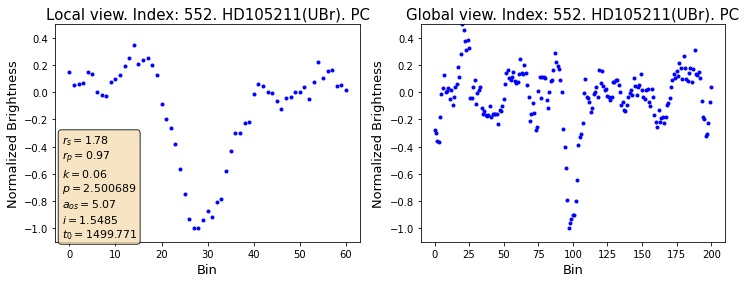

0.68911505 553
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 0.97263543>, 'k': 0.0560600746532397, 'p': 2.5020780181110003, 'a_os': 5.073576735360128, 'i': 1.5485417293935675, 't_0': 1499.7709607871095}
(201,)
(1, 201)
(61,)


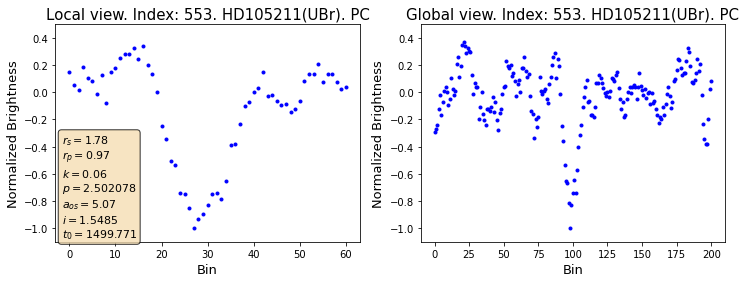

0.99772614 570
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.93152964>, 'k': 0.1113281425355651, 'p': 3.85312214207324, 'a_os': 6.769978524827734, 'i': 1.560313267855812, 't_0': 1517.903729786895}
(201,)
(1, 201)
(61,)


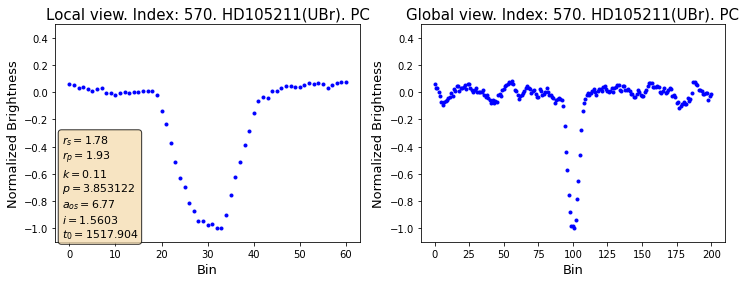

0.99762255 571
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.93152964>, 'k': 0.1113281425355651, 'p': 3.854511030962129, 'a_os': 6.769978524827734, 'i': 1.560313267855812, 't_0': 1517.903729786895}
(201,)
(1, 201)
(61,)


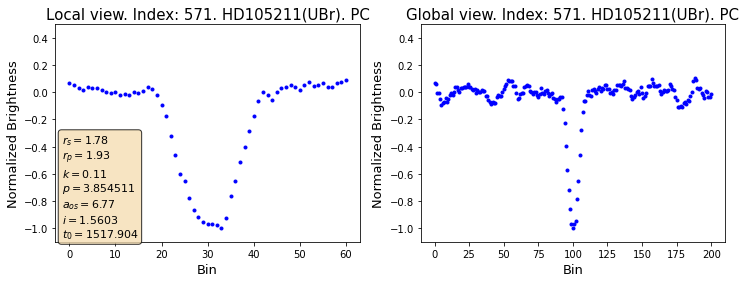

0.9979742 572
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.93152964>, 'k': 0.1113281425355651, 'p': 3.855899919851018, 'a_os': 6.769978524827734, 'i': 1.560313267855812, 't_0': 1517.903729786895}
(201,)
(1, 201)
(61,)


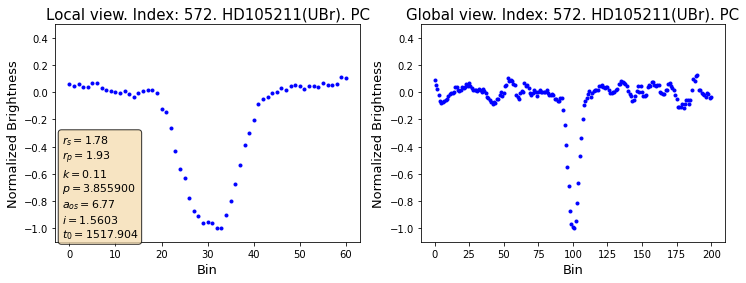

0.753803 628
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 0.97540484>, 'k': 0.0562196959768082, 'p': 2.3764904778840217, 'a_os': 4.904165842336863, 'i': 1.5381088267356642, 't_0': 1508.9082667872158}
(201,)
(1, 201)
(61,)


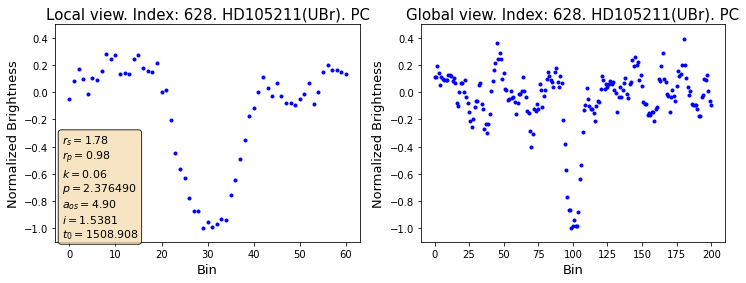

0.83763057 629
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 0.97540484>, 'k': 0.0562196959768082, 'p': 2.377879366772911, 'a_os': 4.904165842336863, 'i': 1.5381088267356642, 't_0': 1508.9082667872158}
(201,)
(1, 201)
(61,)


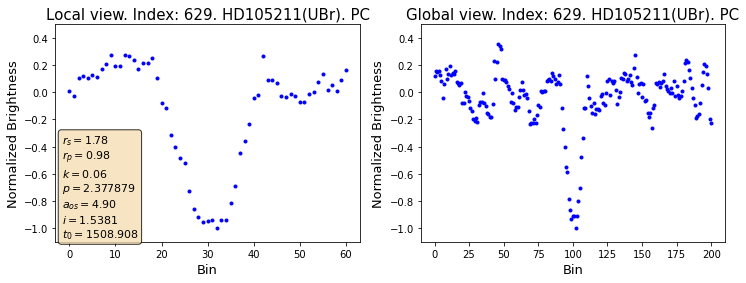

0.996422 646
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.81698633>, 'k': 0.1047261758847808, 'p': 2.291303152788766, 'a_os': 4.7881922360037725, 'i': 1.55060380527611, 't_0': 1480.5265407872234}
(201,)
(1, 201)
(61,)


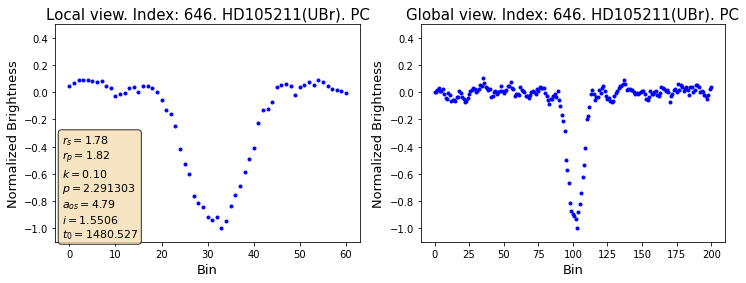

0.9978409 647
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.81698633>, 'k': 0.1047261758847808, 'p': 2.2926920416776557, 'a_os': 4.7881922360037725, 'i': 1.55060380527611, 't_0': 1480.5265407872234}
(201,)
(1, 201)
(61,)


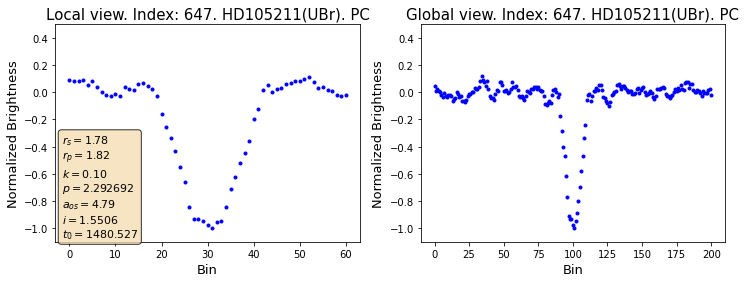

0.99758464 648
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.81698633>, 'k': 0.1047261758847808, 'p': 2.2940809305665444, 'a_os': 4.7881922360037725, 'i': 1.55060380527611, 't_0': 1480.5265407872234}
(201,)
(1, 201)
(61,)


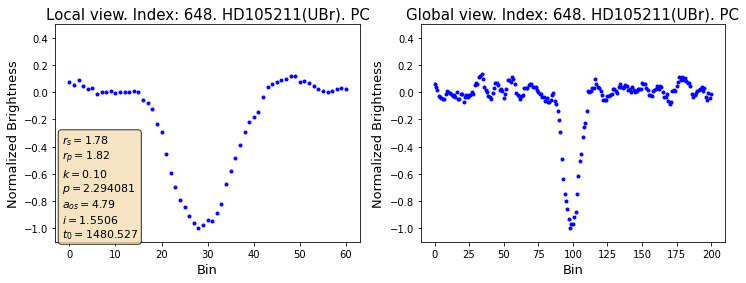

0.9914217 665
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.41468392>, 'k': 0.0815385538566824, 'p': 1.628078110095769, 'a_os': 3.8133336749940367, 'i': 1.564271851247608, 't_0': 1506.74781378711}
(201,)
(1, 201)
(61,)


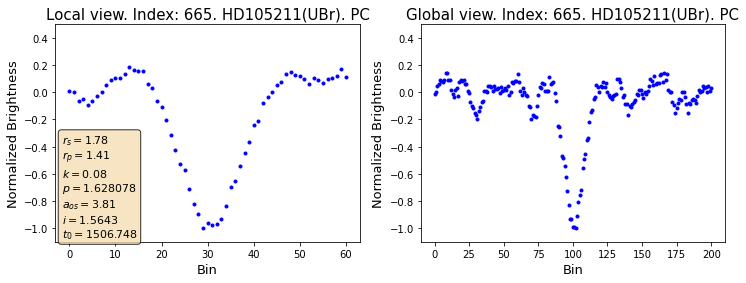

0.99588966 666
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.41468392>, 'k': 0.0815385538566824, 'p': 1.629466998984658, 'a_os': 3.8133336749940367, 'i': 1.564271851247608, 't_0': 1506.74781378711}
(201,)
(1, 201)
(61,)


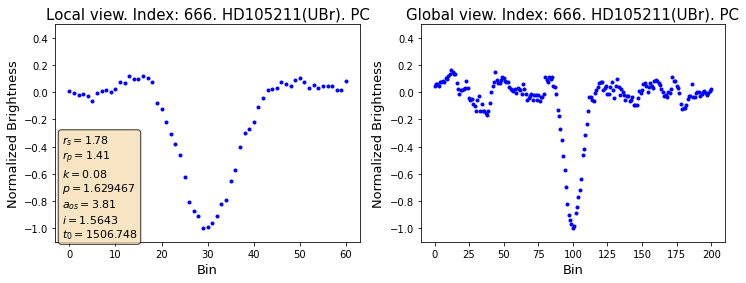

0.9973201 667
{'target': 'HD105211', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.78292, 'r_p': <Quantity 1.41468392>, 'k': 0.0815385538566824, 'p': 1.6308558878735469, 'a_os': 3.8133336749940367, 'i': 1.564271851247608, 't_0': 1506.74781378711}
(201,)
(1, 201)
(61,)


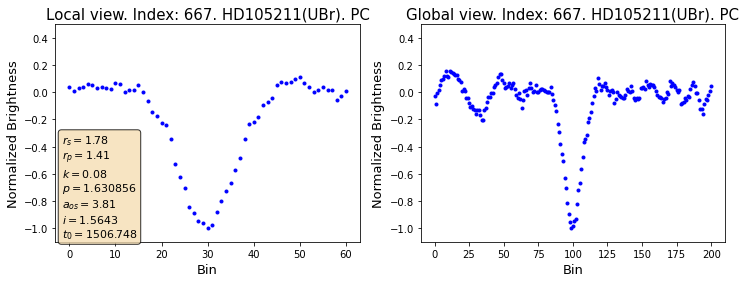

0.9970824 951
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 1.79721555>, 'k': 0.075075892679694, 'p': 1.2364616197726797, 'a_os': 2.505373458960461, 'i': 1.5688210801670763, 't_0': 1582.9641117870656}
(201,)
(1, 201)
(61,)


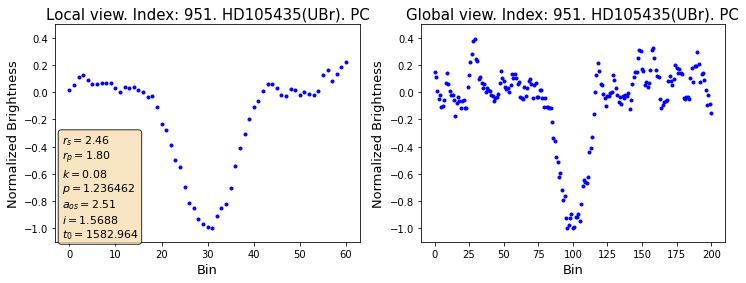

0.9230647 988
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 1.79720307>, 'k': 0.0750753710644738, 'p': 3.852591127914041, 'a_os': 5.345951542353699, 'i': 1.5601011536780018, 't_0': 1500.6778567869064}
(201,)
(1, 201)
(61,)


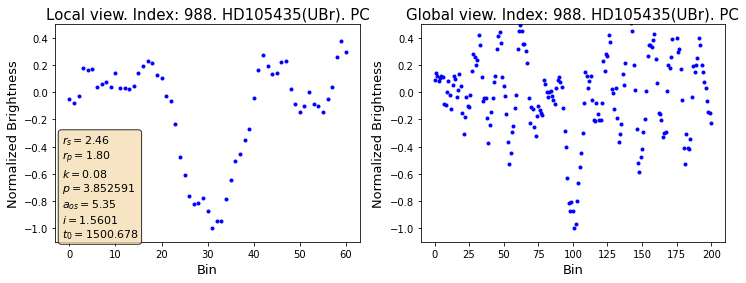

0.9443478 989
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 1.79720307>, 'k': 0.0750753710644738, 'p': 3.8539800168029297, 'a_os': 5.345951542353699, 'i': 1.5601011536780018, 't_0': 1500.6778567869064}
(201,)
(1, 201)
(61,)


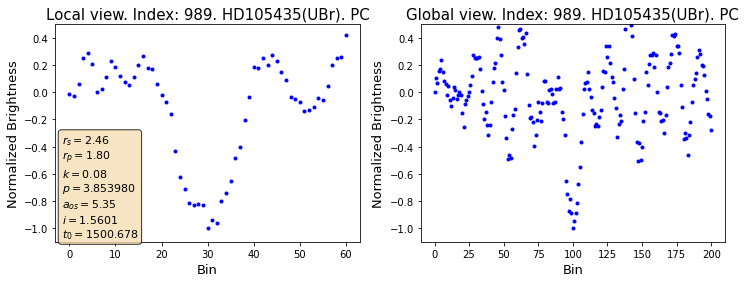

0.8624263 990
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 1.79720307>, 'k': 0.0750753710644738, 'p': 3.855368905691819, 'a_os': 5.345951542353699, 'i': 1.5601011536780018, 't_0': 1500.6778567869064}
(201,)
(1, 201)
(61,)


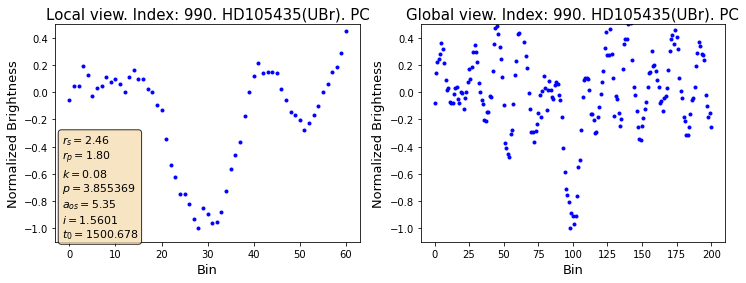

0.96562564 1007
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 2.04513128>, 'k': 0.0854321877255937, 'p': 3.799181638342083, 'a_os': 5.296446335402824, 'i': 1.5532190055239945, 't_0': 1502.7719927870517}
(201,)
(1, 201)
(61,)


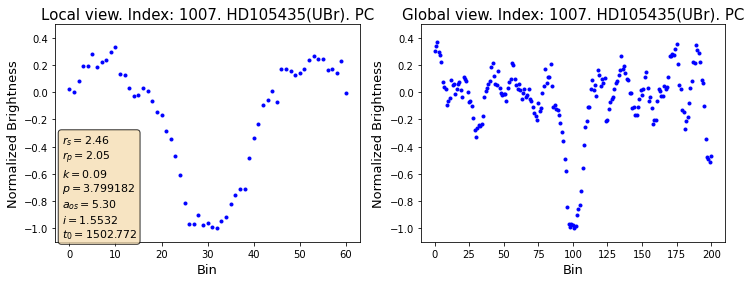

0.99102867 1008
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 2.04513128>, 'k': 0.0854321877255937, 'p': 3.800570527230972, 'a_os': 5.296446335402824, 'i': 1.5532190055239945, 't_0': 1502.7719927870517}
(201,)
(1, 201)
(61,)


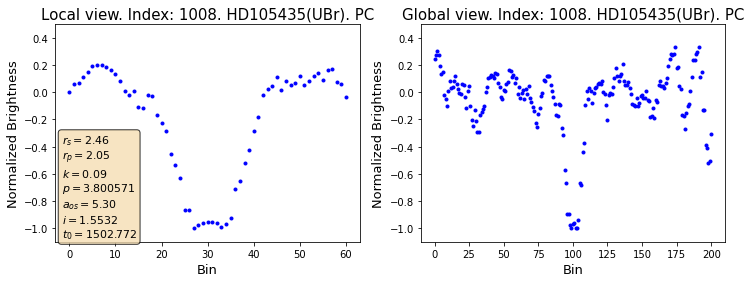

0.9940492 1009
{'target': 'HD105435', 'satellite': 'UBr', 'label': 'PC', 'r_s': 2.46, 'r_p': <Quantity 2.04513128>, 'k': 0.0854321877255937, 'p': 3.801959416119861, 'a_os': 5.296446335402824, 'i': 1.5532190055239945, 't_0': 1502.7719927870517}
(201,)
(1, 201)
(61,)


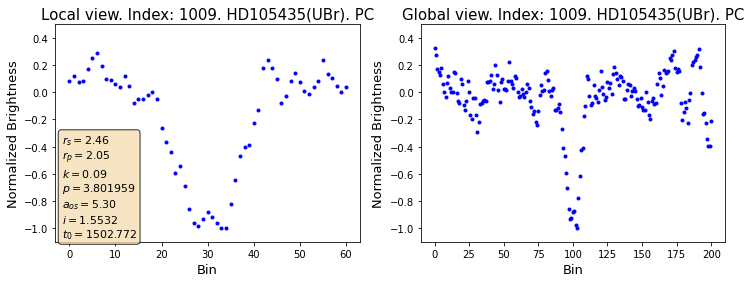

0.99409705 1026
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.66037824>, 'k': 0.1741070670475829, 'p': 4.793785595246756, 'a_os': 12.14530088325759, 'i': 1.5370964528939195, 't_0': 1484.2942027871345}
(201,)
(1, 201)
(61,)


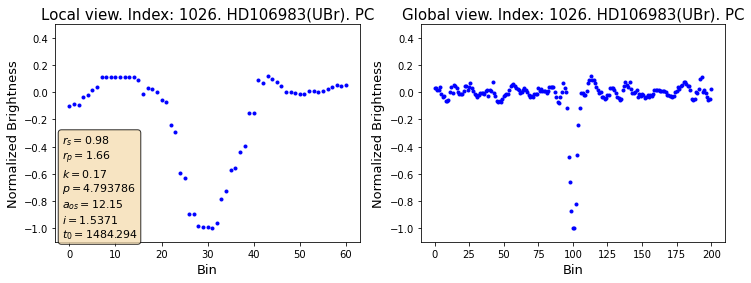

0.99316037 1027
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.66037824>, 'k': 0.1741070670475829, 'p': 4.795174484135645, 'a_os': 12.14530088325759, 'i': 1.5370964528939195, 't_0': 1484.2942027871345}
(201,)
(1, 201)
(61,)


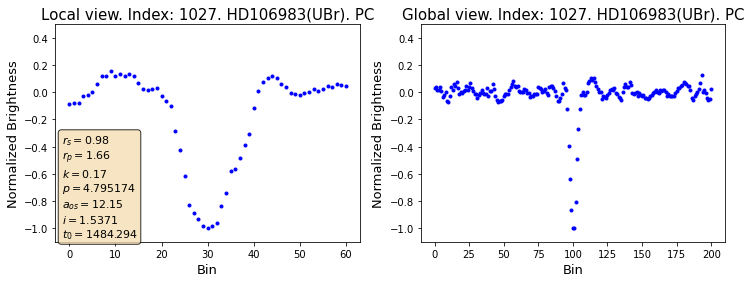

0.98256415 1028
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.66037824>, 'k': 0.1741070670475829, 'p': 4.796563373024534, 'a_os': 12.14530088325759, 'i': 1.5370964528939195, 't_0': 1484.2942027871345}
(201,)
(1, 201)
(61,)


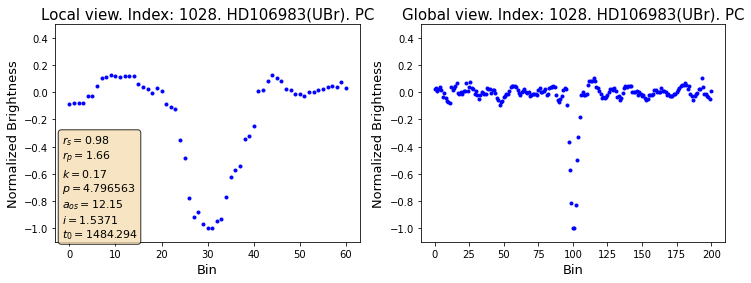

0.9876696 1045
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.8916215>, 'k': 0.1983552087746848, 'p': 3.968194463459627, 'a_os': 10.70784194986371, 'i': 1.5647946965226176, 't_0': 1457.6539567869936}
(201,)
(1, 201)
(61,)


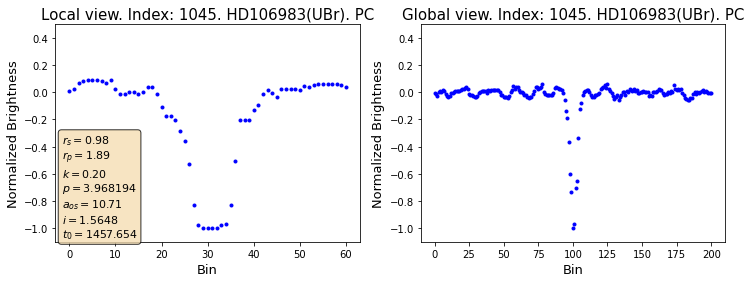

0.9915133 1046
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.8916215>, 'k': 0.1983552087746848, 'p': 3.969583352348516, 'a_os': 10.70784194986371, 'i': 1.5647946965226176, 't_0': 1457.6539567869936}
(201,)
(1, 201)
(61,)


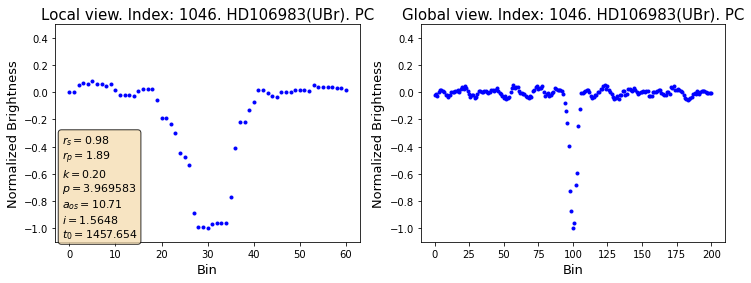

0.9843295 1047
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.8916215>, 'k': 0.1983552087746848, 'p': 3.970972241237405, 'a_os': 10.70784194986371, 'i': 1.5647946965226176, 't_0': 1457.6539567869936}
(201,)
(1, 201)
(61,)


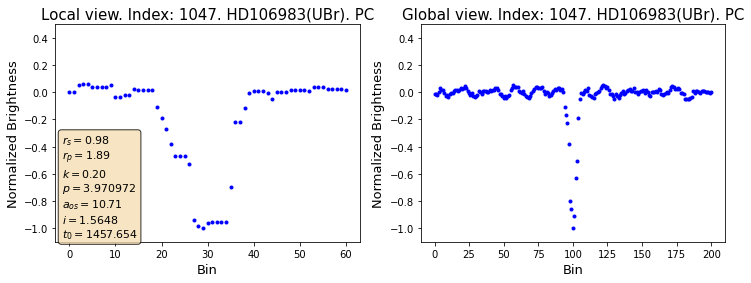

0.9978934 1064
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.76848982>, 'k': 0.1854436350450794, 'p': 2.2180544069844434, 'a_os': 7.267215481930337, 'i': 1.563057131026382, 't_0': 1485.2028277868253}
(201,)
(1, 201)
(61,)


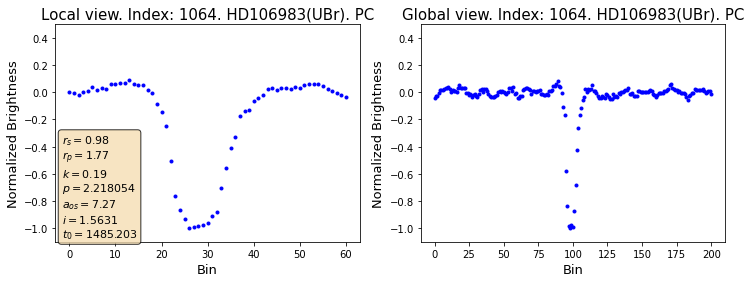

0.997642 1065
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.76848982>, 'k': 0.1854436350450794, 'p': 2.219443295873333, 'a_os': 7.267215481930337, 'i': 1.563057131026382, 't_0': 1485.2028277868253}
(201,)
(1, 201)
(61,)


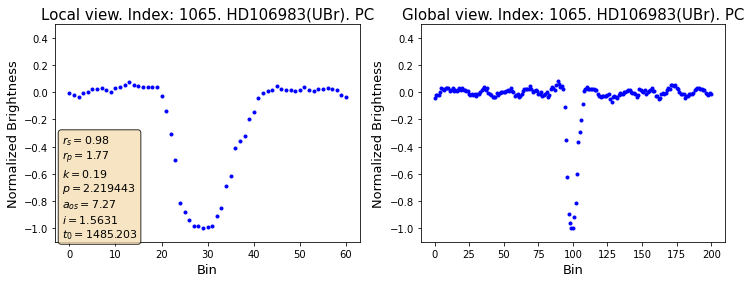

0.9978927 1066
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.76848982>, 'k': 0.1854436350450794, 'p': 2.2208321847622217, 'a_os': 7.267215481930337, 'i': 1.563057131026382, 't_0': 1485.2028277868253}
(201,)
(1, 201)
(61,)


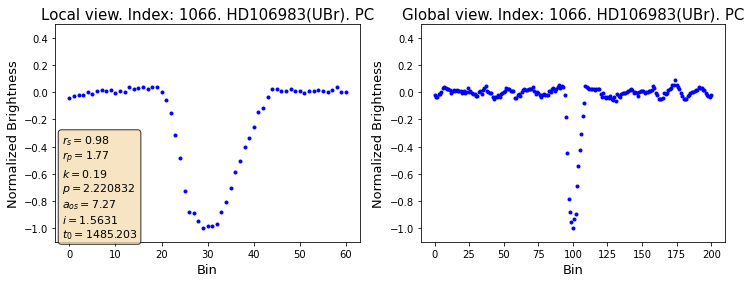

0.9868133 1083
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.29343114>, 'k': 0.1356290378470882, 'p': 3.967870143476934, 'a_os': 10.707258712430864, 'i': 1.5675396498577578, 't_0': 1454.94105878685}
(201,)
(1, 201)
(61,)


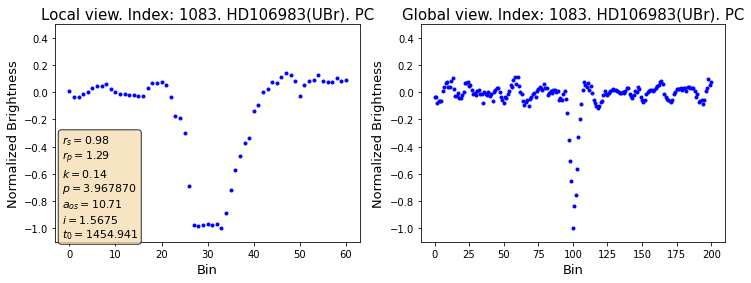

0.9770753 1084
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.29343114>, 'k': 0.1356290378470882, 'p': 3.969259032365823, 'a_os': 10.707258712430864, 'i': 1.5675396498577578, 't_0': 1454.94105878685}
(201,)
(1, 201)
(61,)


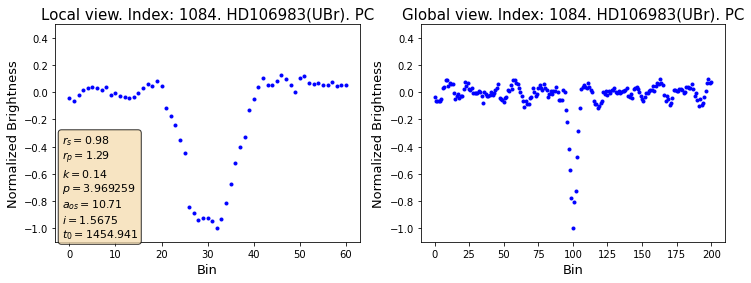

0.96513 1085
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.29343114>, 'k': 0.1356290378470882, 'p': 3.970647921254712, 'a_os': 10.707258712430864, 'i': 1.5675396498577578, 't_0': 1454.94105878685}
(201,)
(1, 201)
(61,)


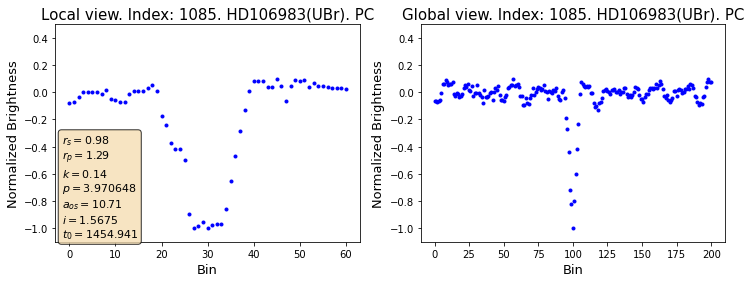

0.65717196 1103
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 0.78737211>, 'k': 0.0825637474172537, 'p': 2.877283543949426, 'a_os': 8.640265937914156, 'i': 1.5412764661392533, 't_0': 1493.5003517868777}
(201,)
(1, 201)
(61,)


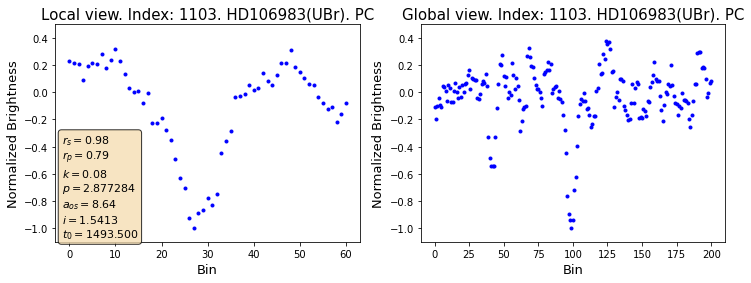

0.6904315 1104
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 0.78737211>, 'k': 0.0825637474172537, 'p': 2.8786724328383158, 'a_os': 8.640265937914156, 'i': 1.5412764661392533, 't_0': 1493.5003517868777}
(201,)
(1, 201)
(61,)


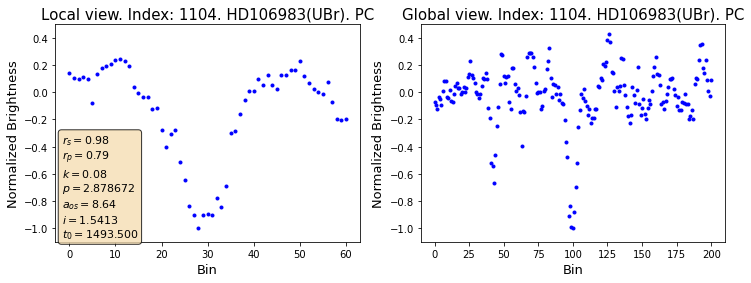

0.96227556 1140
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.9034913>, 'k': 0.1995998749104328, 'p': 4.045604347661689, 'a_os': 10.846600741822138, 'i': 1.5557494814671349, 't_0': 1458.0070727870648}
(201,)
(1, 201)
(61,)


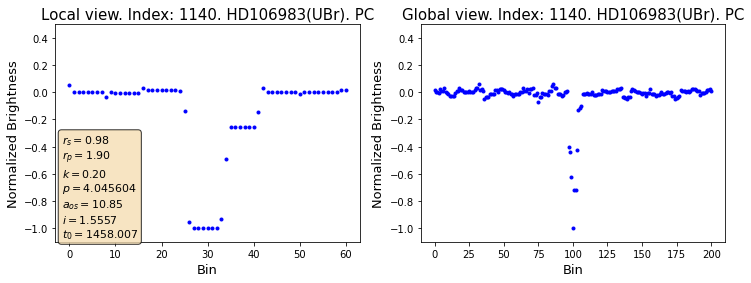

0.98852956 1141
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.9034913>, 'k': 0.1995998749104328, 'p': 4.046993236550578, 'a_os': 10.846600741822138, 'i': 1.5557494814671349, 't_0': 1458.0070727870648}
(201,)
(1, 201)
(61,)


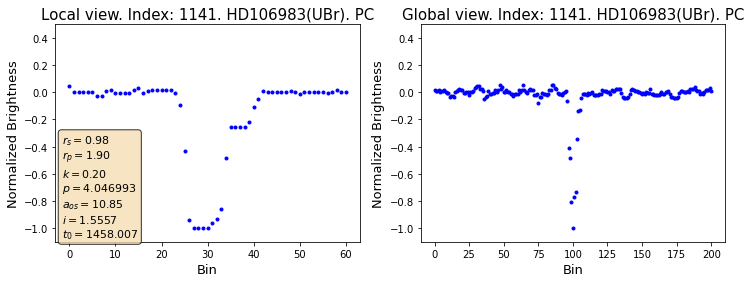

0.9905442 1142
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.9034913>, 'k': 0.1995998749104328, 'p': 4.048382125439467, 'a_os': 10.846600741822138, 'i': 1.5557494814671349, 't_0': 1458.0070727870648}
(201,)
(1, 201)
(61,)


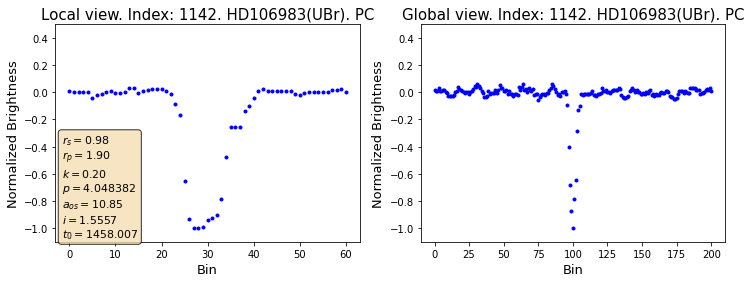

0.9955091 1178
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.73974746>, 'k': 0.182429714170313, 'p': 4.121143948138633, 'a_os': 10.981156582639247, 'i': 1.5601571122376827, 't_0': 1495.661771787129}
(201,)
(1, 201)
(61,)


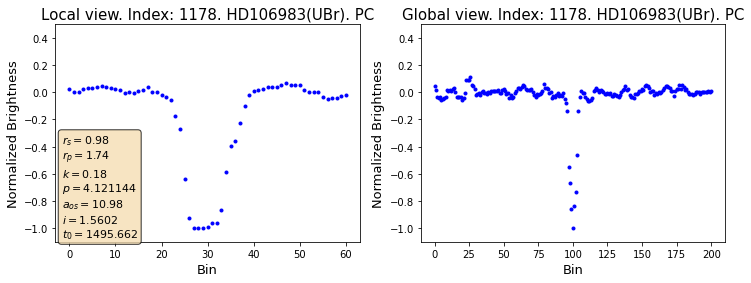

0.99683666 1179
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.73974746>, 'k': 0.182429714170313, 'p': 4.1225328370275225, 'a_os': 10.981156582639247, 'i': 1.5601571122376827, 't_0': 1495.661771787129}
(201,)
(1, 201)
(61,)


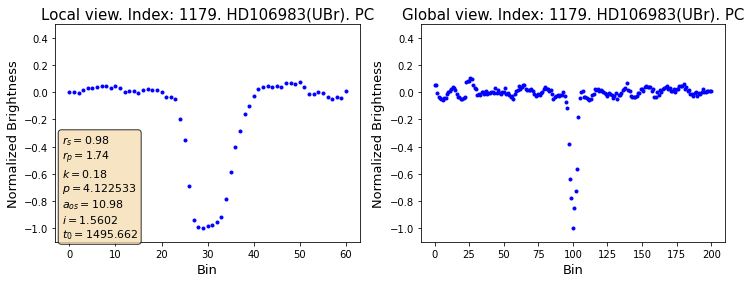

0.9967772 1180
{'target': 'HD106983', 'satellite': 'UBr', 'label': 'PC', 'r_s': 0.98, 'r_p': <Quantity 1.73974746>, 'k': 0.182429714170313, 'p': 4.123921725916412, 'a_os': 10.981156582639247, 'i': 1.5601571122376827, 't_0': 1495.661771787129}
(201,)
(1, 201)
(61,)


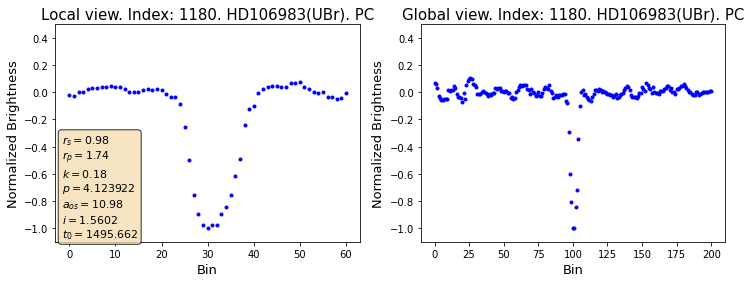

0.99471337 1197
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.69511465>, 'k': 0.1043081034176797, 'p': 2.440342242954823, 'a_os': 5.238950224154387, 'i': 1.5618210608258052, 't_0': 1467.189963787127}
(201,)
(1, 201)
(61,)


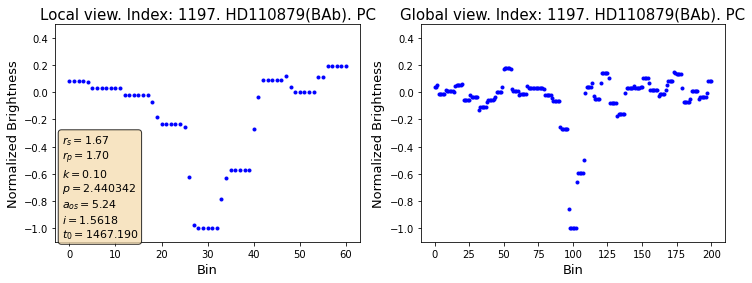

0.99800354 1198
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.69511465>, 'k': 0.1043081034176797, 'p': 2.4417311318437123, 'a_os': 5.238950224154387, 'i': 1.5618210608258052, 't_0': 1467.189963787127}
(201,)
(1, 201)
(61,)


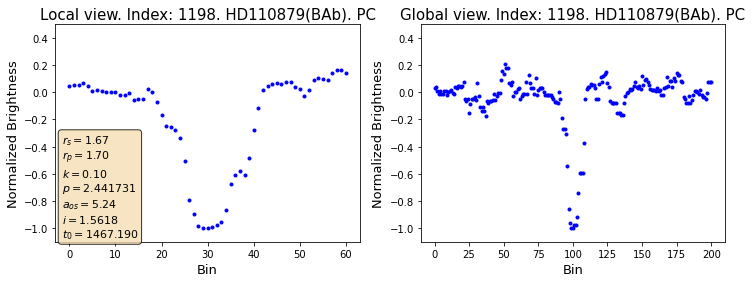

0.99839324 1199
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.69511465>, 'k': 0.1043081034176797, 'p': 2.4431200207326014, 'a_os': 5.238950224154387, 'i': 1.5618210608258052, 't_0': 1467.189963787127}
(201,)
(1, 201)
(61,)


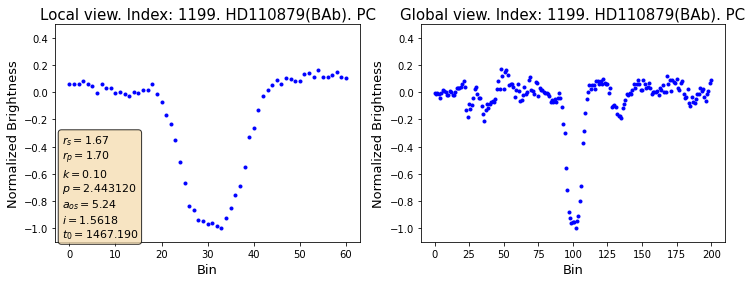

0.9973871 1216
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.07021208>, 'k': 0.1273895520449164, 'p': 1.8887902993500207, 'a_os': 4.416867419203678, 'i': 1.5418467538816214, 't_0': 1464.603843787018}
(201,)
(1, 201)
(61,)


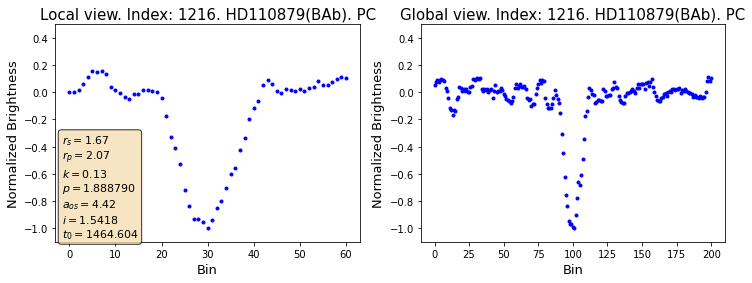

0.99676013 1217
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.07021208>, 'k': 0.1273895520449164, 'p': 1.8901791882389096, 'a_os': 4.416867419203678, 'i': 1.5418467538816214, 't_0': 1464.603843787018}
(201,)
(1, 201)
(61,)


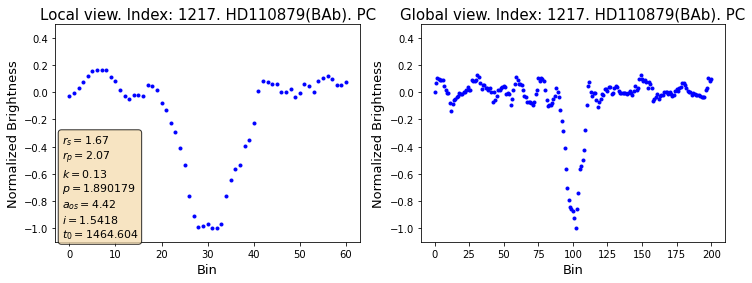

0.9962656 1218
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.07021208>, 'k': 0.1273895520449164, 'p': 1.8915680771277985, 'a_os': 4.416867419203678, 'i': 1.5418467538816214, 't_0': 1464.603843787018}
(201,)
(1, 201)
(61,)


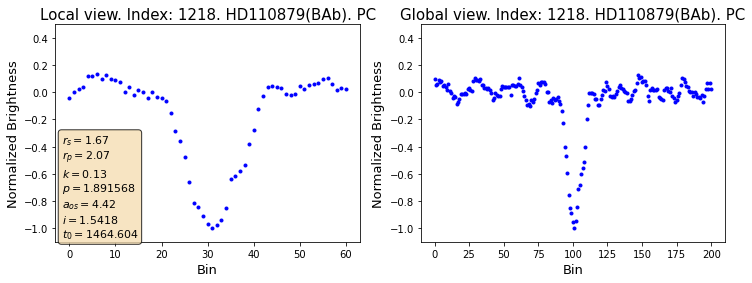

0.99125725 1235
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.79257277>, 'k': 0.1103051444523272, 'p': 4.544675200171255, 'a_os': 7.928713915376829, 'i': 1.5583526402919794, 't_0': 1466.3504397871752}
(201,)
(1, 201)
(61,)


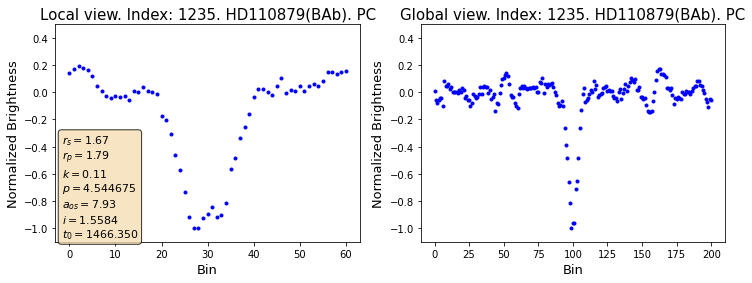

0.9904262 1236
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.79257277>, 'k': 0.1103051444523272, 'p': 4.5460640890601445, 'a_os': 7.928713915376829, 'i': 1.5583526402919794, 't_0': 1466.3504397871752}
(201,)
(1, 201)
(61,)


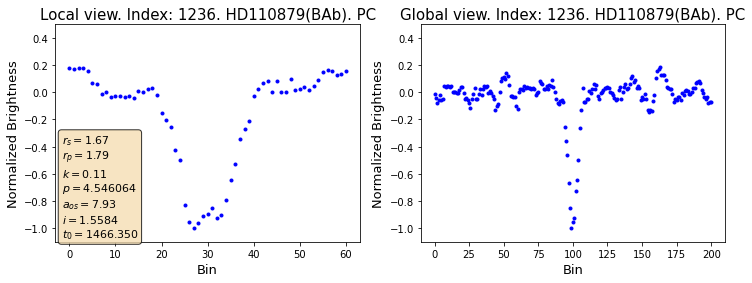

0.990588 1237
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.79257277>, 'k': 0.1103051444523272, 'p': 4.547452977949034, 'a_os': 7.928713915376829, 'i': 1.5583526402919794, 't_0': 1466.3504397871752}
(201,)
(1, 201)
(61,)


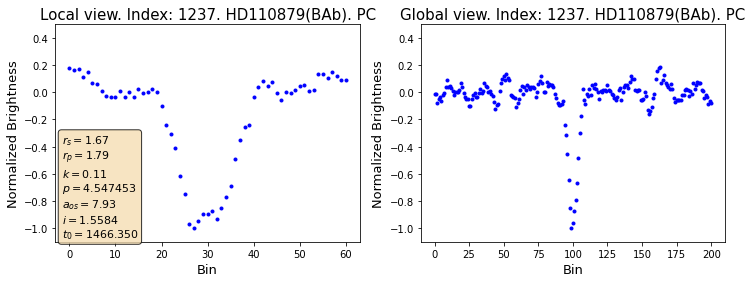

0.9986135 1254
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.80499004>, 'k': 0.1110692351808393, 'p': 3.4503138414749186, 'a_os': 6.598845636920281, 'i': 1.560562725066331, 't_0': 1480.0175351572752}
(201,)
(1, 201)
(61,)


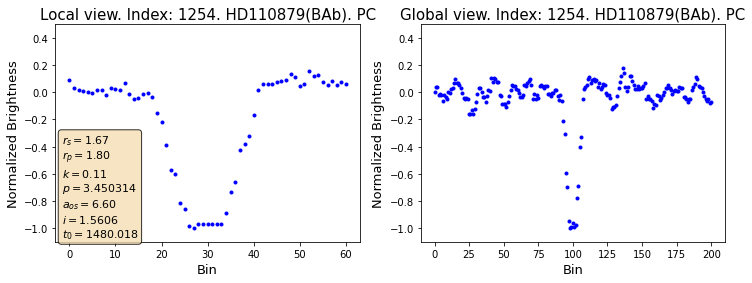

0.99859387 1255
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.80499004>, 'k': 0.1110692351808393, 'p': 3.451702730363808, 'a_os': 6.598845636920281, 'i': 1.560562725066331, 't_0': 1480.0175351572752}
(201,)
(1, 201)
(61,)


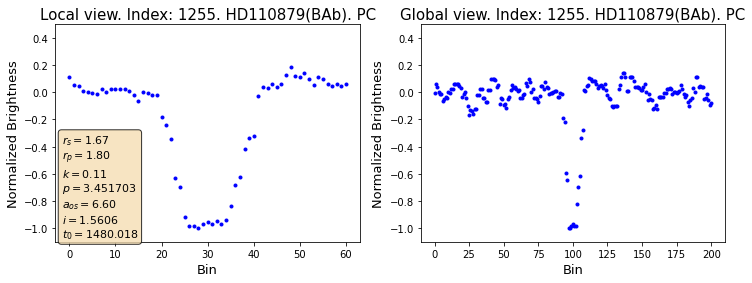

0.9980109 1256
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.80499004>, 'k': 0.1110692351808393, 'p': 3.453091619252697, 'a_os': 6.598845636920281, 'i': 1.560562725066331, 't_0': 1480.0175351572752}
(201,)
(1, 201)
(61,)


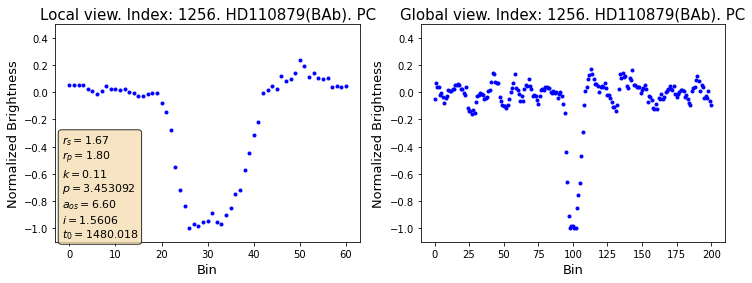

0.9545104 1273
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.66505394>, 'k': 0.1024583312850994, 'p': 4.2814819236223, 'a_os': 7.619661790321373, 'i': 1.5426315674906166, 't_0': 1443.4821717872132}
(201,)
(1, 201)
(61,)


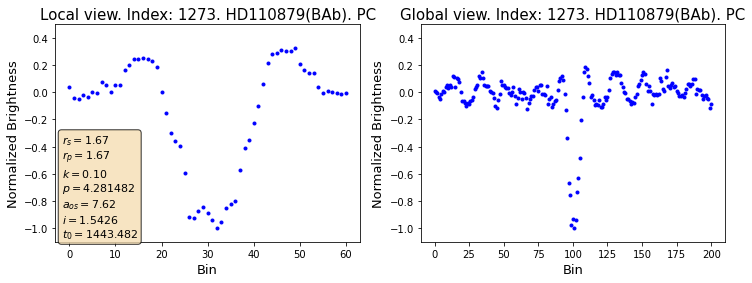

0.93059844 1274
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.66505394>, 'k': 0.1024583312850994, 'p': 4.282870812511189, 'a_os': 7.619661790321373, 'i': 1.5426315674906166, 't_0': 1443.4821717872132}
(201,)
(1, 201)
(61,)


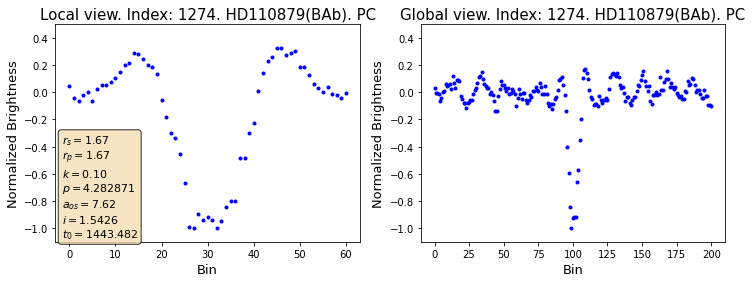

0.8871394 1275
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.66505394>, 'k': 0.1024583312850994, 'p': 4.284259701400078, 'a_os': 7.619661790321373, 'i': 1.5426315674906166, 't_0': 1443.4821717872132}
(201,)
(1, 201)
(61,)


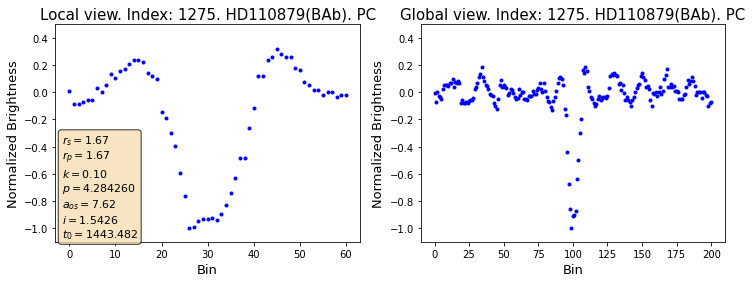

0.9972657 1292
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.02351825>, 'k': 0.1245162686092008, 'p': 1.9127331226173447, 'a_os': 4.454087969295299, 'i': 1.5514065665674417, 't_0': 1430.302755786836}
(201,)
(1, 201)
(61,)


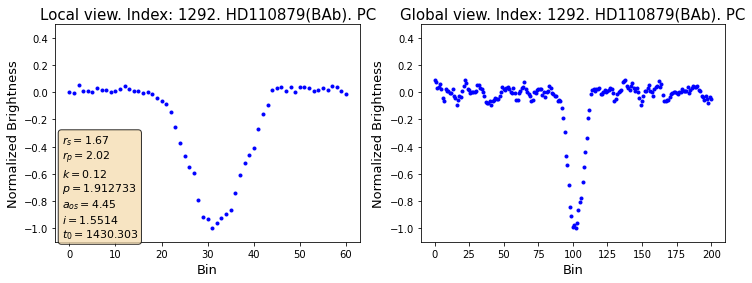

0.9983534 1293
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.02351825>, 'k': 0.1245162686092008, 'p': 1.914122011506234, 'a_os': 4.454087969295299, 'i': 1.5514065665674417, 't_0': 1430.302755786836}
(201,)
(1, 201)
(61,)


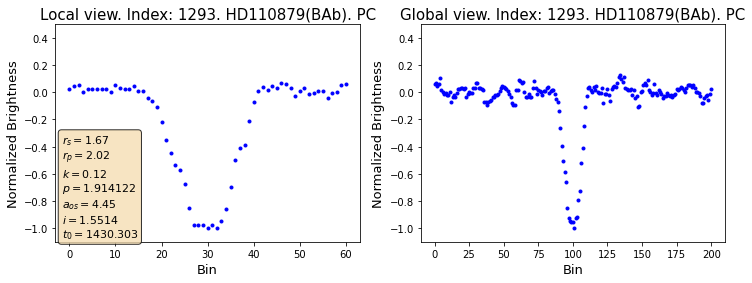

0.99809164 1294
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.02351825>, 'k': 0.1245162686092008, 'p': 1.915510900395123, 'a_os': 4.454087969295299, 'i': 1.5514065665674417, 't_0': 1430.302755786836}
(201,)
(1, 201)
(61,)


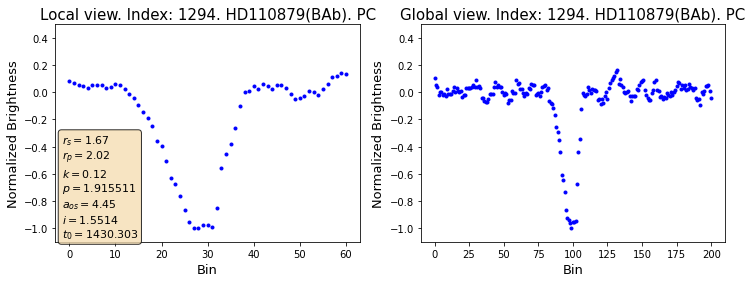

0.9848001 1312
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.38031632>, 'k': 0.0849371325473185, 'p': 1.6111658490497325, 'a_os': 3.970749992640435, 'i': 1.5445006354805024, 't_0': 1500.792785157223}
(201,)
(1, 201)
(61,)


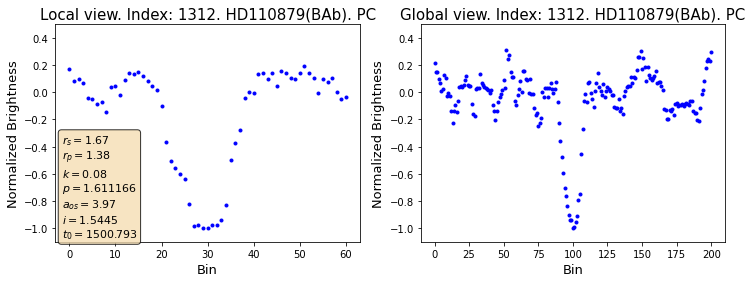

0.8549803 1313
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.38031632>, 'k': 0.0849371325473185, 'p': 1.6125547379386214, 'a_os': 3.970749992640435, 'i': 1.5445006354805024, 't_0': 1500.792785157223}
(201,)
(1, 201)
(61,)


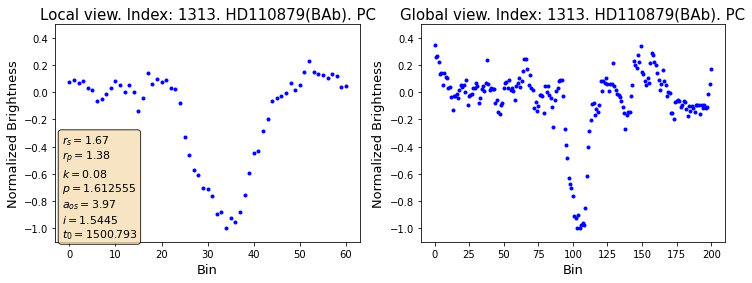

0.98640364 1330
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.88019003>, 'k': 0.1156966321149804, 'p': 4.879252749824926, 'a_os': 8.31311252428571, 'i': 1.5596418872040418, 't_0': 1452.819606786858}
(201,)
(1, 201)
(61,)


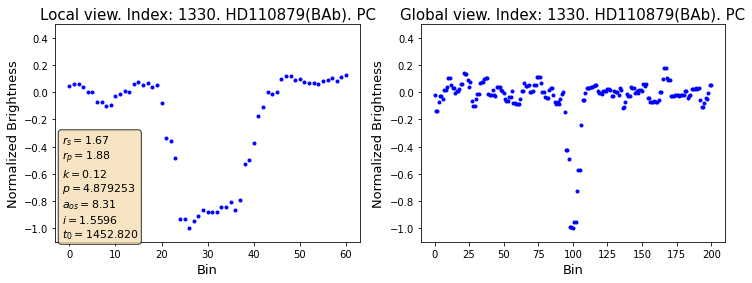

0.9859579 1331
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.88019003>, 'k': 0.1156966321149804, 'p': 4.880641638713815, 'a_os': 8.31311252428571, 'i': 1.5596418872040418, 't_0': 1452.819606786858}
(201,)
(1, 201)
(61,)


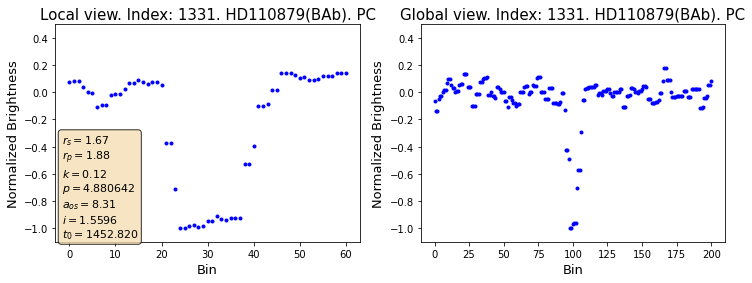

0.9927092 1332
{'target': 'HD110879', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.88019003>, 'k': 0.1156966321149804, 'p': 4.882030527602704, 'a_os': 8.31311252428571, 'i': 1.5596418872040418, 't_0': 1452.819606786858}
(201,)
(1, 201)
(61,)


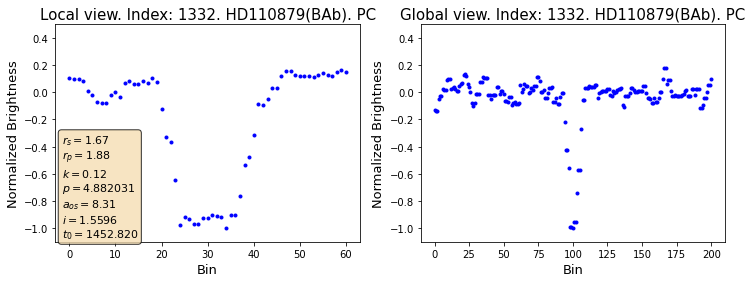

0.9515974 1368
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.01001525>, 'k': 0.0621508258024567, 'p': 3.374831532341738, 'a_os': 6.502288580173941, 'i': 1.5526813803834003, 't_0': 1450.5536667870206}
(201,)
(1, 201)
(61,)


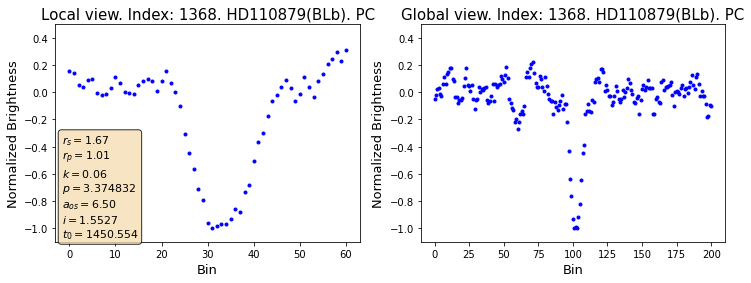

0.995523 1369
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.01001525>, 'k': 0.0621508258024567, 'p': 3.3762204212306277, 'a_os': 6.502288580173941, 'i': 1.5526813803834003, 't_0': 1450.5536667870206}
(201,)
(1, 201)
(61,)


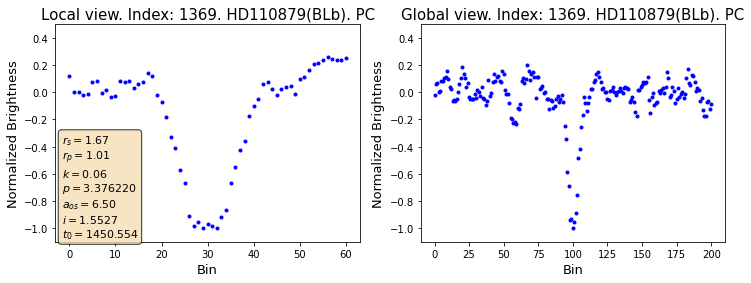

0.99444366 1370
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.01001525>, 'k': 0.0621508258024567, 'p': 3.3776093101195164, 'a_os': 6.502288580173941, 'i': 1.5526813803834003, 't_0': 1450.5536667870206}
(201,)
(1, 201)
(61,)


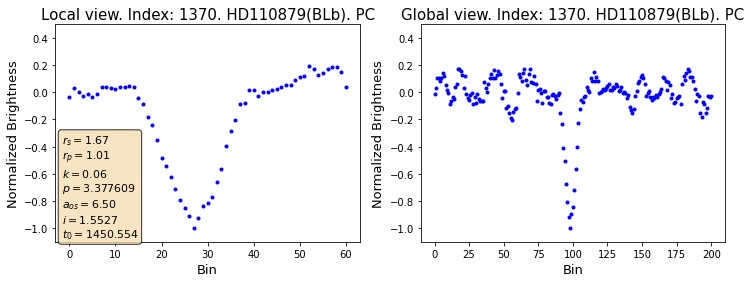

0.7080103 1388
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 0.90468972>, 'k': 0.0556696672580695, 'p': 1.9850599676918528, 'a_os': 4.563465791155192, 'i': 1.5539726605581434, 't_0': 1442.3105677871813}
(201,)
(1, 201)
(61,)


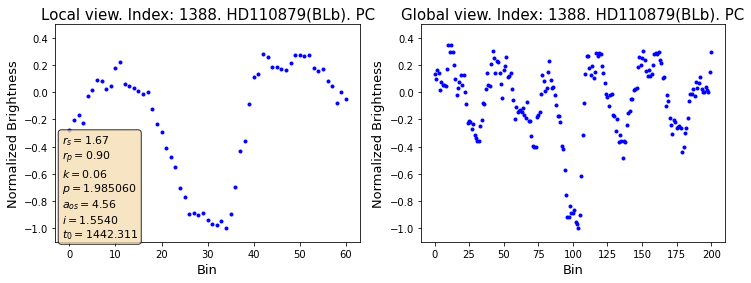

0.9972815 1406
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.34203956>, 'k': 0.0825817896367388, 'p': 4.3768952841252, 'a_os': 7.732412411814655, 'i': 1.5463199697123626, 't_0': 1564.0528227871132}
(201,)
(1, 201)
(61,)


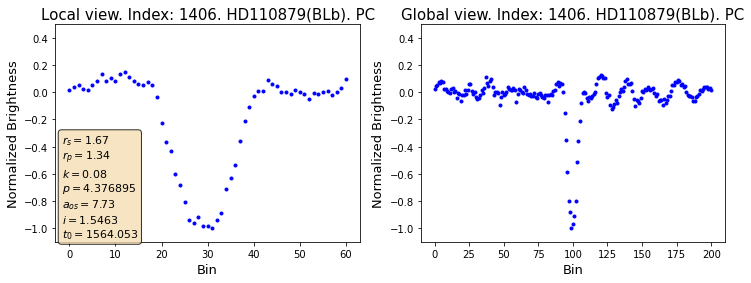

0.9982645 1407
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.34203956>, 'k': 0.0825817896367388, 'p': 4.378284173014089, 'a_os': 7.732412411814655, 'i': 1.5463199697123626, 't_0': 1564.0528227871132}
(201,)
(1, 201)
(61,)


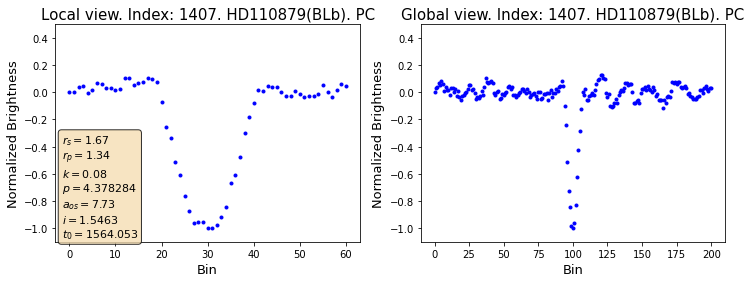

0.99823296 1408
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.34203956>, 'k': 0.0825817896367388, 'p': 4.379673061902978, 'a_os': 7.732412411814655, 'i': 1.5463199697123626, 't_0': 1564.0528227871132}
(201,)
(1, 201)
(61,)


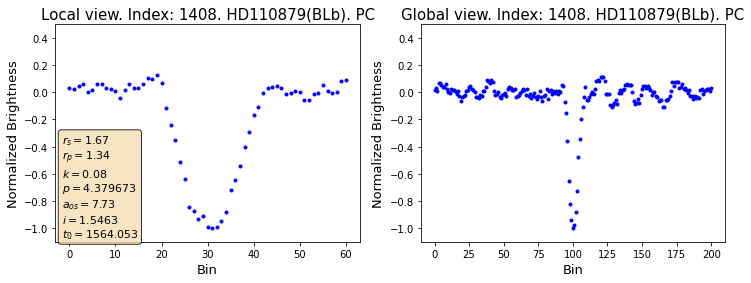

0.9974551 1425
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.55379991>, 'k': 0.0956123658055205, 'p': 3.3941170208045603, 'a_os': 6.527026445601099, 'i': 1.5552582823291836, 't_0': 1573.5369317869504}
(201,)
(1, 201)
(61,)


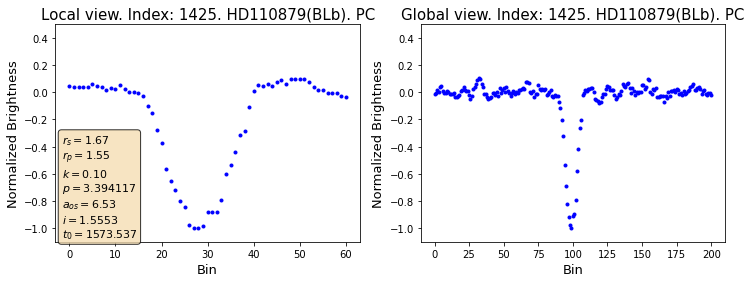

0.9983084 1426
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.55379991>, 'k': 0.0956123658055205, 'p': 3.395505909693449, 'a_os': 6.527026445601099, 'i': 1.5552582823291836, 't_0': 1573.5369317869504}
(201,)
(1, 201)
(61,)


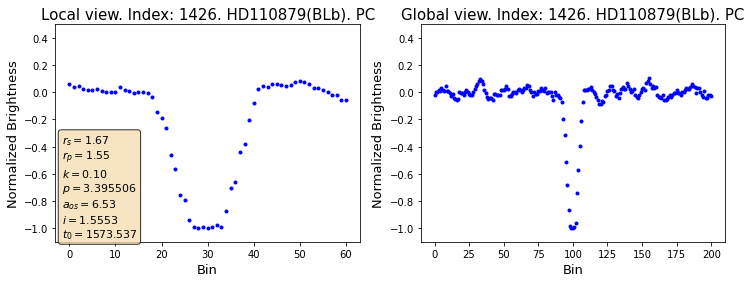

0.9978721 1427
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.55379991>, 'k': 0.0956123658055205, 'p': 3.3968947985823386, 'a_os': 6.527026445601099, 'i': 1.5552582823291836, 't_0': 1573.5369317869504}
(201,)
(1, 201)
(61,)


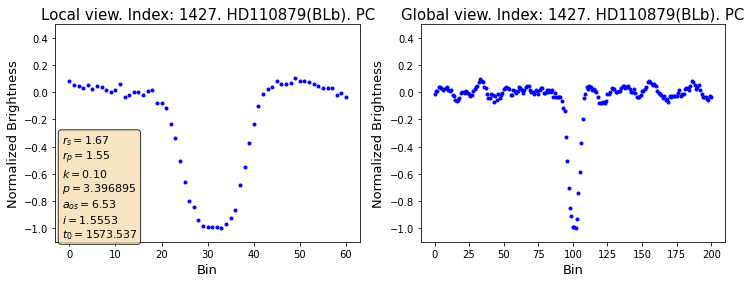

0.9973201 1444
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.43599322>, 'k': 0.0883631849018642, 'p': 2.6885305632493632, 'a_os': 5.588199415676079, 'i': 1.5372601921534927, 't_0': 1565.7198627868515}
(201,)
(1, 201)
(61,)


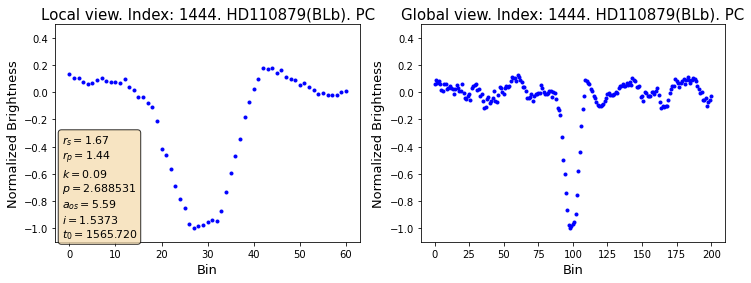

0.9979947 1445
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.43599322>, 'k': 0.0883631849018642, 'p': 2.6899194521382523, 'a_os': 5.588199415676079, 'i': 1.5372601921534927, 't_0': 1565.7198627868515}
(201,)
(1, 201)
(61,)


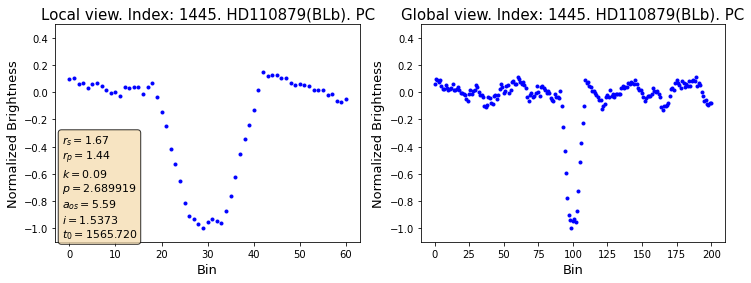

0.9979358 1446
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.43599322>, 'k': 0.0883631849018642, 'p': 2.691308341027141, 'a_os': 5.588199415676079, 'i': 1.5372601921534927, 't_0': 1565.7198627868515}
(201,)
(1, 201)
(61,)


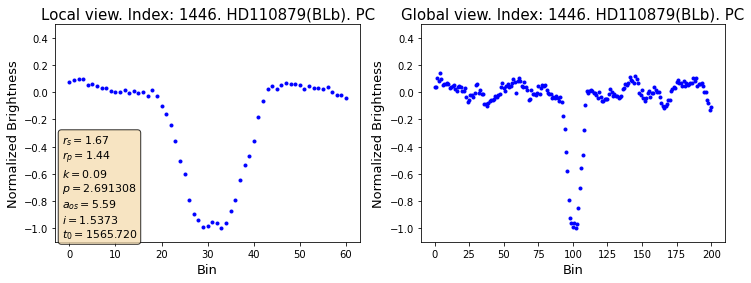

0.9988965 1463
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.09768417>, 'k': 0.1290800346327188, 'p': 1.9547152996082864, 'a_os': 4.518979458743253, 'i': 1.5373095234706526, 't_0': 1534.1694797871482}
(201,)
(1, 201)
(61,)


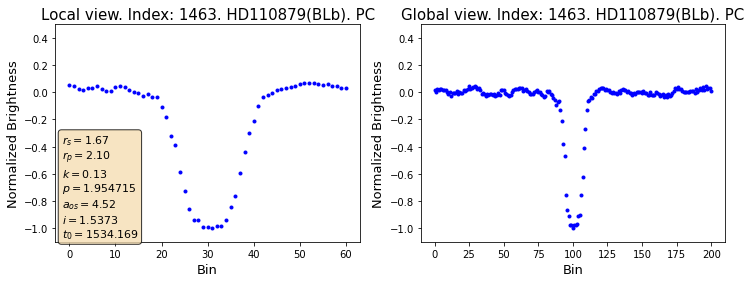

0.9991486 1464
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.09768417>, 'k': 0.1290800346327188, 'p': 1.9561041884971757, 'a_os': 4.518979458743253, 'i': 1.5373095234706526, 't_0': 1534.1694797871482}
(201,)
(1, 201)
(61,)


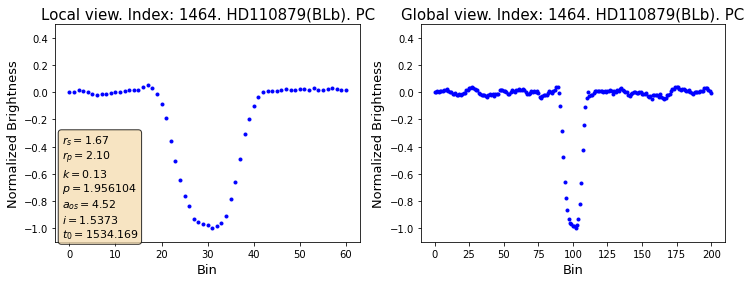

0.9987814 1465
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 2.09768417>, 'k': 0.1290800346327188, 'p': 1.9574930773860644, 'a_os': 4.518979458743253, 'i': 1.5373095234706526, 't_0': 1534.1694797871482}
(201,)
(1, 201)
(61,)


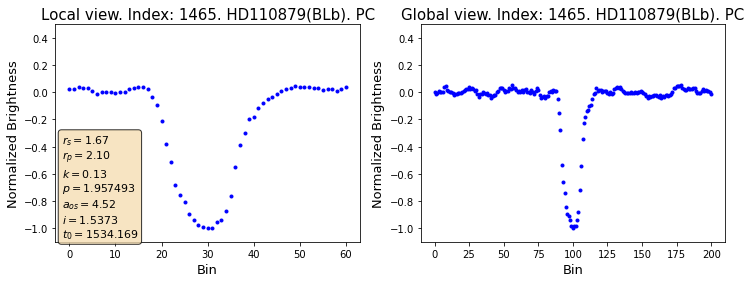

0.99852645 1482
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52390742>, 'k': 0.0937729452303781, 'p': 3.3899258293440533, 'a_os': 6.521654315680657, 'i': 1.5514161196185166, 't_0': 1575.4629667869615}
(201,)
(1, 201)
(61,)


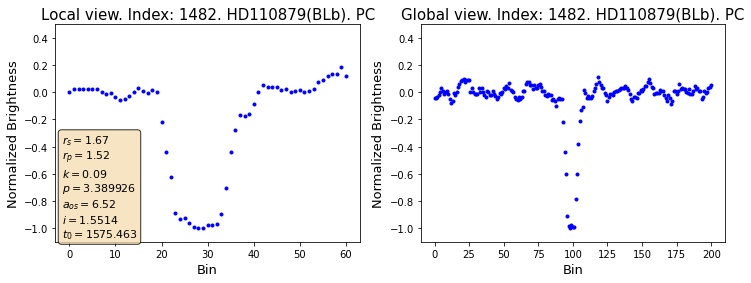

0.9980375 1483
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52390742>, 'k': 0.0937729452303781, 'p': 3.3913147182329424, 'a_os': 6.521654315680657, 'i': 1.5514161196185166, 't_0': 1575.4629667869615}
(201,)
(1, 201)
(61,)


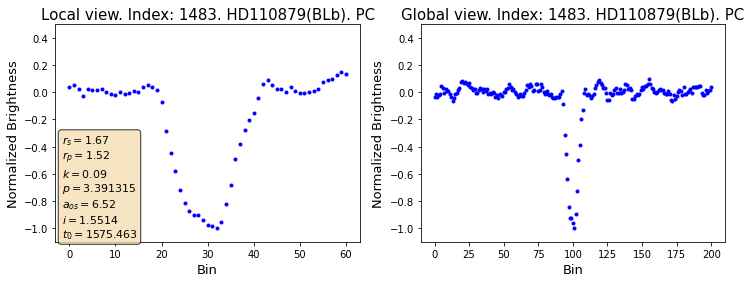

0.99695915 1484
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52390742>, 'k': 0.0937729452303781, 'p': 3.3927036071218315, 'a_os': 6.521654315680657, 'i': 1.5514161196185166, 't_0': 1575.4629667869615}
(201,)
(1, 201)
(61,)


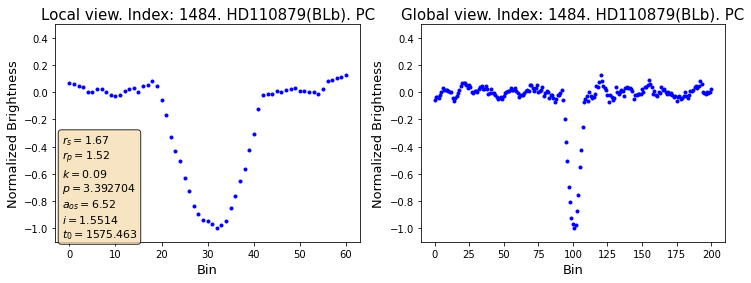

0.9899136 1501
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.56396992>, 'k': 0.0962381726404126, 'p': 4.526869574545265, 'a_os': 7.907997382402305, 'i': 1.5476418940673171, 't_0': 1449.8579657872056}
(201,)
(1, 201)
(61,)


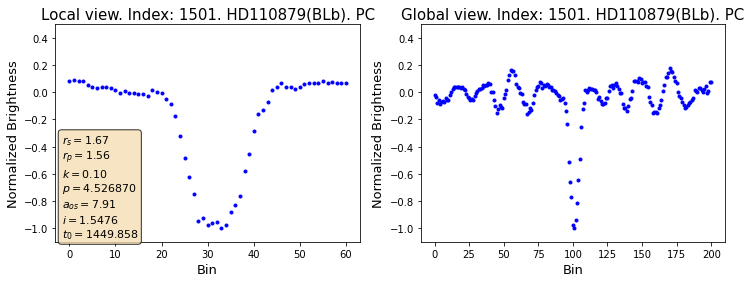

0.9958829 1502
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.56396992>, 'k': 0.0962381726404126, 'p': 4.528258463434154, 'a_os': 7.907997382402305, 'i': 1.5476418940673171, 't_0': 1449.8579657872056}
(201,)
(1, 201)
(61,)


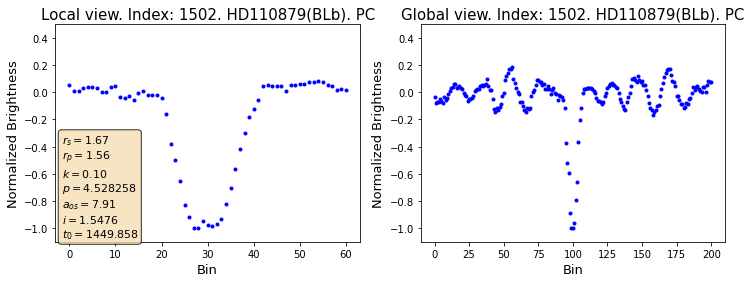

0.9867255 1503
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.56396992>, 'k': 0.0962381726404126, 'p': 4.529647352323043, 'a_os': 7.907997382402305, 'i': 1.5476418940673171, 't_0': 1449.8579657872056}
(201,)
(1, 201)
(61,)


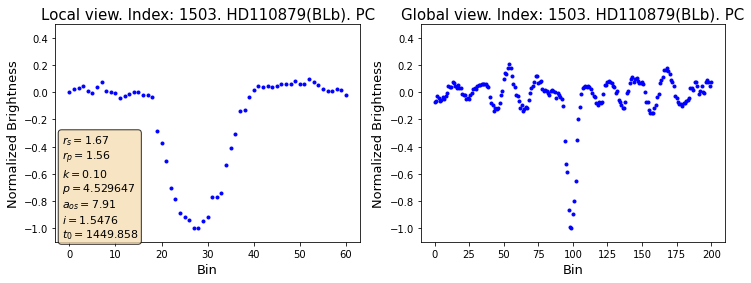

0.9991518 1520
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.96934439>, 'k': 0.1211827048099275, 'p': 3.046190636278911, 'a_os': 6.07317426889043, 'i': 1.5517313038438043, 't_0': 1540.957818786878}
(201,)
(1, 201)
(61,)


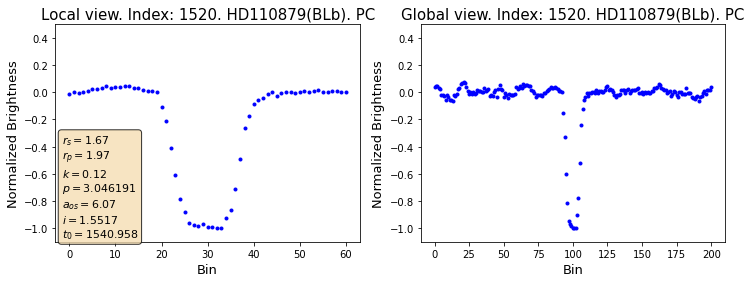

0.9989939 1521
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.96934439>, 'k': 0.1211827048099275, 'p': 3.0475795251678, 'a_os': 6.07317426889043, 'i': 1.5517313038438043, 't_0': 1540.957818786878}
(201,)
(1, 201)
(61,)


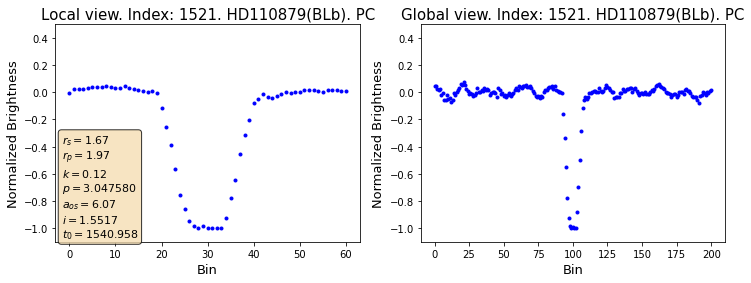

0.9981759 1522
{'target': 'HD110879', 'satellite': 'BLb', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.96934439>, 'k': 0.1211827048099275, 'p': 3.0489684140566893, 'a_os': 6.07317426889043, 'i': 1.5517313038438043, 't_0': 1540.957818786878}
(201,)
(1, 201)
(61,)


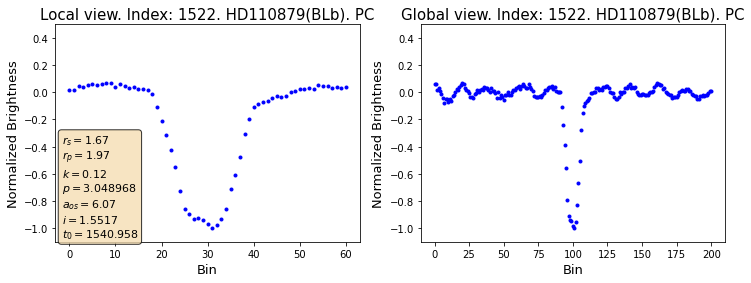

0.99055946 1539
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.76027187>, 'k': 0.108317523155992, 'p': 3.7656324770851737, 'a_os': 6.994839720422378, 'i': 1.5643968688044807, 't_0': 1470.278899787258}
(201,)
(1, 201)
(61,)


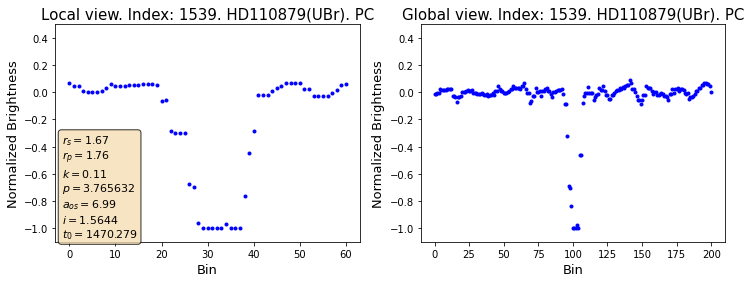

0.99810195 1540
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.76027187>, 'k': 0.108317523155992, 'p': 3.767021365974063, 'a_os': 6.994839720422378, 'i': 1.5643968688044807, 't_0': 1470.278899787258}
(201,)
(1, 201)
(61,)


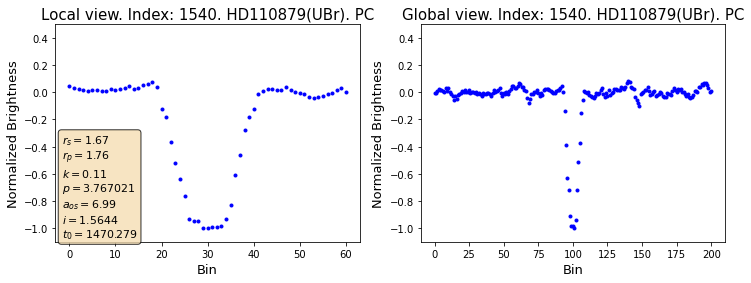

0.99793 1541
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.76027187>, 'k': 0.108317523155992, 'p': 3.768410254862952, 'a_os': 6.994839720422378, 'i': 1.5643968688044807, 't_0': 1470.278899787258}
(201,)
(1, 201)
(61,)


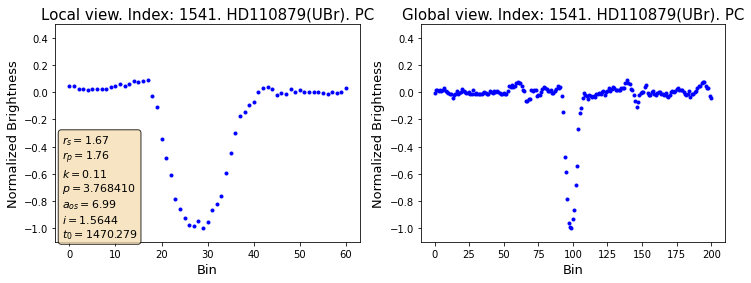

0.99732023 1558
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.84121387>, 'k': 0.1132982521476591, 'p': 3.260440217156843, 'a_os': 6.354575066291282, 'i': 1.5463511753779549, 't_0': 1526.621071786884}
(201,)
(1, 201)
(61,)


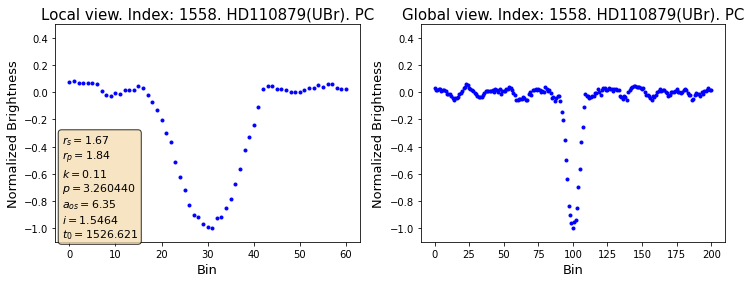

0.99810636 1559
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.84121387>, 'k': 0.1132982521476591, 'p': 3.2618291060457323, 'a_os': 6.354575066291282, 'i': 1.5463511753779549, 't_0': 1526.621071786884}
(201,)
(1, 201)
(61,)


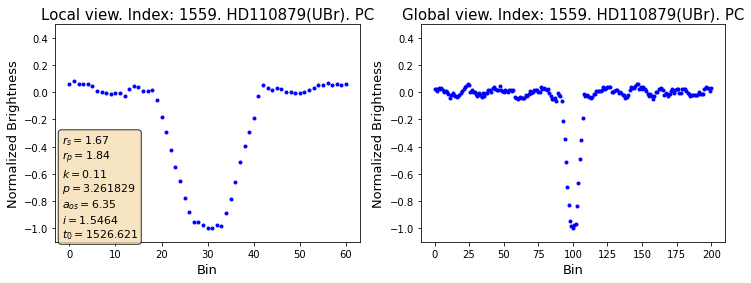

0.9978292 1560
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.84121387>, 'k': 0.1132982521476591, 'p': 3.2632179949346214, 'a_os': 6.354575066291282, 'i': 1.5463511753779549, 't_0': 1526.621071786884}
(201,)
(1, 201)
(61,)


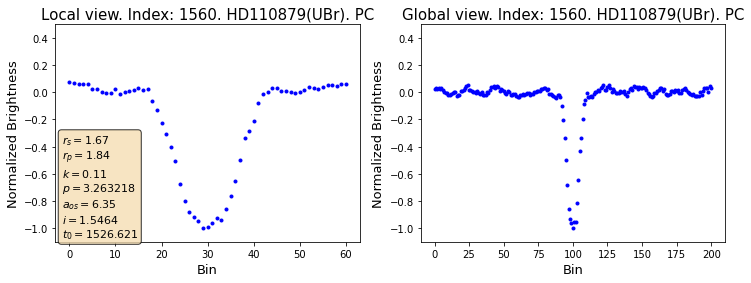

0.9984186 1577
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.8933688>, 'k': 0.1165075818925854, 'p': 3.2582762600880266, 'a_os': 6.351764261252639, 'i': 1.562106528139947, 't_0': 1561.1342157868517}
(201,)
(1, 201)
(61,)


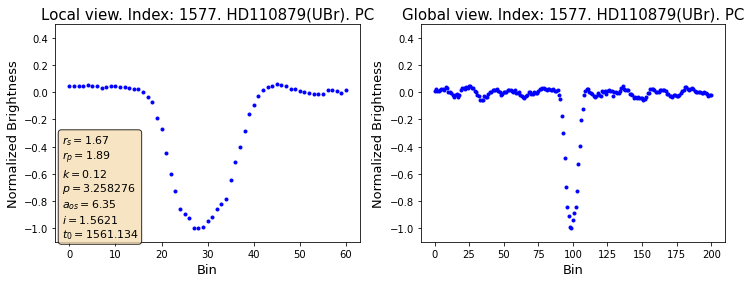

0.9983901 1578
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.8933688>, 'k': 0.1165075818925854, 'p': 3.259665148976916, 'a_os': 6.351764261252639, 'i': 1.562106528139947, 't_0': 1561.1342157868517}
(201,)
(1, 201)
(61,)


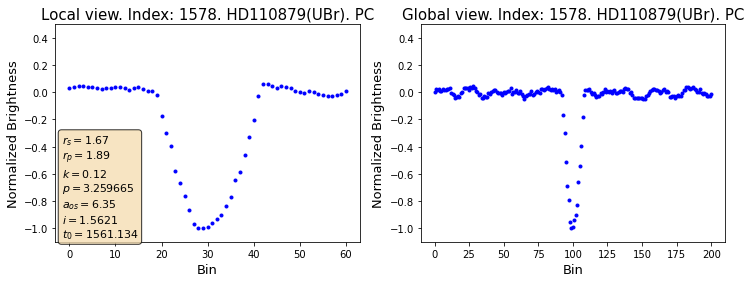

0.9978309 1579
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.8933688>, 'k': 0.1165075818925854, 'p': 3.261054037865805, 'a_os': 6.351764261252639, 'i': 1.562106528139947, 't_0': 1561.1342157868517}
(201,)
(1, 201)
(61,)


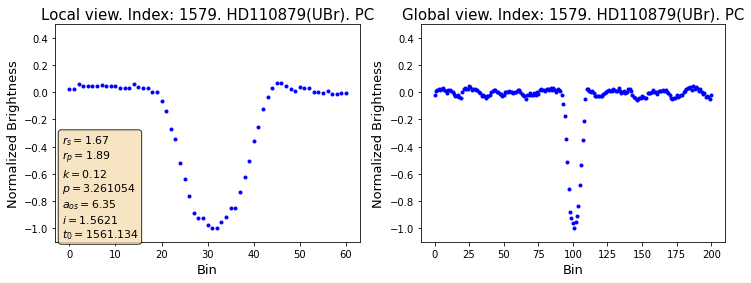

0.9973172 1596
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52169371>, 'k': 0.0936367257068782, 'p': 3.989694303128145, 'a_os': 7.269528310903527, 'i': 1.5523461465266988, 't_0': 1557.163958787251}
(201,)
(1, 201)
(61,)


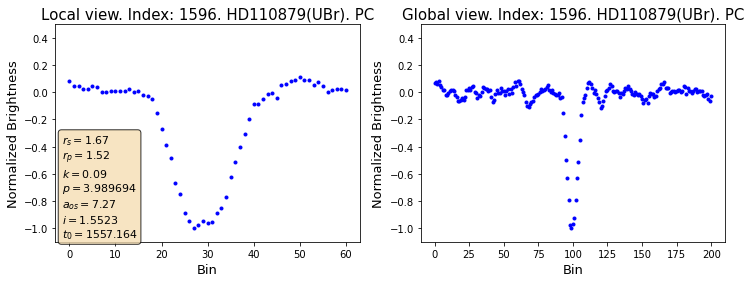

0.9971905 1597
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52169371>, 'k': 0.0936367257068782, 'p': 3.991083192017034, 'a_os': 7.269528310903527, 'i': 1.5523461465266988, 't_0': 1557.163958787251}
(201,)
(1, 201)
(61,)


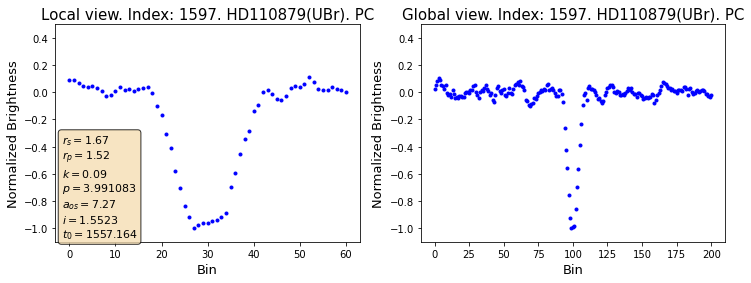

0.9966824 1598
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.52169371>, 'k': 0.0936367257068782, 'p': 3.992472080905923, 'a_os': 7.269528310903527, 'i': 1.5523461465266988, 't_0': 1557.163958787251}
(201,)
(1, 201)
(61,)


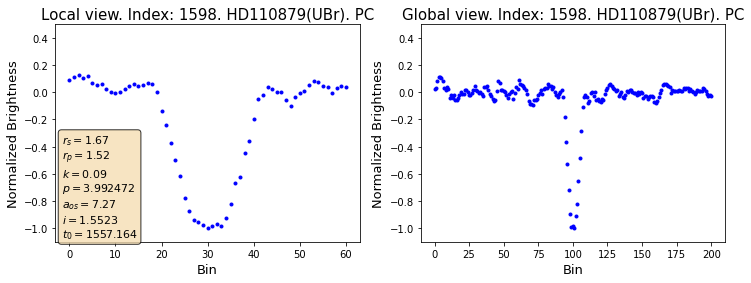

0.9945427 1615
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.65575712>, 'k': 0.1018862562021407, 'p': 2.7645746119481207, 'a_os': 5.693028288921177, 'i': 1.537053711332103, 't_0': 1462.8860717870143}
(201,)
(1, 201)
(61,)


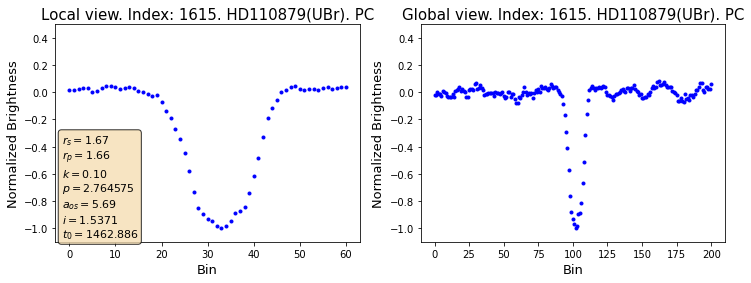

0.99859655 1616
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.65575712>, 'k': 0.1018862562021407, 'p': 2.76596350083701, 'a_os': 5.693028288921177, 'i': 1.537053711332103, 't_0': 1462.8860717870143}
(201,)
(1, 201)
(61,)


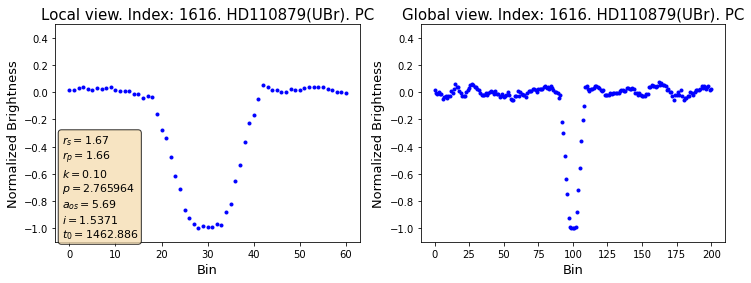

0.99746126 1617
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.65575712>, 'k': 0.1018862562021407, 'p': 2.767352389725899, 'a_os': 5.693028288921177, 'i': 1.537053711332103, 't_0': 1462.8860717870143}
(201,)
(1, 201)
(61,)


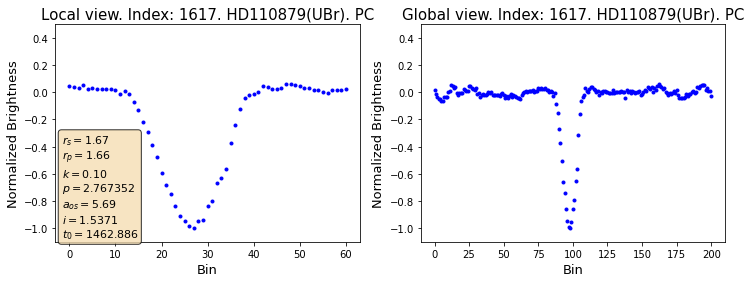

0.8924998 1634
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.10744504>, 'k': 0.0681461230850685, 'p': 1.5721034364897568, 'a_os': 3.908608131728703, 'i': 1.5576914695179302, 't_0': 1523.0649357869138}
(201,)
(1, 201)
(61,)


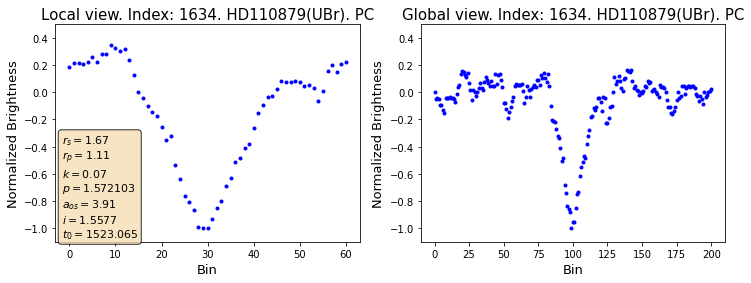

0.9941232 1635
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.10744504>, 'k': 0.0681461230850685, 'p': 1.5734923253786457, 'a_os': 3.908608131728703, 'i': 1.5576914695179302, 't_0': 1523.0649357869138}
(201,)
(1, 201)
(61,)


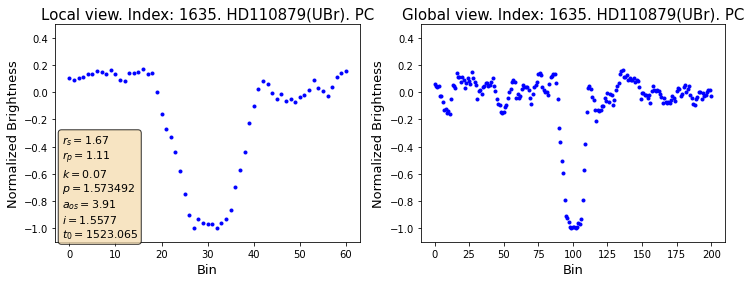

0.9189674 1636
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 1.10744504>, 'k': 0.0681461230850685, 'p': 1.5748812142675346, 'a_os': 3.908608131728703, 'i': 1.5576914695179302, 't_0': 1523.0649357869138}
(201,)
(1, 201)
(61,)


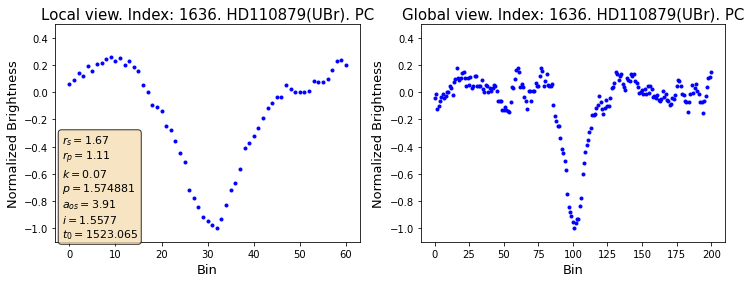

0.50916225 1653
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 0.55291294>, 'k': 0.034023244433061, 'p': 3.028985531600614, 'a_os': 6.050295311642167, 'i': 1.5620803015405949, 't_0': 1585.2041767870855}
(201,)
(1, 201)
(61,)


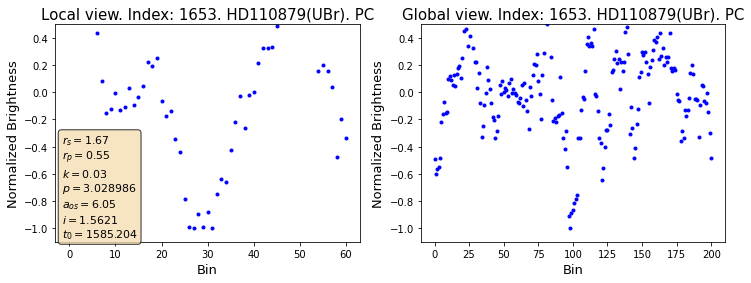

0.55623645 1691
{'target': 'HD110879', 'satellite': 'UBr', 'label': 'PC', 'r_s': 1.67, 'r_p': <Quantity 0.64828756>, 'k': 0.0398920778180108, 'p': 3.5903048928254755, 'a_os': 6.776080868590968, 'i': 1.5631318254892137, 't_0': 1536.5190557868068}
(201,)
(1, 201)
(61,)


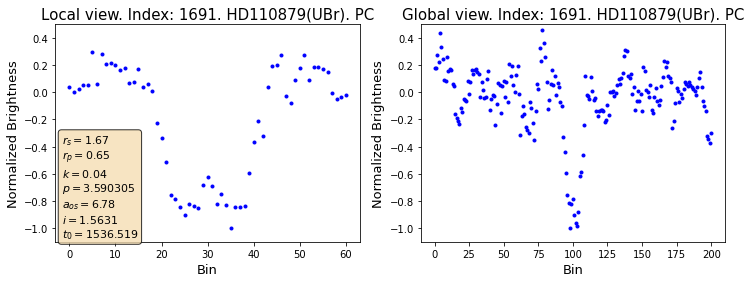

0.99859667 1710
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.08865658>, 'k': 0.1179318450185425, 'p': 3.325824656304058, 'a_os': 6.045597409696335, 'i': 1.5675268407251817, 't_0': 1488.3159851573937}
(201,)
(1, 201)
(61,)


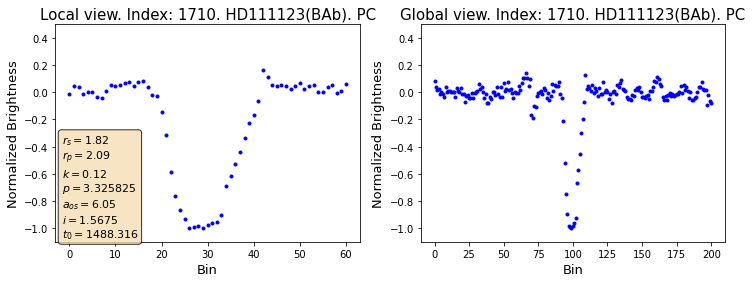

0.9984942 1711
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.08865658>, 'k': 0.1179318450185425, 'p': 3.327213545192947, 'a_os': 6.045597409696335, 'i': 1.5675268407251817, 't_0': 1488.3159851573937}
(201,)
(1, 201)
(61,)


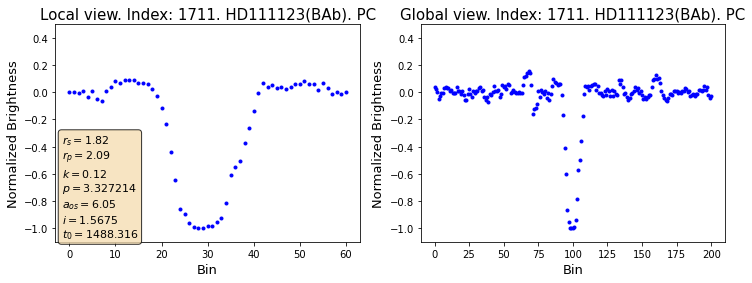

0.9983157 1712
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.08865658>, 'k': 0.1179318450185425, 'p': 3.3286024340818363, 'a_os': 6.045597409696335, 'i': 1.5675268407251817, 't_0': 1488.3159851573937}
(201,)
(1, 201)
(61,)


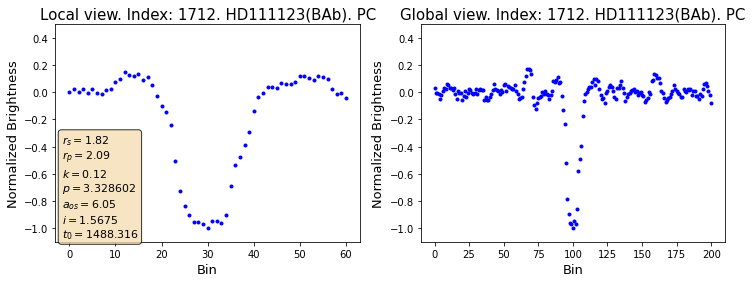

0.9574042 1729
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.09018496>, 'k': 0.1180181421930811, 'p': 1.6461823764857673, 'a_os': 3.783974887590482, 'i': 1.5576929975681135, 't_0': 1504.074419157353}
(201,)
(1, 201)
(61,)


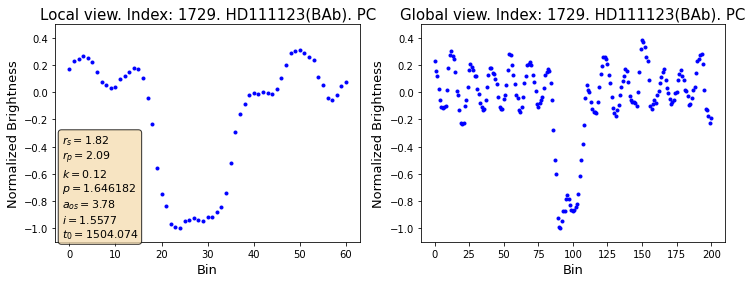

0.9981737 1730
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.09018496>, 'k': 0.1180181421930811, 'p': 1.647571265374656, 'a_os': 3.783974887590482, 'i': 1.5576929975681135, 't_0': 1504.074419157353}
(201,)
(1, 201)
(61,)


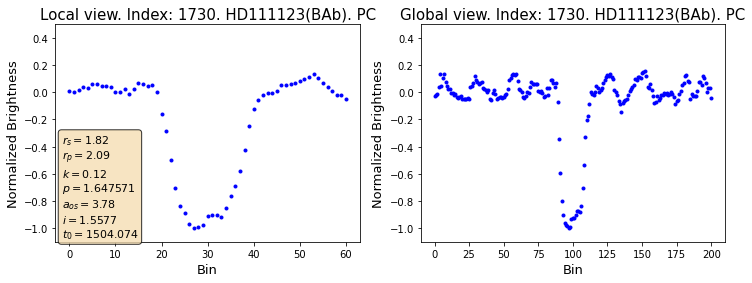

0.99642116 1731
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.09018496>, 'k': 0.1180181421930811, 'p': 1.648960154263545, 'a_os': 3.783974887590482, 'i': 1.5576929975681135, 't_0': 1504.074419157353}
(201,)
(1, 201)
(61,)


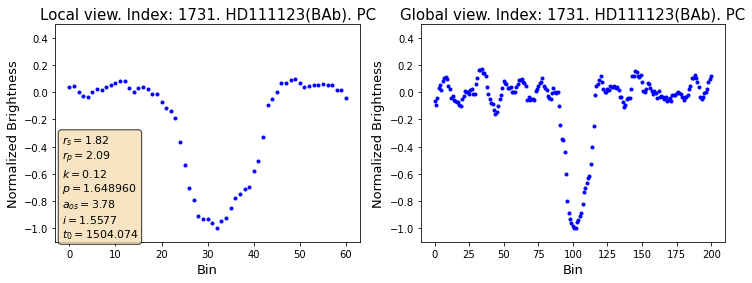

0.6035824 1750
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.26913338>, 'k': 0.0716590954105907, 'p': 3.269538590429726, 'a_os': 5.973837443581418, 'i': 1.5481592773564925, 't_0': 1449.4051207870093}
(201,)
(1, 201)
(61,)


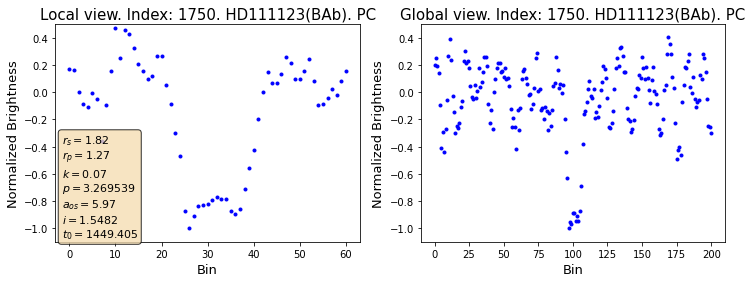

0.99167854 1767
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.06919577>, 'k': 0.1168330293630004, 'p': 4.369645145219146, 'a_os': 7.25172898217768, 'i': 1.5605500248229696, 't_0': 1533.7047858935705}
(201,)
(1, 201)
(61,)


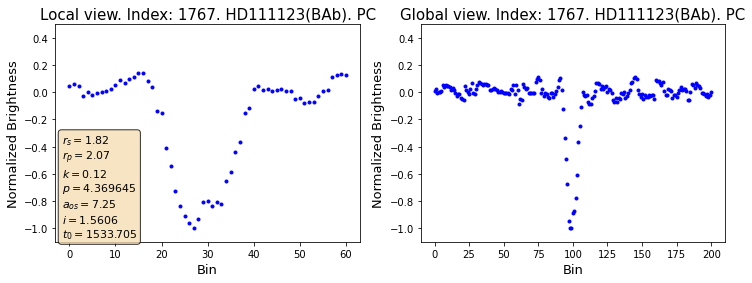

0.96661097 1768
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.06919577>, 'k': 0.1168330293630004, 'p': 4.371034034108035, 'a_os': 7.25172898217768, 'i': 1.5605500248229696, 't_0': 1533.7047858935705}
(201,)
(1, 201)
(61,)


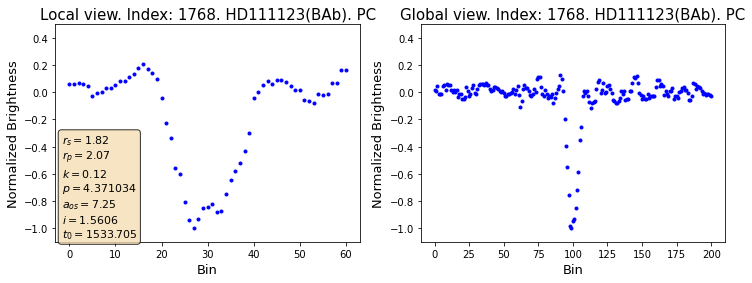

0.9645214 1769
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 2.06919577>, 'k': 0.1168330293630004, 'p': 4.3724229229969245, 'a_os': 7.25172898217768, 'i': 1.5605500248229696, 't_0': 1533.7047858935705}
(201,)
(1, 201)
(61,)


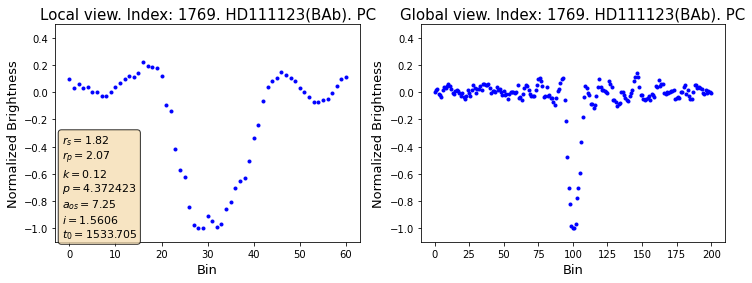

0.99228597 1786
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.41931601>, 'k': 0.0801388594690074, 'p': 3.8605474478722073, 'a_os': 6.677114849567784, 'i': 1.549341169911396, 't_0': 1492.4303391573549}
(201,)
(1, 201)
(61,)


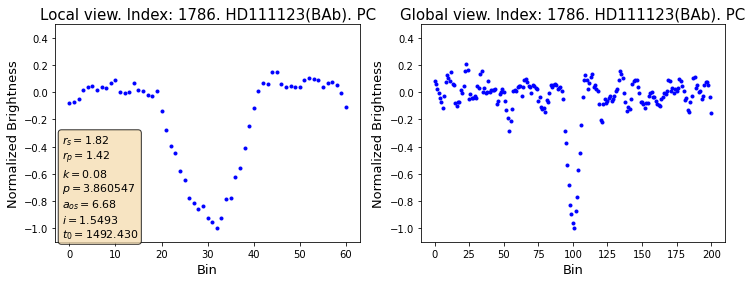

0.9929524 1787
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.41931601>, 'k': 0.0801388594690074, 'p': 3.861936336761096, 'a_os': 6.677114849567784, 'i': 1.549341169911396, 't_0': 1492.4303391573549}
(201,)
(1, 201)
(61,)


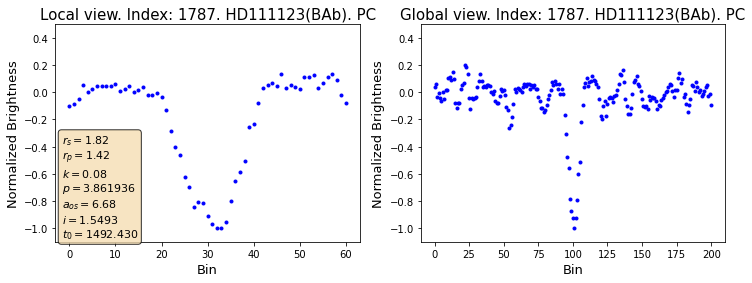

0.9927439 1788
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.41931601>, 'k': 0.0801388594690074, 'p': 3.8633252256499855, 'a_os': 6.677114849567784, 'i': 1.549341169911396, 't_0': 1492.4303391573549}
(201,)
(1, 201)
(61,)


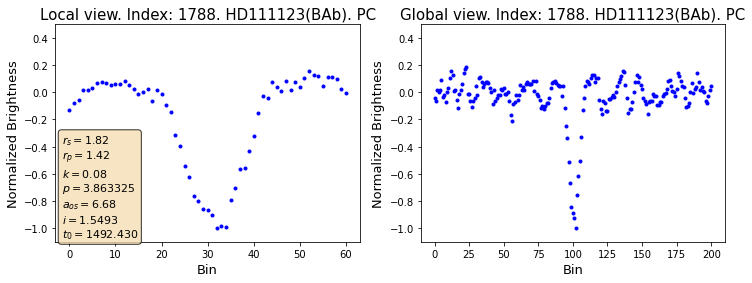

0.93548304 1805
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.43792572>, 'k': 0.0811896198195319, 'p': 2.637736549028121, 'a_os': 5.180346323100275, 'i': 1.5685427059249557, 't_0': 1457.5656467869726}
(201,)
(1, 201)
(61,)


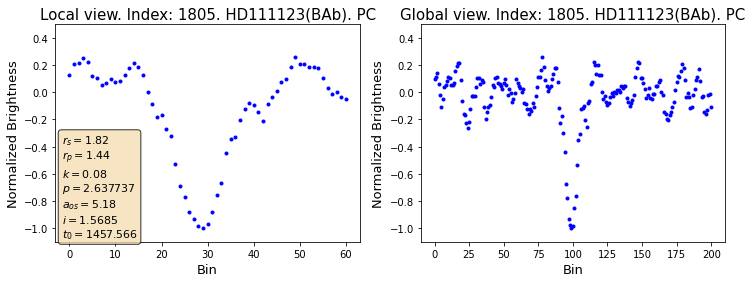

0.9963318 1806
{'target': 'HD111123', 'satellite': 'BAb', 'label': 'PC', 'r_s': 1.82, 'r_p': <Quantity 1.43792572>, 'k': 0.0811896198195319, 'p': 2.63912543791701, 'a_os': 5.180346323100275, 'i': 1.5685427059249557, 't_0': 1457.5656467869726}
(201,)
(1, 201)
(61,)



KeyboardInterrupt



In [42]:

for idx, predict in enumerate(predictions):
    if (predict>=0.5):
        print(predict, indexs[idx])
        plot_views(indexs[idx], folder, f'Local view. Index: {indexs[idx]}. ', f'Global view. Index: {indexs[idx]}. ')

0.00025264613 0
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.10104834>, 'k': 0.0325840137209538, 'p': 2.4856029644727147, 'a_os': 3.100416560196441, 'i': 1.541472658427789, 't_0': 1506.04064078702}
(201,)
(1, 201)
(61,)


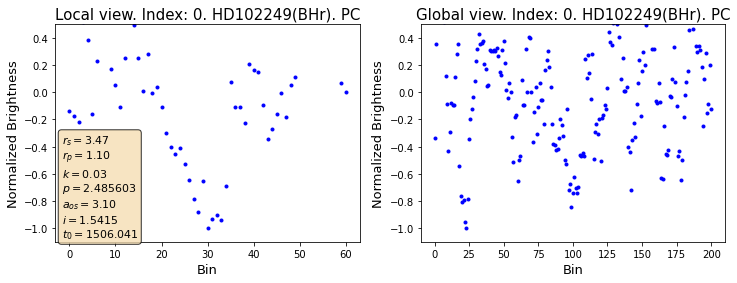

0.002568739 1
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.10104834>, 'k': 0.0325840137209538, 'p': 2.486991853361604, 'a_os': 3.100416560196441, 'i': 1.541472658427789, 't_0': 1506.04064078702}
(201,)
(1, 201)
(61,)


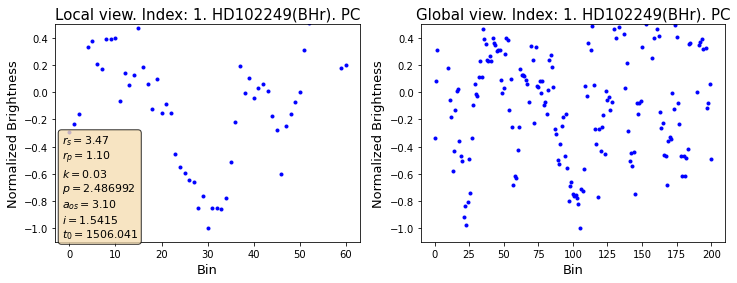

0.001212745 2
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.10104834>, 'k': 0.0325840137209538, 'p': 2.488380742250493, 'a_os': 3.100416560196441, 'i': 1.541472658427789, 't_0': 1506.04064078702}
(201,)
(1, 201)
(61,)


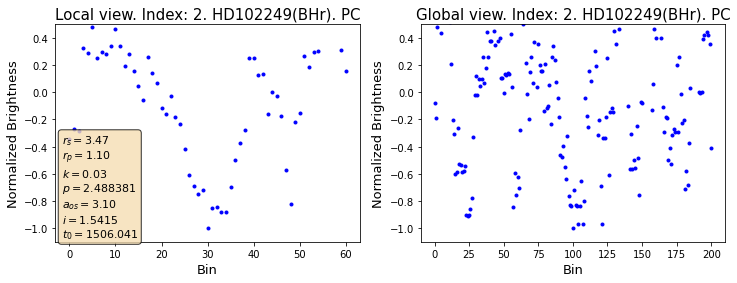

0.00093810394 19
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.31244551>, 'k': 0.0388400224831737, 'p': 4.751788136383413, 'a_os': 4.774850726119221, 'i': 1.5398572105217825, 't_0': 1457.8114587872135}
(201,)
(1, 201)
(61,)


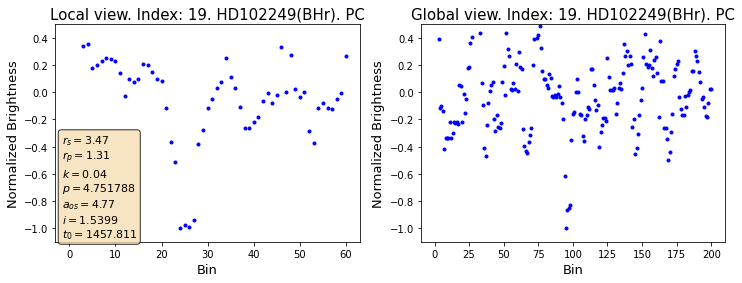

0.0007108668 20
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.31244551>, 'k': 0.0388400224831737, 'p': 4.753177025272303, 'a_os': 4.774850726119221, 'i': 1.5398572105217825, 't_0': 1457.8114587872135}
(201,)
(1, 201)
(61,)


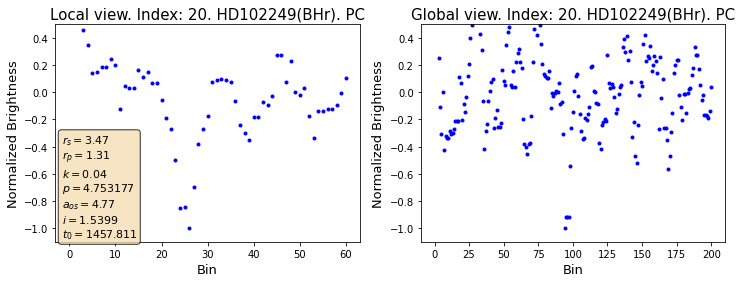

0.00057408505 21
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.31244551>, 'k': 0.0388400224831737, 'p': 4.754565914161192, 'a_os': 4.774850726119221, 'i': 1.5398572105217825, 't_0': 1457.8114587872135}
(201,)
(1, 201)
(61,)


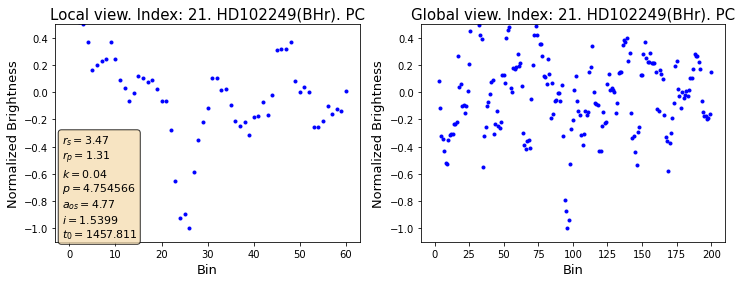

0.41467452 38
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.80082405>, 'k': 0.0532929147772961, 'p': 3.922281077201508, 'a_os': 4.201768487340627, 'i': 1.5378611386958485, 't_0': 1453.9701437868955}
(201,)
(1, 201)
(61,)


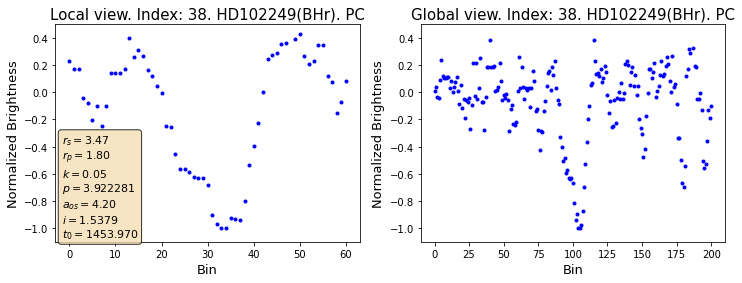

1.357455e-05 57
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.09522971>, 'k': 0.0324118193220791, 'p': 3.549181185554965, 'a_os': 3.930995364671784, 'i': 1.5401105276742897, 't_0': 1453.1592107869533}
(201,)
(1, 201)
(61,)


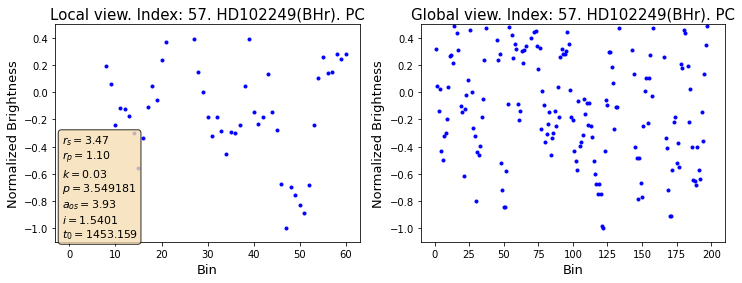

7.6812255e-05 58
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.09522971>, 'k': 0.0324118193220791, 'p': 3.550570074443854, 'a_os': 3.930995364671784, 'i': 1.5401105276742897, 't_0': 1453.1592107869533}
(201,)
(1, 201)
(61,)


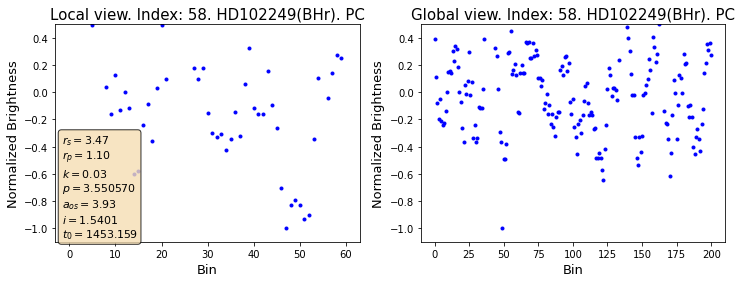

0.0001162061 59
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.09522971>, 'k': 0.0324118193220791, 'p': 3.5519589633327437, 'a_os': 3.930995364671784, 'i': 1.5401105276742897, 't_0': 1453.1592107869533}
(201,)
(1, 201)
(61,)


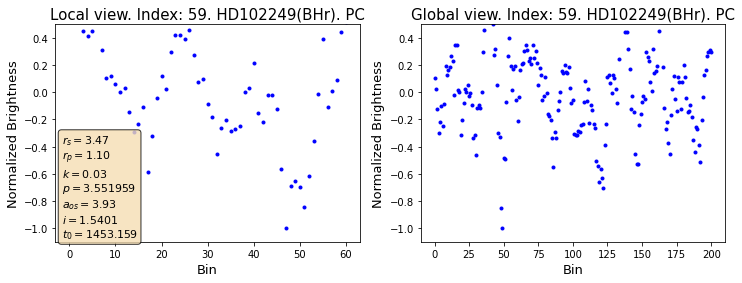

0.022934714 76
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.45250672>, 'k': 0.0429849417756435, 'p': 3.111963295922696, 'a_os': 3.601272408156452, 'i': 1.568431625891966, 't_0': 1498.0852827870135}
(201,)
(1, 201)
(61,)


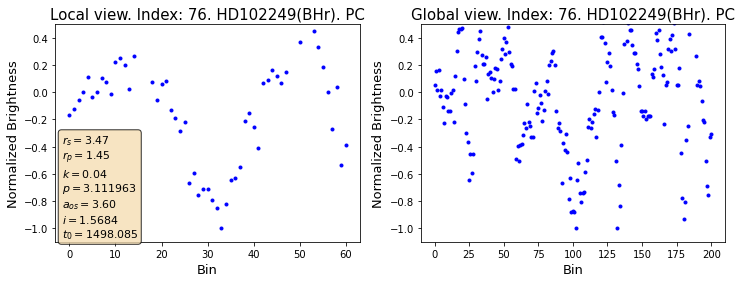

0.0035438924 77
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.45250672>, 'k': 0.0429849417756435, 'p': 3.113352184811585, 'a_os': 3.601272408156452, 'i': 1.568431625891966, 't_0': 1498.0852827870135}
(201,)
(1, 201)
(61,)


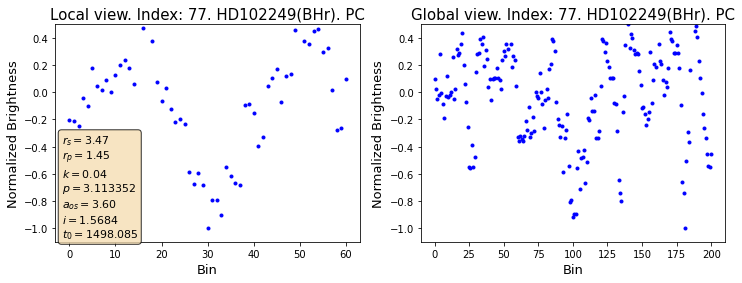

0.011636914 78
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.45250672>, 'k': 0.0429849417756435, 'p': 3.114741073700474, 'a_os': 3.601272408156452, 'i': 1.568431625891966, 't_0': 1498.0852827870135}
(201,)
(1, 201)
(61,)


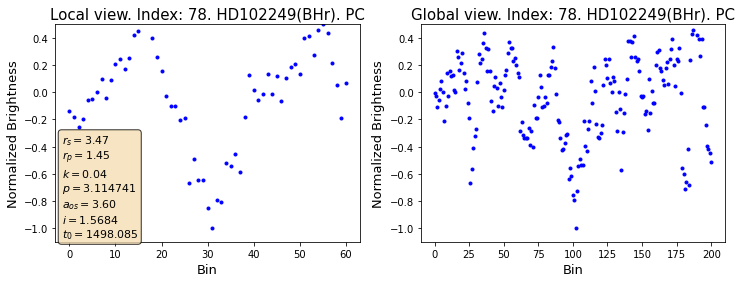

0.0028753455 114
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.51155597>, 'k': 0.0447324231705918, 'p': 4.652532736150641, 'a_os': 4.708145216580307, 'i': 1.5391260222669314, 't_0': 1500.307247787047}
(201,)
(1, 201)
(61,)


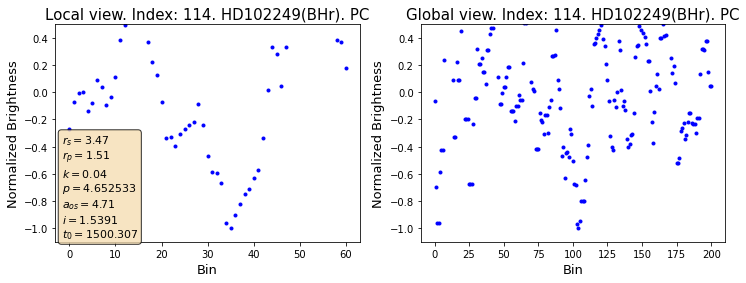

0.0044590565 115
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.51155597>, 'k': 0.0447324231705918, 'p': 4.65392162503953, 'a_os': 4.708145216580307, 'i': 1.5391260222669314, 't_0': 1500.307247787047}
(201,)
(1, 201)
(61,)


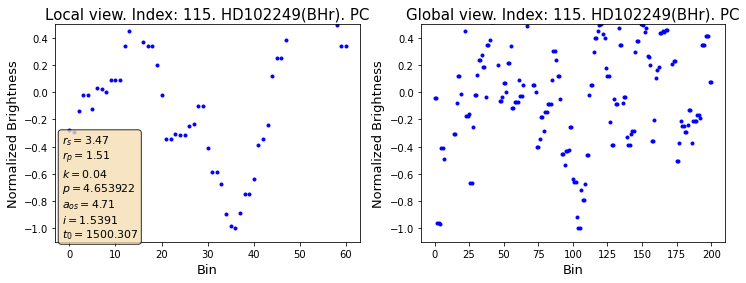

0.0021908612 116
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.51155597>, 'k': 0.0447324231705918, 'p': 4.655310513928419, 'a_os': 4.708145216580307, 'i': 1.5391260222669314, 't_0': 1500.307247787047}
(201,)
(1, 201)
(61,)


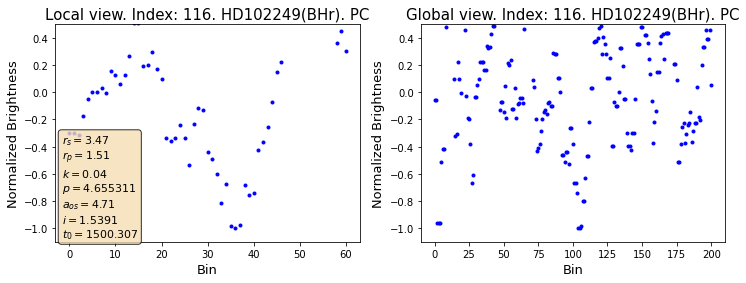

0.003034048 133
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.58489114>, 'k': 0.0469026768158552, 'p': 4.706028536101638, 'a_os': 4.744155838678558, 'i': 1.5701146703734945, 't_0': 1439.6013867871684}
(201,)
(1, 201)
(61,)


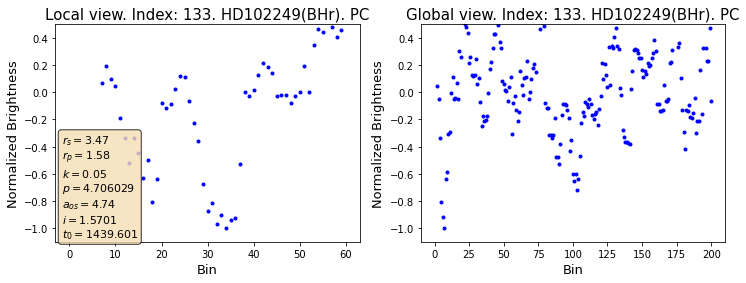

0.0038409668 134
{'target': 'HD102249', 'satellite': 'BHr', 'label': 'PC', 'r_s': 3.47246, 'r_p': <Quantity 1.58489114>, 'k': 0.0469026768158552, 'p': 4.707417424990527, 'a_os': 4.744155838678558, 'i': 1.5701146703734945, 't_0': 1439.6013867871684}
(201,)
(1, 201)
(61,)



KeyboardInterrupt



In [43]:

for idx, predict in enumerate(predictions):
    if (predict<0.5):
        print(predict, indexs[idx])
        plot_views(indexs[idx], folder, f'Local view. Index: {indexs[idx]}. ', f'Global view. Index: {indexs[idx]}. ')

In [ ]:
## hipotesis: sera que los radios mas altos tiran peores resultados?
# respuesta: es una posibilidad

In [ ]:
list_radius = []
for idx, predict in enumerate(predictions):
    if (predict>=0.5):
        info = get_example(indexs[idx], folder, only_info = True)
        list_radius.append(info['r_s'])
print(np.mean(list_radius))

plt.title(f"Histogram Stellar radius (Astronet prediction >= 0.5)", fontsize = 15)
sns.histplot(data=list_radius, kde=True)
plt.xlabel("Stellar radius (R_sun)")

plt.show()
list_radius = []
for idx, predict in enumerate(predictions):
    if (predict<0.5):
        info = get_example(indexs[idx], folder, only_info = True)
        list_radius.append(info['r_s'])
print(np.mean(list_radius))
plt.title(f"Histogram Stellar radius (Astronet prediction < 0.5)", fontsize = 15)
sns.histplot(data=list_radius, kde=True)
plt.xlabel("Stellar radius (R_sun)")